# FIT5196 Assessment 4
#### Student Name: Meng Li, Xuejin Huang
#### Student ID: 29040256, 28651073

Date: 2019/10/26

Version: 1.0

Environment: Python 3.6.5 and Jupyter notebook

Libraries used: 
* pandas (for dataframe, included in Anaconda Python 3.6) 
* re (for regular expression, included in Anaconda Python 3.6) 
* numpy (working with pandas, linear equation and other functions)
* shapefile (deal with the shape files)
* matplotlib (for plotting and some numerical mathematics extension)
* geopy (for calculate the distance)
* elementTree (parsing xml)
* bs4, requests (web scraping)

## 1.  Introduction

This assignment aims at data integration and data reshaping. For the integration part, the datasets include the house data in csv, Victoria suburb boundary data in shapefile, the train information in gtfs txt, the crime data in xlsx and the school data in xml and web scraping. The task is to integrate these datasets into the scheme described in specification. For the reshaping part, the task is to study the effect of different normalization/transformation methods on four attributes related to house price and provide which one(s) can be suitable for building linear model.

The output of this assignment should including the following:
1. The output csv that integrates all the datasets in the required schema.
2. Analysis and recommendations for the linear model on hosue price.

## 2. Import libraries

In this assignment, several libraries are imported and they are described in the following comments.

In [10]:
# read file and process
import numpy as np
import pandas as pd
import shapefile

# import matplotlib 
%matplotlib inline

from matplotlib import pyplot as plt
# import matplotlib.patches as patches
# from matplotlib.patches import Polygon
# from matplotlib.collections import PatchCollection

from matplotlib.path import Path

from geopy.distance import geodesic # calculate distance

import xml.etree.ElementTree as ET # parsing XML file

# Web scraping
# from urllib.request import urlopen
import requests
from bs4 import BeautifulSoup
import re

import statistics # calculate median

from sklearn import preprocessing # data reshaping
import math # doing math process, like find if value is nan

# Build linear model
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression

## 3. Data Integration

In this part, we will first process the datasets based on the specification and then integrate all the required data.

### 3.1 Read the house dataset and examine

In [31]:
house = pd.read_csv('Group006.csv')

In [32]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 720 entries, 0 to 719
Data columns (total 12 columns):
ID            720 non-null object
Address       720 non-null object
Rooms         720 non-null int64
Type          720 non-null object
Price         720 non-null float64
Date          720 non-null object
Bathroom      720 non-null float64
Car           720 non-null float64
Landsize      720 non-null float64
Age           720 non-null float64
Lattitude     720 non-null float64
Longtitude    720 non-null float64
dtypes: float64(7), int64(1), object(4)
memory usage: 67.6+ KB


In [33]:
house['ID'].describe()

count             720
unique            685
top       ID981943927
freq                3
Name: ID, dtype: object

We found that there is no missing value but there are duplicate data. So the first step is to drop the duplicate and reindex the dataframe.

In [34]:
house.drop_duplicates(inplace=True)
house.index = range(685)

In [35]:
house.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 685 entries, 0 to 684
Data columns (total 12 columns):
ID            685 non-null object
Address       685 non-null object
Rooms         685 non-null int64
Type          685 non-null object
Price         685 non-null float64
Date          685 non-null object
Bathroom      685 non-null float64
Car           685 non-null float64
Landsize      685 non-null float64
Age           685 non-null float64
Lattitude     685 non-null float64
Longtitude    685 non-null float64
dtypes: float64(7), int64(1), object(4)
memory usage: 64.3+ KB


In [17]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790


### 3.2 Suburb

In this section, we will add the `suburb` that houses locate at based on the shapefile data and house coordinates. First we read the shapefile data and then get the suburb records and the suburb polygons.  

In [20]:
sf = shapefile.Reader("./VIC_LOCALITY_POLYGON_shp")
recs = sf.records()
shapes = sf.shapes()

In [22]:
recs[0] # we found that the 7th is the subsub name

Record #0: ['6670', datetime.date(2011, 8, 31), None, 'VIC2615', datetime.date(2012, 4, 27), None, 'UNDERBOOL', '', '', 'G', None, '2']

In [23]:
print(shapes[0].shapeTypeName) # the suburb polygon

POLYGON


Then we will determine which suburb does a specific house belong to. `aRegion` is created by all the coordinate points that one suburb contain, then store the suburb in a list with the same order as the house dataset.

In [24]:
# Determine which suburb that a specific house belongs to.

suburbList = []

for index,row in house.iterrows():   
    point = [row['Longtitude'], row['Lattitude']]
    for i in range(0, len(shapes)):
        aRegion = Path(shapes[i].points)
        if aRegion.contains_point(point):
            suburb = recs[i][6]
            suburbList.append(suburb)
            break
            

In [25]:
len(suburbList)

685

In [36]:
# Integrate the suburb with the house

for i in range(0, len(suburbList)):
    house.loc[i, 'Suburb'] = suburbList[i]
    

In [37]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST


### 3.3 Train station part
in this section, we will calculate the `closest train station` which have a trip `directly to sc station` on `weekday morning(7 - 9:30)`, and calculate the `travel time` and the `distance to the closest train station`.
In this part, we choose to calculate the `3 attributr together` because they are all related to the `stoptime` file, we will process together and output the final result in the `end of this part`.

Write a function to read the files in gtfs, becvause only 1 and 2 present the trains, so we only read the files in 1 and 2

In [6]:
#function for reading the files
#in GTFS file, only folder 1 and folder 2 are data about trains
#so we just focus on the data in 1 and 2
def read(name):
    file = []
    for i in range(1,3):
        path = str(i)+'/' + name + '.txt'
        file.append(pd.read_csv(path))
    frame = pd.concat(file)
    frame.reset_index(drop=True,inplace=True)
    return frame

In [7]:
# this are list of the names of txt files
# for each name in the list, read the file to it.

name_list = ['calendar','calendar_dates', 'routes', 'shapes', 'stop_times', 'stops', 'trips']
calendar = read('calendar')
calendar_dates = read('calendar_dates')
routes = read('routes')
shapes = read('shapes')
stop_times = read('stop_times')
stops = read('stops')
trips = read('trips')

Check the files

In [111]:
calendar.head()

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,UR,0,0,0,1,0,0,0,20190509,20190509
1,T6,0,0,0,0,1,0,0,20190510,20190510
2,T2,0,0,0,0,0,1,0,20190511,20190511
3,UJ,0,0,0,0,0,0,1,20190512,20190512
4,UO,1,0,0,0,0,0,0,20190513,20190513


In [112]:
trips.head()

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,1-V08-G-mjp-1,T0,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0
1,1-V08-G-mjp-1,T0,1052.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
2,1-V08-G-mjp-1,T0,1053.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
3,1-V08-G-mjp-1,T0,1522.T0.1-V08-G-mjp-1.4.R,1-V08-G-mjp-1.4.R,Bairnsdale,1
4,1-V08-G-mjp-1,T0,1523.T0.1-V08-G-mjp-1.5.R,1-V08-G-mjp-1.5.R,Bairnsdale,1


In [1]:
stops.head()

NameError: name 'stops' is not defined

Find the travel time to CBD and the closest railway station and distance

First, we set a list to save all the trips that pass the sc station

In [129]:
# trip_sc is the list to store the trips which pass SC
trip_sc = stop_times[(stop_times['stop_id'] == 22180) | (stop_times['stop_id'] == 20043)]['trip_id']
len(trip_sc)

18697

In [130]:
# remove the duplicate rows if exist
trip_sc_without_duplicate = list(set(trip_sc))

Then we check the service id which means running on weekday

In [131]:
# check the trip which are in weekdays in these
# the 5 condition to check the working condition
cond1 = (calendar['monday'] == 1)
cond2 = (calendar['tuesday'] == 1)
cond3 = (calendar['wednesday'] == 1)
cond4 = (calendar['thursday'] == 1)
cond5 = (calendar['friday'] == 1)

# because it asked to find the travel time on weekdays
# find the service_id that meet all these 5 conditions
service_weekday = calendar[cond1 & cond2 & cond3 & cond4 & cond5].service_id
service_weekday = list(set(service_weekday))
service_weekday

['T0', 'T0_2', 'T0_3', 'T0_1']

After getting the service ID, then we are going for choosing the trips that can directly go to sc station and also running on weekdays

In [132]:
# find the trips which runs on weekdays
trip_weekday = trips[trips['service_id'].isin(service_weekday)].trip_id
trip_weekday = list(set(trip_weekday))
len(trip_weekday)

3764

Check the trips which get to sc and run on weekday

In [133]:
# get the trip which through SC and run on weekday
trip_sc_weekday = []
for trip in trip_sc_without_duplicate: 
    if trip in trip_weekday:       
        trip_sc_weekday.append(trip)
len(trip_sc_weekday)

2834

In [134]:
# copy the dataframe so that contains detailed information of only the trips in trip_sc_weekday
stop_time_sc = stop_times[stop_times['trip_id'].isin(trip_sc_weekday)]
len(stop_time_sc)

45546

This part is for split the hours and minutes so that we can check the time, because we only care about the trips between 7 and 9:30

In [135]:
# split the time, hour, minutes
# 2 lists to save the 2 value then add to the dataframe
hour = []
minute = []
for index, row in stop_time_sc.iterrows():
    time = row['departure_time'].split(':')
    hour.append(int(time[0]))
    minute.append(int(time[1]))
stop_time_sc['Hour'] = hour
stop_time_sc['Minute'] = minute
stop_time_sc

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,Hour,Minute
578,1051.T0.1-V08-G-mjp-1.1.H,06:08:00,06:08:00,20291,1,NaN,0,0,0.000000,6,8
579,1051.T0.1-V08-G-mjp-1.1.H,06:42:00,06:42:00,20346,2,NaN,0,0,52720.840026,6,42
580,1051.T0.1-V08-G-mjp-1.1.H,06:55:00,06:57:00,20341,3,NaN,0,0,68786.649688,6,57
581,1051.T0.1-V08-G-mjp-1.1.H,07:16:00,07:16:00,20339,4,NaN,0,0,94514.728171,7,16
582,1051.T0.1-V08-G-mjp-1.1.H,07:32:00,07:34:00,20351,5,NaN,0,0,116895.210301,7,34
583,1051.T0.1-V08-G-mjp-1.1.H,07:45:00,07:45:00,20330,6,NaN,0,0,130530.089787,7,45
584,1051.T0.1-V08-G-mjp-1.1.H,07:57:00,07:57:00,20328,7,NaN,0,0,145000.117101,7,57
585,1051.T0.1-V08-G-mjp-1.1.H,08:16:00,08:16:00,20357,10,NaN,0,0,175519.536474,8,16
586,1051.T0.1-V08-G-mjp-1.1.H,08:23:00,08:23:00,20308,11,NaN,0,0,183185.641193,8,23
587,1051.T0.1-V08-G-mjp-1.1.H,08:36:00,08:36:00,20313,14,NaN,0,0,200482.793316,8,36


This function is used to add an attribute which presents the arrival time to sc station of each trip, it is helpful to calculate the travel time.

In [116]:
# create a list "arrival_time_sc_list" to store the time which trip arrive sc station
# view each trip and find if it is the same trip, set the time of arriving sc to them.
# if change the trip, clear the alist and re append the arrive time.
# the arrival_time_sc_list will have all the arrive time to sc for each trip.
stop_time_sc.index = range(len(stop_time_sc))
arrival_time_sc_list = []
arrival_list = stop_time_sc[(stop_time_sc['stop_id'] == 22180) | (stop_time_sc['stop_id'] == 20043)]['arrival_time'].tolist()
j = 0
for i in range(0,len(stop_time_sc)):
    if i == 0:
        arrival_time_sc_list.append(arrival_list[j])
    else:
        if stop_time_sc.loc[i].trip_id == stop_time_sc.loc[i-1].trip_id:
            arrival_time_sc_list.append(arrival_list[j])
            print(str(i) + " times")
        else:
            j += 1
            arrival_time_sc_list.append(arrival_list[j])
            print(str(i) + " times")

1 times
2 times
3 times
4 times
5 times
6 times
7 times
8 times
9 times
10 times
11 times
12 times
13 times
14 times
15 times
16 times
17 times
18 times
19 times
20 times
21 times
22 times
23 times
24 times
25 times
26 times
27 times
28 times
29 times
30 times
31 times
32 times
33 times
34 times
35 times
36 times
37 times
38 times
39 times
40 times
41 times
42 times
43 times
44 times
45 times
46 times
47 times
48 times
49 times
50 times
51 times
52 times
53 times
54 times
55 times
56 times
57 times
58 times
59 times
60 times
61 times
62 times
63 times
64 times
65 times
66 times
67 times
68 times
69 times
70 times
71 times
72 times
73 times
74 times
75 times
76 times
77 times
78 times
79 times
80 times
81 times
82 times
83 times
84 times
85 times
86 times
87 times
88 times
89 times
90 times
91 times
92 times
93 times
94 times
95 times
96 times
97 times
98 times
99 times
100 times
101 times
102 times
103 times
104 times
105 times
106 times
107 times
108 times
109 times
110 times
111 time

862 times
863 times
864 times
865 times
866 times
867 times
868 times
869 times
870 times
871 times
872 times
873 times
874 times
875 times
876 times
877 times
878 times
879 times
880 times
881 times
882 times
883 times
884 times
885 times
886 times
887 times
888 times
889 times
890 times
891 times
892 times
893 times
894 times
895 times
896 times
897 times
898 times
899 times
900 times
901 times
902 times
903 times
904 times
905 times
906 times
907 times
908 times
909 times
910 times
911 times
912 times
913 times
914 times
915 times
916 times
917 times
918 times
919 times
920 times
921 times
922 times
923 times
924 times
925 times
926 times
927 times
928 times
929 times
930 times
931 times
932 times
933 times
934 times
935 times
936 times
937 times
938 times
939 times
940 times
941 times
942 times
943 times
944 times
945 times
946 times
947 times
948 times
949 times
950 times
951 times
952 times
953 times
954 times
955 times
956 times
957 times
958 times
959 times
960 times
961 times


1657 times
1658 times
1659 times
1660 times
1661 times
1662 times
1663 times
1664 times
1665 times
1666 times
1667 times
1668 times
1669 times
1670 times
1671 times
1672 times
1673 times
1674 times
1675 times
1676 times
1677 times
1678 times
1679 times
1680 times
1681 times
1682 times
1683 times
1684 times
1685 times
1686 times
1687 times
1688 times
1689 times
1690 times
1691 times
1692 times
1693 times
1694 times
1695 times
1696 times
1697 times
1698 times
1699 times
1700 times
1701 times
1702 times
1703 times
1704 times
1705 times
1706 times
1707 times
1708 times
1709 times
1710 times
1711 times
1712 times
1713 times
1714 times
1715 times
1716 times
1717 times
1718 times
1719 times
1720 times
1721 times
1722 times
1723 times
1724 times
1725 times
1726 times
1727 times
1728 times
1729 times
1730 times
1731 times
1732 times
1733 times
1734 times
1735 times
1736 times
1737 times
1738 times
1739 times
1740 times
1741 times
1742 times
1743 times
1744 times
1745 times
1746 times
1747 times

2429 times
2430 times
2431 times
2432 times
2433 times
2434 times
2435 times
2436 times
2437 times
2438 times
2439 times
2440 times
2441 times
2442 times
2443 times
2444 times
2445 times
2446 times
2447 times
2448 times
2449 times
2450 times
2451 times
2452 times
2453 times
2454 times
2455 times
2456 times
2457 times
2458 times
2459 times
2460 times
2461 times
2462 times
2463 times
2464 times
2465 times
2466 times
2467 times
2468 times
2469 times
2470 times
2471 times
2472 times
2473 times
2474 times
2475 times
2476 times
2477 times
2478 times
2479 times
2480 times
2481 times
2482 times
2483 times
2484 times
2485 times
2486 times
2487 times
2488 times
2489 times
2490 times
2491 times
2492 times
2493 times
2494 times
2495 times
2496 times
2497 times
2498 times
2499 times
2500 times
2501 times
2502 times
2503 times
2504 times
2505 times
2506 times
2507 times
2508 times
2509 times
2510 times
2511 times
2512 times
2513 times
2514 times
2515 times
2516 times
2517 times
2518 times
2519 times

3280 times
3281 times
3282 times
3283 times
3284 times
3285 times
3286 times
3287 times
3288 times
3289 times
3290 times
3291 times
3292 times
3293 times
3294 times
3295 times
3296 times
3297 times
3298 times
3299 times
3300 times
3301 times
3302 times
3303 times
3304 times
3305 times
3306 times
3307 times
3308 times
3309 times
3310 times
3311 times
3312 times
3313 times
3314 times
3315 times
3316 times
3317 times
3318 times
3319 times
3320 times
3321 times
3322 times
3323 times
3324 times
3325 times
3326 times
3327 times
3328 times
3329 times
3330 times
3331 times
3332 times
3333 times
3334 times
3335 times
3336 times
3337 times
3338 times
3339 times
3340 times
3341 times
3342 times
3343 times
3344 times
3345 times
3346 times
3347 times
3348 times
3349 times
3350 times
3351 times
3352 times
3353 times
3354 times
3355 times
3356 times
3357 times
3358 times
3359 times
3360 times
3361 times
3362 times
3363 times
3364 times
3365 times
3366 times
3367 times
3368 times
3369 times
3370 times

4071 times
4072 times
4073 times
4074 times
4075 times
4076 times
4077 times
4078 times
4079 times
4080 times
4081 times
4082 times
4083 times
4084 times
4085 times
4086 times
4087 times
4088 times
4089 times
4090 times
4091 times
4092 times
4093 times
4094 times
4095 times
4096 times
4097 times
4098 times
4099 times
4100 times
4101 times
4102 times
4103 times
4104 times
4105 times
4106 times
4107 times
4108 times
4109 times
4110 times
4111 times
4112 times
4113 times
4114 times
4115 times
4116 times
4117 times
4118 times
4119 times
4120 times
4121 times
4122 times
4123 times
4124 times
4125 times
4126 times
4127 times
4128 times
4129 times
4130 times
4131 times
4132 times
4133 times
4134 times
4135 times
4136 times
4137 times
4138 times
4139 times
4140 times
4141 times
4142 times
4143 times
4144 times
4145 times
4146 times
4147 times
4148 times
4149 times
4150 times
4151 times
4152 times
4153 times
4154 times
4155 times
4156 times
4157 times
4158 times
4159 times
4160 times
4161 times

4890 times
4891 times
4892 times
4893 times
4894 times
4895 times
4896 times
4897 times
4898 times
4899 times
4900 times
4901 times
4902 times
4903 times
4904 times
4905 times
4906 times
4907 times
4908 times
4909 times
4910 times
4911 times
4912 times
4913 times
4914 times
4915 times
4916 times
4917 times
4918 times
4919 times
4920 times
4921 times
4922 times
4923 times
4924 times
4925 times
4926 times
4927 times
4928 times
4929 times
4930 times
4931 times
4932 times
4933 times
4934 times
4935 times
4936 times
4937 times
4938 times
4939 times
4940 times
4941 times
4942 times
4943 times
4944 times
4945 times
4946 times
4947 times
4948 times
4949 times
4950 times
4951 times
4952 times
4953 times
4954 times
4955 times
4956 times
4957 times
4958 times
4959 times
4960 times
4961 times
4962 times
4963 times
4964 times
4965 times
4966 times
4967 times
4968 times
4969 times
4970 times
4971 times
4972 times
4973 times
4974 times
4975 times
4976 times
4977 times
4978 times
4979 times
4980 times

5724 times
5725 times
5726 times
5727 times
5728 times
5729 times
5730 times
5731 times
5732 times
5733 times
5734 times
5735 times
5736 times
5737 times
5738 times
5739 times
5740 times
5741 times
5742 times
5743 times
5744 times
5745 times
5746 times
5747 times
5748 times
5749 times
5750 times
5751 times
5752 times
5753 times
5754 times
5755 times
5756 times
5757 times
5758 times
5759 times
5760 times
5761 times
5762 times
5763 times
5764 times
5765 times
5766 times
5767 times
5768 times
5769 times
5770 times
5771 times
5772 times
5773 times
5774 times
5775 times
5776 times
5777 times
5778 times
5779 times
5780 times
5781 times
5782 times
5783 times
5784 times
5785 times
5786 times
5787 times
5788 times
5789 times
5790 times
5791 times
5792 times
5793 times
5794 times
5795 times
5796 times
5797 times
5798 times
5799 times
5800 times
5801 times
5802 times
5803 times
5804 times
5805 times
5806 times
5807 times
5808 times
5809 times
5810 times
5811 times
5812 times
5813 times
5814 times

6545 times
6546 times
6547 times
6548 times
6549 times
6550 times
6551 times
6552 times
6553 times
6554 times
6555 times
6556 times
6557 times
6558 times
6559 times
6560 times
6561 times
6562 times
6563 times
6564 times
6565 times
6566 times
6567 times
6568 times
6569 times
6570 times
6571 times
6572 times
6573 times
6574 times
6575 times
6576 times
6577 times
6578 times
6579 times
6580 times
6581 times
6582 times
6583 times
6584 times
6585 times
6586 times
6587 times
6588 times
6589 times
6590 times
6591 times
6592 times
6593 times
6594 times
6595 times
6596 times
6597 times
6598 times
6599 times
6600 times
6601 times
6602 times
6603 times
6604 times
6605 times
6606 times
6607 times
6608 times
6609 times
6610 times
6611 times
6612 times
6613 times
6614 times
6615 times
6616 times
6617 times
6618 times
6619 times
6620 times
6621 times
6622 times
6623 times
6624 times
6625 times
6626 times
6627 times
6628 times
6629 times
6630 times
6631 times
6632 times
6633 times
6634 times
6635 times

7341 times
7342 times
7343 times
7344 times
7345 times
7346 times
7347 times
7348 times
7349 times
7350 times
7351 times
7352 times
7353 times
7354 times
7355 times
7356 times
7357 times
7358 times
7359 times
7360 times
7361 times
7362 times
7363 times
7364 times
7365 times
7366 times
7367 times
7368 times
7369 times
7370 times
7371 times
7372 times
7373 times
7374 times
7375 times
7376 times
7377 times
7378 times
7379 times
7380 times
7381 times
7382 times
7383 times
7384 times
7385 times
7386 times
7387 times
7388 times
7389 times
7390 times
7391 times
7392 times
7393 times
7394 times
7395 times
7396 times
7397 times
7398 times
7399 times
7400 times
7401 times
7402 times
7403 times
7404 times
7405 times
7406 times
7407 times
7408 times
7409 times
7410 times
7411 times
7412 times
7413 times
7414 times
7415 times
7416 times
7417 times
7418 times
7419 times
7420 times
7421 times
7422 times
7423 times
7424 times
7425 times
7426 times
7427 times
7428 times
7429 times
7430 times
7431 times

8200 times
8201 times
8202 times
8203 times
8204 times
8205 times
8206 times
8207 times
8208 times
8209 times
8210 times
8211 times
8212 times
8213 times
8214 times
8215 times
8216 times
8217 times
8218 times
8219 times
8220 times
8221 times
8222 times
8223 times
8224 times
8225 times
8226 times
8227 times
8228 times
8229 times
8230 times
8231 times
8232 times
8233 times
8234 times
8235 times
8236 times
8237 times
8238 times
8239 times
8240 times
8241 times
8242 times
8243 times
8244 times
8245 times
8246 times
8247 times
8248 times
8249 times
8250 times
8251 times
8252 times
8253 times
8254 times
8255 times
8256 times
8257 times
8258 times
8259 times
8260 times
8261 times
8262 times
8263 times
8264 times
8265 times
8266 times
8267 times
8268 times
8269 times
8270 times
8271 times
8272 times
8273 times
8274 times
8275 times
8276 times
8277 times
8278 times
8279 times
8280 times
8281 times
8282 times
8283 times
8284 times
8285 times
8286 times
8287 times
8288 times
8289 times
8290 times

9003 times
9004 times
9005 times
9006 times
9007 times
9008 times
9009 times
9010 times
9011 times
9012 times
9013 times
9014 times
9015 times
9016 times
9017 times
9018 times
9019 times
9020 times
9021 times
9022 times
9023 times
9024 times
9025 times
9026 times
9027 times
9028 times
9029 times
9030 times
9031 times
9032 times
9033 times
9034 times
9035 times
9036 times
9037 times
9038 times
9039 times
9040 times
9041 times
9042 times
9043 times
9044 times
9045 times
9046 times
9047 times
9048 times
9049 times
9050 times
9051 times
9052 times
9053 times
9054 times
9055 times
9056 times
9057 times
9058 times
9059 times
9060 times
9061 times
9062 times
9063 times
9064 times
9065 times
9066 times
9067 times
9068 times
9069 times
9070 times
9071 times
9072 times
9073 times
9074 times
9075 times
9076 times
9077 times
9078 times
9079 times
9080 times
9081 times
9082 times
9083 times
9084 times
9085 times
9086 times
9087 times
9088 times
9089 times
9090 times
9091 times
9092 times
9093 times

9779 times
9780 times
9781 times
9782 times
9783 times
9784 times
9785 times
9786 times
9787 times
9788 times
9789 times
9790 times
9791 times
9792 times
9793 times
9794 times
9795 times
9796 times
9797 times
9798 times
9799 times
9800 times
9801 times
9802 times
9803 times
9804 times
9805 times
9806 times
9807 times
9808 times
9809 times
9810 times
9811 times
9812 times
9813 times
9814 times
9815 times
9816 times
9817 times
9818 times
9819 times
9820 times
9821 times
9822 times
9823 times
9824 times
9825 times
9826 times
9827 times
9828 times
9829 times
9830 times
9831 times
9832 times
9833 times
9834 times
9835 times
9836 times
9837 times
9838 times
9839 times
9840 times
9841 times
9842 times
9843 times
9844 times
9845 times
9846 times
9847 times
9848 times
9849 times
9850 times
9851 times
9852 times
9853 times
9854 times
9855 times
9856 times
9857 times
9858 times
9859 times
9860 times
9861 times
9862 times
9863 times
9864 times
9865 times
9866 times
9867 times
9868 times
9869 times

10581 times
10582 times
10583 times
10584 times
10585 times
10586 times
10587 times
10588 times
10589 times
10590 times
10591 times
10592 times
10593 times
10594 times
10595 times
10596 times
10597 times
10598 times
10599 times
10600 times
10601 times
10602 times
10603 times
10604 times
10605 times
10606 times
10607 times
10608 times
10609 times
10610 times
10611 times
10612 times
10613 times
10614 times
10615 times
10616 times
10617 times
10618 times
10619 times
10620 times
10621 times
10622 times
10623 times
10624 times
10625 times
10626 times
10627 times
10628 times
10629 times
10630 times
10631 times
10632 times
10633 times
10634 times
10635 times
10636 times
10637 times
10638 times
10639 times
10640 times
10641 times
10642 times
10643 times
10644 times
10645 times
10646 times
10647 times
10648 times
10649 times
10650 times
10651 times
10652 times
10653 times
10654 times
10655 times
10656 times
10657 times
10658 times
10659 times
10660 times
10661 times
10662 times
10663 times
1066

11414 times
11415 times
11416 times
11417 times
11418 times
11419 times
11420 times
11421 times
11422 times
11423 times
11424 times
11425 times
11426 times
11427 times
11428 times
11429 times
11430 times
11431 times
11432 times
11433 times
11434 times
11435 times
11436 times
11437 times
11438 times
11439 times
11440 times
11441 times
11442 times
11443 times
11444 times
11445 times
11446 times
11447 times
11448 times
11449 times
11450 times
11451 times
11452 times
11453 times
11454 times
11455 times
11456 times
11457 times
11458 times
11459 times
11460 times
11461 times
11462 times
11463 times
11464 times
11465 times
11466 times
11467 times
11468 times
11469 times
11470 times
11471 times
11472 times
11473 times
11474 times
11475 times
11476 times
11477 times
11478 times
11479 times
11480 times
11481 times
11482 times
11483 times
11484 times
11485 times
11486 times
11487 times
11488 times
11489 times
11490 times
11491 times
11492 times
11493 times
11494 times
11495 times
11496 times
1149

12281 times
12282 times
12283 times
12284 times
12285 times
12286 times
12287 times
12288 times
12289 times
12290 times
12291 times
12292 times
12293 times
12294 times
12295 times
12296 times
12297 times
12298 times
12299 times
12300 times
12301 times
12302 times
12303 times
12304 times
12305 times
12306 times
12307 times
12308 times
12309 times
12310 times
12311 times
12312 times
12313 times
12314 times
12315 times
12316 times
12317 times
12318 times
12319 times
12320 times
12321 times
12322 times
12323 times
12324 times
12325 times
12326 times
12327 times
12328 times
12329 times
12330 times
12331 times
12332 times
12333 times
12334 times
12335 times
12336 times
12337 times
12338 times
12339 times
12340 times
12341 times
12342 times
12343 times
12344 times
12345 times
12346 times
12347 times
12348 times
12349 times
12350 times
12351 times
12352 times
12353 times
12354 times
12355 times
12356 times
12357 times
12358 times
12359 times
12360 times
12361 times
12362 times
12363 times
1236

13166 times
13167 times
13168 times
13169 times
13170 times
13171 times
13172 times
13173 times
13174 times
13175 times
13176 times
13177 times
13178 times
13179 times
13180 times
13181 times
13182 times
13183 times
13184 times
13185 times
13186 times
13187 times
13188 times
13189 times
13190 times
13191 times
13192 times
13193 times
13194 times
13195 times
13196 times
13197 times
13198 times
13199 times
13200 times
13201 times
13202 times
13203 times
13204 times
13205 times
13206 times
13207 times
13208 times
13209 times
13210 times
13211 times
13212 times
13213 times
13214 times
13215 times
13216 times
13217 times
13218 times
13219 times
13220 times
13221 times
13222 times
13223 times
13224 times
13225 times
13226 times
13227 times
13228 times
13229 times
13230 times
13231 times
13232 times
13233 times
13234 times
13235 times
13236 times
13237 times
13238 times
13239 times
13240 times
13241 times
13242 times
13243 times
13244 times
13245 times
13246 times
13247 times
13248 times
1324

14011 times
14012 times
14013 times
14014 times
14015 times
14016 times
14017 times
14018 times
14019 times
14020 times
14021 times
14022 times
14023 times
14024 times
14025 times
14026 times
14027 times
14028 times
14029 times
14030 times
14031 times
14032 times
14033 times
14034 times
14035 times
14036 times
14037 times
14038 times
14039 times
14040 times
14041 times
14042 times
14043 times
14044 times
14045 times
14046 times
14047 times
14048 times
14049 times
14050 times
14051 times
14052 times
14053 times
14054 times
14055 times
14056 times
14057 times
14058 times
14059 times
14060 times
14061 times
14062 times
14063 times
14064 times
14065 times
14066 times
14067 times
14068 times
14069 times
14070 times
14071 times
14072 times
14073 times
14074 times
14075 times
14076 times
14077 times
14078 times
14079 times
14080 times
14081 times
14082 times
14083 times
14084 times
14085 times
14086 times
14087 times
14088 times
14089 times
14090 times
14091 times
14092 times
14093 times
1409

14960 times
14961 times
14962 times
14963 times
14964 times
14965 times
14966 times
14967 times
14968 times
14969 times
14970 times
14971 times
14972 times
14973 times
14974 times
14975 times
14976 times
14977 times
14978 times
14979 times
14980 times
14981 times
14982 times
14983 times
14984 times
14985 times
14986 times
14987 times
14988 times
14989 times
14990 times
14991 times
14992 times
14993 times
14994 times
14995 times
14996 times
14997 times
14998 times
14999 times
15000 times
15001 times
15002 times
15003 times
15004 times
15005 times
15006 times
15007 times
15008 times
15009 times
15010 times
15011 times
15012 times
15013 times
15014 times
15015 times
15016 times
15017 times
15018 times
15019 times
15020 times
15021 times
15022 times
15023 times
15024 times
15025 times
15026 times
15027 times
15028 times
15029 times
15030 times
15031 times
15032 times
15033 times
15034 times
15035 times
15036 times
15037 times
15038 times
15039 times
15040 times
15041 times
15042 times
1504

15803 times
15804 times
15805 times
15806 times
15807 times
15808 times
15809 times
15810 times
15811 times
15812 times
15813 times
15814 times
15815 times
15816 times
15817 times
15818 times
15819 times
15820 times
15821 times
15822 times
15823 times
15824 times
15825 times
15826 times
15827 times
15828 times
15829 times
15830 times
15831 times
15832 times
15833 times
15834 times
15835 times
15836 times
15837 times
15838 times
15839 times
15840 times
15841 times
15842 times
15843 times
15844 times
15845 times
15846 times
15847 times
15848 times
15849 times
15850 times
15851 times
15852 times
15853 times
15854 times
15855 times
15856 times
15857 times
15858 times
15859 times
15860 times
15861 times
15862 times
15863 times
15864 times
15865 times
15866 times
15867 times
15868 times
15869 times
15870 times
15871 times
15872 times
15873 times
15874 times
15875 times
15876 times
15877 times
15878 times
15879 times
15880 times
15881 times
15882 times
15883 times
15884 times
15885 times
1588

16681 times
16682 times
16683 times
16684 times
16685 times
16686 times
16687 times
16688 times
16689 times
16690 times
16691 times
16692 times
16693 times
16694 times
16695 times
16696 times
16697 times
16698 times
16699 times
16700 times
16701 times
16702 times
16703 times
16704 times
16705 times
16706 times
16707 times
16708 times
16709 times
16710 times
16711 times
16712 times
16713 times
16714 times
16715 times
16716 times
16717 times
16718 times
16719 times
16720 times
16721 times
16722 times
16723 times
16724 times
16725 times
16726 times
16727 times
16728 times
16729 times
16730 times
16731 times
16732 times
16733 times
16734 times
16735 times
16736 times
16737 times
16738 times
16739 times
16740 times
16741 times
16742 times
16743 times
16744 times
16745 times
16746 times
16747 times
16748 times
16749 times
16750 times
16751 times
16752 times
16753 times
16754 times
16755 times
16756 times
16757 times
16758 times
16759 times
16760 times
16761 times
16762 times
16763 times
1676

17554 times
17555 times
17556 times
17557 times
17558 times
17559 times
17560 times
17561 times
17562 times
17563 times
17564 times
17565 times
17566 times
17567 times
17568 times
17569 times
17570 times
17571 times
17572 times
17573 times
17574 times
17575 times
17576 times
17577 times
17578 times
17579 times
17580 times
17581 times
17582 times
17583 times
17584 times
17585 times
17586 times
17587 times
17588 times
17589 times
17590 times
17591 times
17592 times
17593 times
17594 times
17595 times
17596 times
17597 times
17598 times
17599 times
17600 times
17601 times
17602 times
17603 times
17604 times
17605 times
17606 times
17607 times
17608 times
17609 times
17610 times
17611 times
17612 times
17613 times
17614 times
17615 times
17616 times
17617 times
17618 times
17619 times
17620 times
17621 times
17622 times
17623 times
17624 times
17625 times
17626 times
17627 times
17628 times
17629 times
17630 times
17631 times
17632 times
17633 times
17634 times
17635 times
17636 times
1763

18435 times
18436 times
18437 times
18438 times
18439 times
18440 times
18441 times
18442 times
18443 times
18444 times
18445 times
18446 times
18447 times
18448 times
18449 times
18450 times
18451 times
18452 times
18453 times
18454 times
18455 times
18456 times
18457 times
18458 times
18459 times
18460 times
18461 times
18462 times
18463 times
18464 times
18465 times
18466 times
18467 times
18468 times
18469 times
18470 times
18471 times
18472 times
18473 times
18474 times
18475 times
18476 times
18477 times
18478 times
18479 times
18480 times
18481 times
18482 times
18483 times
18484 times
18485 times
18486 times
18487 times
18488 times
18489 times
18490 times
18491 times
18492 times
18493 times
18494 times
18495 times
18496 times
18497 times
18498 times
18499 times
18500 times
18501 times
18502 times
18503 times
18504 times
18505 times
18506 times
18507 times
18508 times
18509 times
18510 times
18511 times
18512 times
18513 times
18514 times
18515 times
18516 times
18517 times
1851

19300 times
19301 times
19302 times
19303 times
19304 times
19305 times
19306 times
19307 times
19308 times
19309 times
19310 times
19311 times
19312 times
19313 times
19314 times
19315 times
19316 times
19317 times
19318 times
19319 times
19320 times
19321 times
19322 times
19323 times
19324 times
19325 times
19326 times
19327 times
19328 times
19329 times
19330 times
19331 times
19332 times
19333 times
19334 times
19335 times
19336 times
19337 times
19338 times
19339 times
19340 times
19341 times
19342 times
19343 times
19344 times
19345 times
19346 times
19347 times
19348 times
19349 times
19350 times
19351 times
19352 times
19353 times
19354 times
19355 times
19356 times
19357 times
19358 times
19359 times
19360 times
19361 times
19362 times
19363 times
19364 times
19365 times
19366 times
19367 times
19368 times
19369 times
19370 times
19371 times
19372 times
19373 times
19374 times
19375 times
19376 times
19377 times
19378 times
19379 times
19380 times
19381 times
19382 times
1938

20158 times
20159 times
20160 times
20161 times
20162 times
20163 times
20164 times
20165 times
20166 times
20167 times
20168 times
20169 times
20170 times
20171 times
20172 times
20173 times
20174 times
20175 times
20176 times
20177 times
20178 times
20179 times
20180 times
20181 times
20182 times
20183 times
20184 times
20185 times
20186 times
20187 times
20188 times
20189 times
20190 times
20191 times
20192 times
20193 times
20194 times
20195 times
20196 times
20197 times
20198 times
20199 times
20200 times
20201 times
20202 times
20203 times
20204 times
20205 times
20206 times
20207 times
20208 times
20209 times
20210 times
20211 times
20212 times
20213 times
20214 times
20215 times
20216 times
20217 times
20218 times
20219 times
20220 times
20221 times
20222 times
20223 times
20224 times
20225 times
20226 times
20227 times
20228 times
20229 times
20230 times
20231 times
20232 times
20233 times
20234 times
20235 times
20236 times
20237 times
20238 times
20239 times
20240 times
2024

21046 times
21047 times
21048 times
21049 times
21050 times
21051 times
21052 times
21053 times
21054 times
21055 times
21056 times
21057 times
21058 times
21059 times
21060 times
21061 times
21062 times
21063 times
21064 times
21065 times
21066 times
21067 times
21068 times
21069 times
21070 times
21071 times
21072 times
21073 times
21074 times
21075 times
21076 times
21077 times
21078 times
21079 times
21080 times
21081 times
21082 times
21083 times
21084 times
21085 times
21086 times
21087 times
21088 times
21089 times
21090 times
21091 times
21092 times
21093 times
21094 times
21095 times
21096 times
21097 times
21098 times
21099 times
21100 times
21101 times
21102 times
21103 times
21104 times
21105 times
21106 times
21107 times
21108 times
21109 times
21110 times
21111 times
21112 times
21113 times
21114 times
21115 times
21116 times
21117 times
21118 times
21119 times
21120 times
21121 times
21122 times
21123 times
21124 times
21125 times
21126 times
21127 times
21128 times
2112

21905 times
21906 times
21907 times
21908 times
21909 times
21910 times
21911 times
21912 times
21913 times
21914 times
21915 times
21916 times
21917 times
21918 times
21919 times
21920 times
21921 times
21922 times
21923 times
21924 times
21925 times
21926 times
21927 times
21928 times
21929 times
21930 times
21931 times
21932 times
21933 times
21934 times
21935 times
21936 times
21937 times
21938 times
21939 times
21940 times
21941 times
21942 times
21943 times
21944 times
21945 times
21946 times
21947 times
21948 times
21949 times
21950 times
21951 times
21952 times
21953 times
21954 times
21955 times
21956 times
21957 times
21958 times
21959 times
21960 times
21961 times
21962 times
21963 times
21964 times
21965 times
21966 times
21967 times
21968 times
21969 times
21970 times
21971 times
21972 times
21973 times
21974 times
21975 times
21976 times
21977 times
21978 times
21979 times
21980 times
21981 times
21982 times
21983 times
21984 times
21985 times
21986 times
21987 times
2198

22746 times
22747 times
22748 times
22749 times
22750 times
22751 times
22752 times
22753 times
22754 times
22755 times
22756 times
22757 times
22758 times
22759 times
22760 times
22761 times
22762 times
22763 times
22764 times
22765 times
22766 times
22767 times
22768 times
22769 times
22770 times
22771 times
22772 times
22773 times
22774 times
22775 times
22776 times
22777 times
22778 times
22779 times
22780 times
22781 times
22782 times
22783 times
22784 times
22785 times
22786 times
22787 times
22788 times
22789 times
22790 times
22791 times
22792 times
22793 times
22794 times
22795 times
22796 times
22797 times
22798 times
22799 times
22800 times
22801 times
22802 times
22803 times
22804 times
22805 times
22806 times
22807 times
22808 times
22809 times
22810 times
22811 times
22812 times
22813 times
22814 times
22815 times
22816 times
22817 times
22818 times
22819 times
22820 times
22821 times
22822 times
22823 times
22824 times
22825 times
22826 times
22827 times
22828 times
2282

23568 times
23569 times
23570 times
23571 times
23572 times
23573 times
23574 times
23575 times
23576 times
23577 times
23578 times
23579 times
23580 times
23581 times
23582 times
23583 times
23584 times
23585 times
23586 times
23587 times
23588 times
23589 times
23590 times
23591 times
23592 times
23593 times
23594 times
23595 times
23596 times
23597 times
23598 times
23599 times
23600 times
23601 times
23602 times
23603 times
23604 times
23605 times
23606 times
23607 times
23608 times
23609 times
23610 times
23611 times
23612 times
23613 times
23614 times
23615 times
23616 times
23617 times
23618 times
23619 times
23620 times
23621 times
23622 times
23623 times
23624 times
23625 times
23626 times
23627 times
23628 times
23629 times
23630 times
23631 times
23632 times
23633 times
23634 times
23635 times
23636 times
23637 times
23638 times
23639 times
23640 times
23641 times
23642 times
23643 times
23644 times
23645 times
23646 times
23647 times
23648 times
23649 times
23650 times
2365

24405 times
24406 times
24407 times
24408 times
24409 times
24410 times
24411 times
24412 times
24413 times
24414 times
24415 times
24416 times
24417 times
24418 times
24419 times
24420 times
24421 times
24422 times
24423 times
24424 times
24425 times
24426 times
24427 times
24428 times
24429 times
24430 times
24431 times
24432 times
24433 times
24434 times
24435 times
24436 times
24437 times
24438 times
24439 times
24440 times
24441 times
24442 times
24443 times
24444 times
24445 times
24446 times
24447 times
24448 times
24449 times
24450 times
24451 times
24452 times
24453 times
24454 times
24455 times
24456 times
24457 times
24458 times
24459 times
24460 times
24461 times
24462 times
24463 times
24464 times
24465 times
24466 times
24467 times
24468 times
24469 times
24470 times
24471 times
24472 times
24473 times
24474 times
24475 times
24476 times
24477 times
24478 times
24479 times
24480 times
24481 times
24482 times
24483 times
24484 times
24485 times
24486 times
24487 times
2448

25210 times
25211 times
25212 times
25213 times
25214 times
25215 times
25216 times
25217 times
25218 times
25219 times
25220 times
25221 times
25222 times
25223 times
25224 times
25225 times
25226 times
25227 times
25228 times
25229 times
25230 times
25231 times
25232 times
25233 times
25234 times
25235 times
25236 times
25237 times
25238 times
25239 times
25240 times
25241 times
25242 times
25243 times
25244 times
25245 times
25246 times
25247 times
25248 times
25249 times
25250 times
25251 times
25252 times
25253 times
25254 times
25255 times
25256 times
25257 times
25258 times
25259 times
25260 times
25261 times
25262 times
25263 times
25264 times
25265 times
25266 times
25267 times
25268 times
25269 times
25270 times
25271 times
25272 times
25273 times
25274 times
25275 times
25276 times
25277 times
25278 times
25279 times
25280 times
25281 times
25282 times
25283 times
25284 times
25285 times
25286 times
25287 times
25288 times
25289 times
25290 times
25291 times
25292 times
2529

26049 times
26050 times
26051 times
26052 times
26053 times
26054 times
26055 times
26056 times
26057 times
26058 times
26059 times
26060 times
26061 times
26062 times
26063 times
26064 times
26065 times
26066 times
26067 times
26068 times
26069 times
26070 times
26071 times
26072 times
26073 times
26074 times
26075 times
26076 times
26077 times
26078 times
26079 times
26080 times
26081 times
26082 times
26083 times
26084 times
26085 times
26086 times
26087 times
26088 times
26089 times
26090 times
26091 times
26092 times
26093 times
26094 times
26095 times
26096 times
26097 times
26098 times
26099 times
26100 times
26101 times
26102 times
26103 times
26104 times
26105 times
26106 times
26107 times
26108 times
26109 times
26110 times
26111 times
26112 times
26113 times
26114 times
26115 times
26116 times
26117 times
26118 times
26119 times
26120 times
26121 times
26122 times
26123 times
26124 times
26125 times
26126 times
26127 times
26128 times
26129 times
26130 times
26131 times
2613

26852 times
26853 times
26854 times
26855 times
26856 times
26857 times
26858 times
26859 times
26860 times
26861 times
26862 times
26863 times
26864 times
26865 times
26866 times
26867 times
26868 times
26869 times
26870 times
26871 times
26872 times
26873 times
26874 times
26875 times
26876 times
26877 times
26878 times
26879 times
26880 times
26881 times
26882 times
26883 times
26884 times
26885 times
26886 times
26887 times
26888 times
26889 times
26890 times
26891 times
26892 times
26893 times
26894 times
26895 times
26896 times
26897 times
26898 times
26899 times
26900 times
26901 times
26902 times
26903 times
26904 times
26905 times
26906 times
26907 times
26908 times
26909 times
26910 times
26911 times
26912 times
26913 times
26914 times
26915 times
26916 times
26917 times
26918 times
26919 times
26920 times
26921 times
26922 times
26923 times
26924 times
26925 times
26926 times
26927 times
26928 times
26929 times
26930 times
26931 times
26932 times
26933 times
26934 times
2693

27707 times
27708 times
27709 times
27710 times
27711 times
27712 times
27713 times
27714 times
27715 times
27716 times
27717 times
27718 times
27719 times
27720 times
27721 times
27722 times
27723 times
27724 times
27725 times
27726 times
27727 times
27728 times
27729 times
27730 times
27731 times
27732 times
27733 times
27734 times
27735 times
27736 times
27737 times
27738 times
27739 times
27740 times
27741 times
27742 times
27743 times
27744 times
27745 times
27746 times
27747 times
27748 times
27749 times
27750 times
27751 times
27752 times
27753 times
27754 times
27755 times
27756 times
27757 times
27758 times
27759 times
27760 times
27761 times
27762 times
27763 times
27764 times
27765 times
27766 times
27767 times
27768 times
27769 times
27770 times
27771 times
27772 times
27773 times
27774 times
27775 times
27776 times
27777 times
27778 times
27779 times
27780 times
27781 times
27782 times
27783 times
27784 times
27785 times
27786 times
27787 times
27788 times
27789 times
2779

28475 times
28476 times
28477 times
28478 times
28479 times
28480 times
28481 times
28482 times
28483 times
28484 times
28485 times
28486 times
28487 times
28488 times
28489 times
28490 times
28491 times
28492 times
28493 times
28494 times
28495 times
28496 times
28497 times
28498 times
28499 times
28500 times
28501 times
28502 times
28503 times
28504 times
28505 times
28506 times
28507 times
28508 times
28509 times
28510 times
28511 times
28512 times
28513 times
28514 times
28515 times
28516 times
28517 times
28518 times
28519 times
28520 times
28521 times
28522 times
28523 times
28524 times
28525 times
28526 times
28527 times
28528 times
28529 times
28530 times
28531 times
28532 times
28533 times
28534 times
28535 times
28536 times
28537 times
28538 times
28539 times
28540 times
28541 times
28542 times
28543 times
28544 times
28545 times
28546 times
28547 times
28548 times
28549 times
28550 times
28551 times
28552 times
28553 times
28554 times
28555 times
28556 times
28557 times
2855

29279 times
29280 times
29281 times
29282 times
29283 times
29284 times
29285 times
29286 times
29287 times
29288 times
29289 times
29290 times
29291 times
29292 times
29293 times
29294 times
29295 times
29296 times
29297 times
29298 times
29299 times
29300 times
29301 times
29302 times
29303 times
29304 times
29305 times
29306 times
29307 times
29308 times
29309 times
29310 times
29311 times
29312 times
29313 times
29314 times
29315 times
29316 times
29317 times
29318 times
29319 times
29320 times
29321 times
29322 times
29323 times
29324 times
29325 times
29326 times
29327 times
29328 times
29329 times
29330 times
29331 times
29332 times
29333 times
29334 times
29335 times
29336 times
29337 times
29338 times
29339 times
29340 times
29341 times
29342 times
29343 times
29344 times
29345 times
29346 times
29347 times
29348 times
29349 times
29350 times
29351 times
29352 times
29353 times
29354 times
29355 times
29356 times
29357 times
29358 times
29359 times
29360 times
29361 times
2936

30102 times
30103 times
30104 times
30105 times
30106 times
30107 times
30108 times
30109 times
30110 times
30111 times
30112 times
30113 times
30114 times
30115 times
30116 times
30117 times
30118 times
30119 times
30120 times
30121 times
30122 times
30123 times
30124 times
30125 times
30126 times
30127 times
30128 times
30129 times
30130 times
30131 times
30132 times
30133 times
30134 times
30135 times
30136 times
30137 times
30138 times
30139 times
30140 times
30141 times
30142 times
30143 times
30144 times
30145 times
30146 times
30147 times
30148 times
30149 times
30150 times
30151 times
30152 times
30153 times
30154 times
30155 times
30156 times
30157 times
30158 times
30159 times
30160 times
30161 times
30162 times
30163 times
30164 times
30165 times
30166 times
30167 times
30168 times
30169 times
30170 times
30171 times
30172 times
30173 times
30174 times
30175 times
30176 times
30177 times
30178 times
30179 times
30180 times
30181 times
30182 times
30183 times
30184 times
3018

30906 times
30907 times
30908 times
30909 times
30910 times
30911 times
30912 times
30913 times
30914 times
30915 times
30916 times
30917 times
30918 times
30919 times
30920 times
30921 times
30922 times
30923 times
30924 times
30925 times
30926 times
30927 times
30928 times
30929 times
30930 times
30931 times
30932 times
30933 times
30934 times
30935 times
30936 times
30937 times
30938 times
30939 times
30940 times
30941 times
30942 times
30943 times
30944 times
30945 times
30946 times
30947 times
30948 times
30949 times
30950 times
30951 times
30952 times
30953 times
30954 times
30955 times
30956 times
30957 times
30958 times
30959 times
30960 times
30961 times
30962 times
30963 times
30964 times
30965 times
30966 times
30967 times
30968 times
30969 times
30970 times
30971 times
30972 times
30973 times
30974 times
30975 times
30976 times
30977 times
30978 times
30979 times
30980 times
30981 times
30982 times
30983 times
30984 times
30985 times
30986 times
30987 times
30988 times
3098

31731 times
31732 times
31733 times
31734 times
31735 times
31736 times
31737 times
31738 times
31739 times
31740 times
31741 times
31742 times
31743 times
31744 times
31745 times
31746 times
31747 times
31748 times
31749 times
31750 times
31751 times
31752 times
31753 times
31754 times
31755 times
31756 times
31757 times
31758 times
31759 times
31760 times
31761 times
31762 times
31763 times
31764 times
31765 times
31766 times
31767 times
31768 times
31769 times
31770 times
31771 times
31772 times
31773 times
31774 times
31775 times
31776 times
31777 times
31778 times
31779 times
31780 times
31781 times
31782 times
31783 times
31784 times
31785 times
31786 times
31787 times
31788 times
31789 times
31790 times
31791 times
31792 times
31793 times
31794 times
31795 times
31796 times
31797 times
31798 times
31799 times
31800 times
31801 times
31802 times
31803 times
31804 times
31805 times
31806 times
31807 times
31808 times
31809 times
31810 times
31811 times
31812 times
31813 times
3181

32539 times
32540 times
32541 times
32542 times
32543 times
32544 times
32545 times
32546 times
32547 times
32548 times
32549 times
32550 times
32551 times
32552 times
32553 times
32554 times
32555 times
32556 times
32557 times
32558 times
32559 times
32560 times
32561 times
32562 times
32563 times
32564 times
32565 times
32566 times
32567 times
32568 times
32569 times
32570 times
32571 times
32572 times
32573 times
32574 times
32575 times
32576 times
32577 times
32578 times
32579 times
32580 times
32581 times
32582 times
32583 times
32584 times
32585 times
32586 times
32587 times
32588 times
32589 times
32590 times
32591 times
32592 times
32593 times
32594 times
32595 times
32596 times
32597 times
32598 times
32599 times
32600 times
32601 times
32602 times
32603 times
32604 times
32605 times
32606 times
32607 times
32608 times
32609 times
32610 times
32611 times
32612 times
32613 times
32614 times
32615 times
32616 times
32617 times
32618 times
32619 times
32620 times
32621 times
3262

33344 times
33345 times
33346 times
33347 times
33348 times
33349 times
33350 times
33351 times
33352 times
33353 times
33354 times
33355 times
33356 times
33357 times
33358 times
33359 times
33360 times
33361 times
33362 times
33363 times
33364 times
33365 times
33366 times
33367 times
33368 times
33369 times
33370 times
33371 times
33372 times
33373 times
33374 times
33375 times
33376 times
33377 times
33378 times
33379 times
33380 times
33381 times
33382 times
33383 times
33384 times
33385 times
33386 times
33387 times
33388 times
33389 times
33390 times
33391 times
33392 times
33393 times
33394 times
33395 times
33396 times
33397 times
33398 times
33399 times
33400 times
33401 times
33402 times
33403 times
33404 times
33405 times
33406 times
33407 times
33408 times
33409 times
33410 times
33411 times
33412 times
33413 times
33414 times
33415 times
33416 times
33417 times
33418 times
33419 times
33420 times
33421 times
33422 times
33423 times
33424 times
33425 times
33426 times
3342

34188 times
34189 times
34190 times
34191 times
34192 times
34193 times
34194 times
34195 times
34196 times
34197 times
34198 times
34199 times
34200 times
34201 times
34202 times
34203 times
34204 times
34205 times
34206 times
34207 times
34208 times
34209 times
34210 times
34211 times
34212 times
34213 times
34214 times
34215 times
34216 times
34217 times
34218 times
34219 times
34220 times
34221 times
34222 times
34223 times
34224 times
34225 times
34226 times
34227 times
34228 times
34229 times
34230 times
34231 times
34232 times
34233 times
34234 times
34235 times
34236 times
34237 times
34238 times
34239 times
34240 times
34241 times
34242 times
34243 times
34244 times
34245 times
34246 times
34247 times
34248 times
34249 times
34250 times
34251 times
34252 times
34253 times
34254 times
34255 times
34256 times
34257 times
34258 times
34259 times
34260 times
34261 times
34262 times
34263 times
34264 times
34265 times
34266 times
34267 times
34268 times
34269 times
34270 times
3427

35051 times
35052 times
35053 times
35054 times
35055 times
35056 times
35057 times
35058 times
35059 times
35060 times
35061 times
35062 times
35063 times
35064 times
35065 times
35066 times
35067 times
35068 times
35069 times
35070 times
35071 times
35072 times
35073 times
35074 times
35075 times
35076 times
35077 times
35078 times
35079 times
35080 times
35081 times
35082 times
35083 times
35084 times
35085 times
35086 times
35087 times
35088 times
35089 times
35090 times
35091 times
35092 times
35093 times
35094 times
35095 times
35096 times
35097 times
35098 times
35099 times
35100 times
35101 times
35102 times
35103 times
35104 times
35105 times
35106 times
35107 times
35108 times
35109 times
35110 times
35111 times
35112 times
35113 times
35114 times
35115 times
35116 times
35117 times
35118 times
35119 times
35120 times
35121 times
35122 times
35123 times
35124 times
35125 times
35126 times
35127 times
35128 times
35129 times
35130 times
35131 times
35132 times
35133 times
3513

35881 times
35882 times
35883 times
35884 times
35885 times
35886 times
35887 times
35888 times
35889 times
35890 times
35891 times
35892 times
35893 times
35894 times
35895 times
35896 times
35897 times
35898 times
35899 times
35900 times
35901 times
35902 times
35903 times
35904 times
35905 times
35906 times
35907 times
35908 times
35909 times
35910 times
35911 times
35912 times
35913 times
35914 times
35915 times
35916 times
35917 times
35918 times
35919 times
35920 times
35921 times
35922 times
35923 times
35924 times
35925 times
35926 times
35927 times
35928 times
35929 times
35930 times
35931 times
35932 times
35933 times
35934 times
35935 times
35936 times
35937 times
35938 times
35939 times
35940 times
35941 times
35942 times
35943 times
35944 times
35945 times
35946 times
35947 times
35948 times
35949 times
35950 times
35951 times
35952 times
35953 times
35954 times
35955 times
35956 times
35957 times
35958 times
35959 times
35960 times
35961 times
35962 times
35963 times
3596

36761 times
36762 times
36763 times
36764 times
36765 times
36766 times
36767 times
36768 times
36769 times
36770 times
36771 times
36772 times
36773 times
36774 times
36775 times
36776 times
36777 times
36778 times
36779 times
36780 times
36781 times
36782 times
36783 times
36784 times
36785 times
36786 times
36787 times
36788 times
36789 times
36790 times
36791 times
36792 times
36793 times
36794 times
36795 times
36796 times
36797 times
36798 times
36799 times
36800 times
36801 times
36802 times
36803 times
36804 times
36805 times
36806 times
36807 times
36808 times
36809 times
36810 times
36811 times
36812 times
36813 times
36814 times
36815 times
36816 times
36817 times
36818 times
36819 times
36820 times
36821 times
36822 times
36823 times
36824 times
36825 times
36826 times
36827 times
36828 times
36829 times
36830 times
36831 times
36832 times
36833 times
36834 times
36835 times
36836 times
36837 times
36838 times
36839 times
36840 times
36841 times
36842 times
36843 times
3684

37640 times
37641 times
37642 times
37643 times
37644 times
37645 times
37646 times
37647 times
37648 times
37649 times
37650 times
37651 times
37652 times
37653 times
37654 times
37655 times
37656 times
37657 times
37658 times
37659 times
37660 times
37661 times
37662 times
37663 times
37664 times
37665 times
37666 times
37667 times
37668 times
37669 times
37670 times
37671 times
37672 times
37673 times
37674 times
37675 times
37676 times
37677 times
37678 times
37679 times
37680 times
37681 times
37682 times
37683 times
37684 times
37685 times
37686 times
37687 times
37688 times
37689 times
37690 times
37691 times
37692 times
37693 times
37694 times
37695 times
37696 times
37697 times
37698 times
37699 times
37700 times
37701 times
37702 times
37703 times
37704 times
37705 times
37706 times
37707 times
37708 times
37709 times
37710 times
37711 times
37712 times
37713 times
37714 times
37715 times
37716 times
37717 times
37718 times
37719 times
37720 times
37721 times
37722 times
3772

38474 times
38475 times
38476 times
38477 times
38478 times
38479 times
38480 times
38481 times
38482 times
38483 times
38484 times
38485 times
38486 times
38487 times
38488 times
38489 times
38490 times
38491 times
38492 times
38493 times
38494 times
38495 times
38496 times
38497 times
38498 times
38499 times
38500 times
38501 times
38502 times
38503 times
38504 times
38505 times
38506 times
38507 times
38508 times
38509 times
38510 times
38511 times
38512 times
38513 times
38514 times
38515 times
38516 times
38517 times
38518 times
38519 times
38520 times
38521 times
38522 times
38523 times
38524 times
38525 times
38526 times
38527 times
38528 times
38529 times
38530 times
38531 times
38532 times
38533 times
38534 times
38535 times
38536 times
38537 times
38538 times
38539 times
38540 times
38541 times
38542 times
38543 times
38544 times
38545 times
38546 times
38547 times
38548 times
38549 times
38550 times
38551 times
38552 times
38553 times
38554 times
38555 times
38556 times
3855

39341 times
39342 times
39343 times
39344 times
39345 times
39346 times
39347 times
39348 times
39349 times
39350 times
39351 times
39352 times
39353 times
39354 times
39355 times
39356 times
39357 times
39358 times
39359 times
39360 times
39361 times
39362 times
39363 times
39364 times
39365 times
39366 times
39367 times
39368 times
39369 times
39370 times
39371 times
39372 times
39373 times
39374 times
39375 times
39376 times
39377 times
39378 times
39379 times
39380 times
39381 times
39382 times
39383 times
39384 times
39385 times
39386 times
39387 times
39388 times
39389 times
39390 times
39391 times
39392 times
39393 times
39394 times
39395 times
39396 times
39397 times
39398 times
39399 times
39400 times
39401 times
39402 times
39403 times
39404 times
39405 times
39406 times
39407 times
39408 times
39409 times
39410 times
39411 times
39412 times
39413 times
39414 times
39415 times
39416 times
39417 times
39418 times
39419 times
39420 times
39421 times
39422 times
39423 times
3942

40187 times
40188 times
40189 times
40190 times
40191 times
40192 times
40193 times
40194 times
40195 times
40196 times
40197 times
40198 times
40199 times
40200 times
40201 times
40202 times
40203 times
40204 times
40205 times
40206 times
40207 times
40208 times
40209 times
40210 times
40211 times
40212 times
40213 times
40214 times
40215 times
40216 times
40217 times
40218 times
40219 times
40220 times
40221 times
40222 times
40223 times
40224 times
40225 times
40226 times
40227 times
40228 times
40229 times
40230 times
40231 times
40232 times
40233 times
40234 times
40235 times
40236 times
40237 times
40238 times
40239 times
40240 times
40241 times
40242 times
40243 times
40244 times
40245 times
40246 times
40247 times
40248 times
40249 times
40250 times
40251 times
40252 times
40253 times
40254 times
40255 times
40256 times
40257 times
40258 times
40259 times
40260 times
40261 times
40262 times
40263 times
40264 times
40265 times
40266 times
40267 times
40268 times
40269 times
4027

41064 times
41065 times
41066 times
41067 times
41068 times
41069 times
41070 times
41071 times
41072 times
41073 times
41074 times
41075 times
41076 times
41077 times
41078 times
41079 times
41080 times
41081 times
41082 times
41083 times
41084 times
41085 times
41086 times
41087 times
41088 times
41089 times
41090 times
41091 times
41092 times
41093 times
41094 times
41095 times
41096 times
41097 times
41098 times
41099 times
41100 times
41101 times
41102 times
41103 times
41104 times
41105 times
41106 times
41107 times
41108 times
41109 times
41110 times
41111 times
41112 times
41113 times
41114 times
41115 times
41116 times
41117 times
41118 times
41119 times
41120 times
41121 times
41122 times
41123 times
41124 times
41125 times
41126 times
41127 times
41128 times
41129 times
41130 times
41131 times
41132 times
41133 times
41134 times
41135 times
41136 times
41137 times
41138 times
41139 times
41140 times
41141 times
41142 times
41143 times
41144 times
41145 times
41146 times
4114

41937 times
41938 times
41939 times
41940 times
41941 times
41942 times
41943 times
41944 times
41945 times
41946 times
41947 times
41948 times
41949 times
41950 times
41951 times
41952 times
41953 times
41954 times
41955 times
41956 times
41957 times
41958 times
41959 times
41960 times
41961 times
41962 times
41963 times
41964 times
41965 times
41966 times
41967 times
41968 times
41969 times
41970 times
41971 times
41972 times
41973 times
41974 times
41975 times
41976 times
41977 times
41978 times
41979 times
41980 times
41981 times
41982 times
41983 times
41984 times
41985 times
41986 times
41987 times
41988 times
41989 times
41990 times
41991 times
41992 times
41993 times
41994 times
41995 times
41996 times
41997 times
41998 times
41999 times
42000 times
42001 times
42002 times
42003 times
42004 times
42005 times
42006 times
42007 times
42008 times
42009 times
42010 times
42011 times
42012 times
42013 times
42014 times
42015 times
42016 times
42017 times
42018 times
42019 times
4202

42770 times
42771 times
42772 times
42773 times
42774 times
42775 times
42776 times
42777 times
42778 times
42779 times
42780 times
42781 times
42782 times
42783 times
42784 times
42785 times
42786 times
42787 times
42788 times
42789 times
42790 times
42791 times
42792 times
42793 times
42794 times
42795 times
42796 times
42797 times
42798 times
42799 times
42800 times
42801 times
42802 times
42803 times
42804 times
42805 times
42806 times
42807 times
42808 times
42809 times
42810 times
42811 times
42812 times
42813 times
42814 times
42815 times
42816 times
42817 times
42818 times
42819 times
42820 times
42821 times
42822 times
42823 times
42824 times
42825 times
42826 times
42827 times
42828 times
42829 times
42830 times
42831 times
42832 times
42833 times
42834 times
42835 times
42836 times
42837 times
42838 times
42839 times
42840 times
42841 times
42842 times
42843 times
42844 times
42845 times
42846 times
42847 times
42848 times
42849 times
42850 times
42851 times
42852 times
4285

43600 times
43601 times
43602 times
43603 times
43604 times
43605 times
43606 times
43607 times
43608 times
43609 times
43610 times
43611 times
43612 times
43613 times
43614 times
43615 times
43616 times
43617 times
43618 times
43619 times
43620 times
43621 times
43622 times
43623 times
43624 times
43625 times
43626 times
43627 times
43628 times
43629 times
43630 times
43631 times
43632 times
43633 times
43634 times
43635 times
43636 times
43637 times
43638 times
43639 times
43640 times
43641 times
43642 times
43643 times
43644 times
43645 times
43646 times
43647 times
43648 times
43649 times
43650 times
43651 times
43652 times
43653 times
43654 times
43655 times
43656 times
43657 times
43658 times
43659 times
43660 times
43661 times
43662 times
43663 times
43664 times
43665 times
43666 times
43667 times
43668 times
43669 times
43670 times
43671 times
43672 times
43673 times
43674 times
43675 times
43676 times
43677 times
43678 times
43679 times
43680 times
43681 times
43682 times
4368

44467 times
44468 times
44469 times
44470 times
44471 times
44472 times
44473 times
44474 times
44475 times
44476 times
44477 times
44478 times
44479 times
44480 times
44481 times
44482 times
44483 times
44484 times
44485 times
44486 times
44487 times
44488 times
44489 times
44490 times
44491 times
44492 times
44493 times
44494 times
44495 times
44496 times
44497 times
44498 times
44499 times
44500 times
44501 times
44502 times
44503 times
44504 times
44505 times
44506 times
44507 times
44508 times
44509 times
44510 times
44511 times
44512 times
44513 times
44514 times
44515 times
44516 times
44517 times
44518 times
44519 times
44520 times
44521 times
44522 times
44523 times
44524 times
44525 times
44526 times
44527 times
44528 times
44529 times
44530 times
44531 times
44532 times
44533 times
44534 times
44535 times
44536 times
44537 times
44538 times
44539 times
44540 times
44541 times
44542 times
44543 times
44544 times
44545 times
44546 times
44547 times
44548 times
44549 times
4455

45363 times
45364 times
45365 times
45366 times
45367 times
45368 times
45369 times
45370 times
45371 times
45372 times
45373 times
45374 times
45375 times
45376 times
45377 times
45378 times
45379 times
45380 times
45381 times
45382 times
45383 times
45384 times
45385 times
45386 times
45387 times
45388 times
45389 times
45390 times
45391 times
45392 times
45393 times
45394 times
45395 times
45396 times
45397 times
45398 times
45399 times
45400 times
45401 times
45402 times
45403 times
45404 times
45405 times
45406 times
45407 times
45408 times
45409 times
45410 times
45411 times
45412 times
45413 times
45414 times
45415 times
45416 times
45417 times
45418 times
45419 times
45420 times
45421 times
45422 times
45423 times
45424 times
45425 times
45426 times
45427 times
45428 times
45429 times
45430 times
45431 times
45432 times
45433 times
45434 times
45435 times
45436 times
45437 times
45438 times
45439 times
45440 times
45441 times
45442 times
45443 times
45444 times
45445 times
4544

In [117]:
# setting a new value "arrival_sc" for each trip to check the time when arrive sc
stop_time_sc['arrival_sc'] = arrival_time_sc_list

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [122]:
# find all the records which departure time are between 7 to 9:30 am
stop_time_sc_morning = stop_time_sc[(stop_time_sc['Hour'] == 7) | (stop_time_sc['Hour'] == 8) | (stop_time_sc['Hour'] == 9)]

First change the data format to the datetime format so that we can calculate it directly.

In [123]:
# using pd.to_datetime to transfer the data format to datetime so that we can calulate time.
stop_time_sc_morning['departure_time'] = pd.to_datetime(stop_time_sc_morning['departure_time'])

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.


This part is used to choose the trips which departure time are between 7 to 9:30 am

In [124]:
# find all the records which departure time are between 7 to 9:30 am
stop_time_sc_morning = stop_time_sc_morning[(stop_time_sc_morning['departure_time'] >= '07:00:00') & (stop_time_sc_morning['departure_time'] <= "09:30:00") ]

In [125]:
# using pd.to_datetime to transfer the data format to datetime so that we can calulate time.
# calculate the time, using arriving time of sc mines departual time
# set a new column 'travel_min_to_CBD' to store the time data.
stop_time_sc_morning['departure_time'] = pd.to_datetime(stop_time_sc_morning['departure_time'])
stop_time_sc_morning['arrival_sc'] = pd.to_datetime(stop_time_sc_morning['arrival_sc'])

In [158]:
# check the data types
stop_time_sc_morning.dtypes

trip_id                        object
arrival_time                   object
departure_time         datetime64[ns]
stop_id                         int64
stop_sequence                   int64
stop_headsign                 float64
pickup_type                     int64
drop_off_type                   int64
shape_dist_traveled           float64
Hour                            int64
Minute                          int64
arrival_sc             datetime64[ns]
travel_min_to_CBD              object
dtype: object

In [139]:
# re-index to aviod some issues.
stop_time_sc_morning.index = range(len(stop_time_sc_morning))

Use the same arrival time to sc station and different depature time of each station to calculate the travel time from each station to sc station.

In [140]:
# write a function to calculate the traval time to sc
# if one trip have arrived sc, then the travel time of remaining stations will be setting NA
# using print to check how many it runs.
travel_time = []
for index,row in stop_time_sc_morning.iterrows():
    if row['arrival_sc'] >= row['departure_time']:
        print(index)
#         print((row['arrival_sc'] - row['departure_time']).total_seconds()/60)
        travel_time.append((row['arrival_sc'] - row['departure_time']).total_seconds()/60)
    else:
        travel_time.append('N/A')

0
1
2
3
4
5
6
7
8
9
18
19
20
21
22
23
24
25
26
27
36
37
38
39
40
41
42
43
44
45
54
55
56
57
58
59
60
61
62
63
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
132
134
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
207
209
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
282
284
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
357
359
387
400
413
414
427
433
445
456
460
461
462
463
464
465
466
467
468
46

3069
3070
3071
3072
3073
3074
3075
3076
3077
3078
3079
3080
3081
3082
3083
3084
3085
3086
3087
3088
3089
3090
3091
3092
3093
3094
3095
3096
3097
3098
3099
3100
3101
3102
3103
3104
3105
3106
3107
3108
3109
3110
3111
3112
3113
3114
3115
3116
3117
3118
3119
3120
3121
3122
3123
3124
3125
3126
3127
3128
3129
3130
3131
3132
3133
3134
3135
3136
3137
3138
3139
3140
3141
3142
3143
3163
3164
3165
3166
3190
3191
3192
3193
3218
3219
3220
3221
3240
3241
3242
3243
3254
3255
3256
3257
3262
3263
3264
3265
3266
3267
3268
3269
3270
3271
3272
3273
3275
3276
3277
3278
3279
3281
3282
3283
3284
3285
3286
3287
3288
3289
3290
3291
3293
3294
3295
3296
3297
3298
3299
3300
3301
3302
3303
3304
3305
3306
3307
3308
3310
3311
3312
3313
3314
3315
3316
3317
3318
3319
3320
3321
3322
3324
3325
3326
3327
3328
3329
3330
3331
3332
3333
3334
3335
3336
3337
3338
3339
3340
3341
3342
3344
3345
3346
3347
3348
3349
3350
3351
3352
3353
3354
3355
3356
3357
3358
3359
3360
3361
3362
3364
3365
3366
3367
3368
3369
3370
3371
3372
3373


6623
6651
6652
6680
6681
6709
6710
6738
6739
6767
6768
6796
6797
6822
6823
6844
6845
6863
6864
6873
6874
6886
6887
6899
6900
6912
6913
6919
6920
6930
6931
6941
6942
6952
6953
6958
6959
6982
6983
7046
7047
7048
7049
7073
7074
7075
7076
7085
7086
7087
7088
7090
7091
7092
7093
7105
7106
7107
7108
7120
7121
7122
7123
7135
7136
7137
7138
7145
7146
7147
7148
7159
7160
7161
7162
7163
7164
7165
7166
7183
7184
7185
7186
7203
7204
7205
7206
7211
7212
7213
7214
7219
7220
7221
7222
7223
7224
7225
7226
7227
7228
7229
7230
7231
7232
7233
7234
7236
7237
7238
7239
7240
7241
7242
7243
7244
7245
7246
7247
7248
7249
7250
7251
7252
7253
7254
7256
7257
7258
7259
7260
7261
7262
7263
7264
7265
7266
7267
7268
7269
7270
7271
7272
7273
7274
7276
7277
7278
7279
7280
7281
7282
7283
7284
7285
7286
7287
7288
7289
7290
7291
7292
7293
7294
7296
7297
7298
7299
7300
7301
7302
7303
7304
7305
7306
7307
7308
7309
7310
7311
7312
7313
7314
7316
7317
7318
7319
7321
7322
7323
7324
7325
7326
7327
7328
7329
7330
7331
7332
7333


In [141]:
# set the list value to the df attribute.
stop_time_sc_morning['travel_min_to_CBD'] = travel_time

In [142]:
# create a list to save all stops id which can directly go to sc station, but there are some NA value in it
aStation = stop_time_sc_morning['stop_id'].unique().tolist()
len(aStation)

303

Use a dictionary to save the average value of the travel time from each station to CBD.

In [150]:
# calculate travel time from each station, remove the nan values
time_dic = {}
for i in aStation:
    time = stop_time_sc_morning[stop_time_sc_morning['stop_id'] == i]['travel_min_to_CBD'].tolist()
    time_new = [ x for x in time if type(x) != str ]
    if not math.isnan(round(np.mean(time_new),1)):
        time_dic[i] = round(np.mean(time_new),1)
time_dic

{20339: 161.0,
 20351: 141.5,
 20330: 132.2,
 20328: 121.0,
 20357: 100.5,
 20308: 94.8,
 20313: 82.0,
 22252: 68.6,
 22250: 48.2,
 20043: 0.0,
 22238: 3.5,
 22248: 19.5,
 20320: 71.8,
 20361: 63.5,
 20325: 61.0,
 20315: 55.0,
 20337: 52.0,
 20303: 47.0,
 19998: 39.0,
 22240: 10.1,
 22244: 30.5,
 47642: 134.0,
 20296: 117.8,
 20317: 113.8,
 20301: 91.3,
 20326: 81.5,
 19982: 23.9,
 47648: 32.1,
 47647: 37.7,
 20323: 46.4,
 20321: 50.1,
 20305: 50.8,
 20335: 53.6,
 20334: 59.0,
 20314: 61.7,
 20344: 66.5,
 20327: 69.5,
 47641: 74.0,
 22241: 15.8,
 20020: 21.3,
 22253: 18.3,
 22239: 7.0,
 20348: 83.0,
 20298: 75.0,
 20319: 71.0,
 20355: 64.0,
 20316: 60.0,
 17204: 56.8,
 20307: 47.0,
 22254: 32.0,
 20342: 90.2,
 20029: 35.0,
 20318: 233.0,
 20336: 204.0,
 20306: 176.0,
 20309: 147.0,
 20333: 77.0,
 20352: 78.5,
 20299: 86.5,
 20324: 90.5,
 20362: 110.0,
 20350: 115.0,
 22247: 10.0,
 22249: 33.7,
 22251: 55.0,
 20359: 100.0,
 20297: 114.0,
 20304: 128.0,
 20358: 210.0,
 20310: 207.0,
 203

Copy a new dataframe to use for getting only the stops get to sc on weekday morning

In [152]:
# create the new stops dataframe with the stations which can directly get to sc on weekday morning
direct_stops_sc_morning = stops[stops['stop_id'].isin(time_dic.keys())].copy()

In [153]:
# re-index to avoid the issues that some index copy are not continuous
direct_stops_sc_morning.index = range(len(direct_stops_sc_morning))

Calculate the closest distance and add an atrribute to the dataframe.

In [155]:
# function to calculate the closest station and the distance
station_id_list = []
distance_to = []
for index,row in house.iterrows():
    closest_station = ''
    closest_distance = float('inf')
    house_location = (row['Lattitude'], row['Longtitude'])
    print("house: " + str(house_location))
    for i in range(0,len(direct_stops_sc_morning)):
        if time_dic[direct_stops_sc_morning.loc[i].stop_id] > 0:
            station_location = (direct_stops_sc_morning.loc[i].stop_lat, direct_stops_sc_morning.loc[i].stop_lon) 
            print(str(i) + " station: " + str(station_location))
            distance = geodesic(house_location, station_location).m
            if distance < closest_distance:
                closest_distance = distance
                closest_station_id = direct_stops_sc_morning.loc[i].stop_id
        else:
            continue
    station_id_list.append(closest_station_id)
    distance_to.append(closest_distance)

house: (-37.7362, 145.0232)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.15

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536

203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 statio

145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 

124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37

95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.993078820

57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.

32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 14

284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.81202, 145.04217)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: 

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-

249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.74

242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.799

236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.783217

230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.738674

226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701

217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 statio

197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station:

192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-3

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.8

169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-3

161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (

158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-3

153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.779171

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.911017340

127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (

120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37

116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.

107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.8

98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926

93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.02722019

83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723,

76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145

71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.

68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144

65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 1

63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 

66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.3

60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 1

58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.

54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.

40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.1

31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 1

25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.67

8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.24837989

282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8644, 145.0302)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: 

271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8344, 144.9916)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.7723036088

267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.79741

256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.80

229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.72840

229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.72840

220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127

213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-

203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 statio

194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-3

190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.761

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.70067

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (

156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688

155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.77496

141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.894881294619

138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.924682552

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (

117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.9782

110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.

102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.82832

100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.86

88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668

84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669,

72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.9

70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.72

52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.9415

44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.0264154

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118

0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754

276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.65905, 144.92347)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 s

267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7477,

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.74

248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.743

244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.695

232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.755051792928

229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.72840

219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.72927934

213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-

203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 statio

193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-3

187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.73352

182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384

180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.856

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (

159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-3

155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.77496

141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.894881294619

137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.9384912

126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-

118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.96

111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04

113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38

105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.784

92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560

83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723,

79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145

71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.

61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 1

47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.47

37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 1

34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 1

28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.7534586

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.7453726433

280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8392, 144.9883)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station

274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8383, 145.0011)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)

277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.858, 144.9005)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station:

274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.74892, 144.95758999999995)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.94

258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-

259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.801

227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.70789

220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127

208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 statio

204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 statio

201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 statio

195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-

183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660

176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.8

168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (

164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station

154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393

151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620

144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 

135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.

121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-3

117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.9782

118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.96

107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.8

108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806

98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.062944783

82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 

73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.9

69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144

61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 1

43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.71592

38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146

30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.

27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.

23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561

16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.2

9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.7534586

9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.7534586

284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7983, 144.94687)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (

282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.84018, 145.00265)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station

274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.81083, 145.28792)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.94330601434

261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.64

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.8

244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.695

236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.783217

233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.7641010022

195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37

169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-3

166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 statio

162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-

152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.7791

138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.924682552

145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 

125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-

108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806

111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04

102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.82832

95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.993078820

81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 14

74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972

66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.3

53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.9020

55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.

51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.9669

49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.5258

45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.3170

37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 1

37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 1

27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.

26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.2

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

house: (-37.91106, 145.02393999999995)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 stati

276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7144, 144.9737)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 sta

268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8472, 145.0026)
0 station: (-37.4168610028693, 145.00537

259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0

248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.743

236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.783217

237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536

226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 statio

202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 statio

195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-

187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.73352

183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660

165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 statio

160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (

152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.7791

143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323

134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.82756

129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.

115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.

112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38

104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.755

98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926

93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.02722019

87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.12174203353

82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 

75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.

72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.9

56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.

42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628

32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 14

24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.

19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.4

15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.0

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.89465, 145.06984)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 stati

271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7896, 144.8559)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.7723036088

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.783217

228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.716884

215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.83

200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 statio

182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384

179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.869

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 statio

157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.

152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.7791

143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323

129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.

126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-

112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38

106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.795

99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.881

90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.062944783

82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 

66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.3

67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.6

51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.9669

42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628

20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.4

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

286 station: (-37.60254797233829, 145.100884990291)
house: (-37.859, 144.9767)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0

280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.804, 145.0553)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station:

268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7934, 145.1336)
0 station: (-37.4168610028693, 145.00537

262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.86

259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0

252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.

237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536

227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.70789

222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.77765280

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-

188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.74234

183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660

172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37

167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station:

158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-3

148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.86516348365

126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-

105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.784

82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 

66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.3

41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.5

16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.2

266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.

240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.

241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.80

215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.83

193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-3

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-3

162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-

143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323

124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37

107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.8

73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.9

60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 1

54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.

46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.93

32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 14

24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.

14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.59

5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118

283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7355, 144.8874)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (

269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.9369, 145.0578)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.5725241

255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.8

238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.799

227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.70789

201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 statio

167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station:

145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 

187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.73352

179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.869

166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 statio

110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.

10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.607

201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 statio

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.

108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806

106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.795

109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.0661

109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.0661

104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.755

106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.795

106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.795

107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.8

105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.784

105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.784

103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.948

102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.82832

54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.

248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.743

193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-3

187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.73352

168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (

150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423

142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.890198317969

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38

99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.881

90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.062944783

75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.

68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144

49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.5258

33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396,

21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498

8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.24837989

278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.71878, 144.95176)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 stat

263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.95

232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.755051792928

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station:

167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station:

152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.7791

120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 1

44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.0264154

282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7547, 144.9239)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: 

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-

197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station:

183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660

182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384

184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.70067

174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.91

176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.8

174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.91

174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.91

172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37

170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-3

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.890198317969

109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.0661

104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.755

84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669,

70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.72

63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 

42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628

27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.

28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.

13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35

281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8374, 144.9852)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station

265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-3

256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-

234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.76986537

221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.7575108313

213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-

201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 statio

189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.75448

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.

135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407

123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.

121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-3

99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.881

83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723,

69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144

50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.0630

36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 1

30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.

23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561

9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.7534586

284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.74281, 144.72513)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: 

263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.95

250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-

222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.77765280

209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: 

197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station:

189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.75448

186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.7209338

159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-3

109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.0661

85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.818305134058

69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144

56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.

8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.24837989

265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-3

199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 statio

190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.761

164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station

141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.894881294619

111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04

92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560

73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.9

62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 

38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.87498, 144.69617)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station

278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.83933, 144.93771)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 stat

269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7551, 145.0646)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.5725241

269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7609, 144.8905)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.5725241

273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.84157, 144.98935)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.8021880666

271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.81816, 145.03938)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.77230360

268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7522, 144.88299999999995)
0 station: (-37.4168610028693,

266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.

267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8361,

263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.95

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-3

250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-

234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.76986537

218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287

196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-

186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.7209338

182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384

177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.884

174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.91

157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.924682552

128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (

126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-

97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894

92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560

93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.02722019

84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669,

87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.12174203353

88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668

78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145

79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145

70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.72

80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145

76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145

69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144

59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 14

36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 1

17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924

8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.24837989

0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754

277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.79386, 145.06746)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 stati

256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-

246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949

229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.72840

226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701

223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.652387

195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-

187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.73352

183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660

173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.

155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.77496

133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.821826

111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04

96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019

42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628

18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.98

2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.586653051

262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.86

264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-3

263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.95

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.743

228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.716884

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: 

209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: 

206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 statio

201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 statio

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 statio

202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 statio

196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-

186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.7209338

179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.869

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.869

176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.8

168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (

172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37

166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 statio

154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393

147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.8666059462952

148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.86516348365

140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.9003721411

144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 

145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 

129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.

129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.

113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38

110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560

95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.993078820

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.82832

99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.881

86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671

86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671

75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.

78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145

71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.

74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972

73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.9

79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145

81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 14

77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 1

75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.

64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 1

65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 1

64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 1

64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 1

59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 14

60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 1

49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.5258

39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.

27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.

29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 14

12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.67

285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.9252, 145.0494)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38

279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8439, 144.8733)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 statio

271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7629, 144.968)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.77230360880

271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.86578, 145.06886)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.77230360

265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-3

262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.86

249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.74

231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809,

218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287

205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 stat

196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-

181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.84

186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.7209338

185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212

179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.869

164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station

154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393

156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688

158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-3

156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.9003721411

138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.924682552

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.

114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.

119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.95

110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671

76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145

70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.72

50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.0630

32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 14

29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 14

26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.2

36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 1

42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628

46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.93

43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.71592

39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.

33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396,

22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.766

10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.607

6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693

2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.586653051

286 station: (-37.60254797233829, 145.100884990291)
house: (-37.70425, 144.93164)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-3

267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.8435,

251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-

249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.74

238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.799

226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701

210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-

198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 statio

184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.70067

178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.875

160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (

161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (

150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423

144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 

125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-

124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37

120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37

112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38

112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38

116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.

117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.9782

125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-

128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.821466

123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.

115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.

113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38

111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04

99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.881

94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.0065829

87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.12174203353

88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668

80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145

82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 

79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145

77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 1

77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 1

72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.9

70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.72

68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 144.30681939977)
85 station: (-36.706341584195, 144.321039539468)
86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144

59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 14

46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.026415443751)
64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.93

30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.

25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.414404294664)
40 station: (-37.9629290891698, 144.498484867674)
41 station: (-38.1109921063784, 145.76686028529198)
42 station: (-37.423573310954396, 144.561396853042)
43 station: (-37.189740321982704, 144.375323170241)
44 station: (-38.1985490047076, 144.

20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924425092295)
37 station: (-37.293210274032205, 144.983565994661)
38 station: (-37.25827885099321, 144.450601588246)
39 station: (-38.0224276368235, 144.4

13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35

1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
8 station: (-37.2822048500311, 142.936913700811)
9 station: (-36.893647783728, 145.229514978959)
10 station: (-37.6875782110303, 144.43678516048598)
11 station: (-37.6042995115262, 144.225448027583)
12 station: (-37.5587914823897, 143.859457427766)
13 station: (-37.427874970329796, 143.38223365924)
14 station: (-36.5445503105021, 145.98391505369)
15 station: (-36.7656697308233, 144.283008928886)
16 station: (-38.3288078105881, 143.78362521453698)
17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.7453726433

273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.9292, 145.0236)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669

270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7886, 144.9253)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631

270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.71402, 145.0314)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.65063

257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-

258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-

270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.7709, 145.0105)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631

270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.9196, 145.0691)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631

258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-

260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0

262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.86

258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-

269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.874, 145.0714)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414

262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.86

270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.91713, 145.24706)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.6506

261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949728718295, 144.921518773078)
266 station: (-37.7307559550065, 144.928195624317)
267 station: (-37.7435913223491, 144.927315711579)
268 station: (-37.747209846419395, 144.920938683118)
269 station: (-37.75601169508471, 144.916197501013)
270 station: (-37.7657066626859, 144.91916069591102)
271 station: (-37.7753060851406, 144.921820740203)
272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.64

246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536330230106, 144.917220403897)
265 station: (-37.717949

241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.80

225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.68033808

225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.68033808

224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.66585074

224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.66585074

212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: 

196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.720933891181204, 144.961313546073)
206 station: (-37.7335228508837, 144.962840551625)
207 station: (-37.7423450211381, 144.963336336826)
208 station: (-37.754484843007795, 144.961823032047)
209 station: (-37.7612420288492, 144.96068404354799)
210 station: (-37.7677205467189, 144.95958653625098)
211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-

186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.8560530796968, 144.992035170295)
200 station: (-37.849518484585296, 144.989859924303)
201 station: (-37.8384493490771, 144.992342213835)
202 station: (-37.6660777887279, 144.946739938663)
203 station: (-37.7006779971249, 144.958874324034)
204 station: (-37.7146212867289, 144.960545025448)
205 station: (-37.7209338

158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-3

148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.866605946295294, 144.760809437357)
167 station: (-37.86516348365

142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.890198317969

142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.890198317969

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.924682552

146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 

116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.

101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671654, 145.126162282251)
106 station: (-38.121742033539, 145.13529534058)
107 station: (-38.104021039668005, 145.128230402217)
108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.841

86 station: (-37.8717818287661, 144.60847208056998)
87 station: (-37.8321681307146, 144.694714384216)
88 station: (-37.7671526360564, 144.73802162301)
89 station: (-37.579090970578704, 144.727318781329)
90 station: (-37.627016514935704, 144.719922441113)
91 station: (-37.811981307380705, 144.955653760429)
92 station: (-37.809938766738604, 144.962593535096)
93 station: (-37.8110540555305, 144.972910916416)
94 station: (-37.909102097471205, 145.35529128285802)
95 station: (-37.9081184864021, 145.34299457766198)
96 station: (-37.9036909717454, 145.331333355214)
97 station: (-37.8683203919866, 145.079655668512)
98 station: (-37.8619675331692, 145.081343759057)
99 station: (-37.8515632823172, 145.080511068965)
100 station: (-37.8439845657174, 145.075559591232)
101 station: (-37.835715650535896, 145.070297555357)
102 station: (-37.8315054341723, 145.069645982205)
103 station: (-37.8265671441669, 145.058697177155)
104 station: (-37.8183051340585, 144.966964346166)
105 station: (-38.1429900671

65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 143.82006752502198)
84 station: (-38.2158144726992, 1

64 station: (-36.355100892511395, 146.317038461126)
65 station: (-38.165224176233295, 145.933085250289)
66 station: (-38.3850139575809, 142.475545037262)
67 station: (-38.2401350634189, 143.984133891247)
68 station: (-37.3587985943757, 144.525890123295)
69 station: (-38.203157535116404, 146.06306279532402)
70 station: (-37.8183051340585, 144.966964346166)
71 station: (-37.80630983534729, 144.94151017321002)
72 station: (-37.8014134330439, 144.90202005766702)
73 station: (-37.788536331924604, 144.832878204953)
74 station: (-37.7011287184526, 144.77418045437)
75 station: (-37.82407445542479, 144.990164256273)
76 station: (-37.8774594614914, 145.042524781036)
77 station: (-37.9246825520153, 145.12053436025698)
78 station: (-37.9899679153812, 145.209725368166)
79 station: (-38.0404081301667, 145.345714694143)
80 station: (-38.0806138269723, 145.486367676332)
81 station: (-37.75601169508471, 144.916197501013)
82 station: (-37.6830492642064, 144.919613216031)
83 station: (-37.539716108499, 1

44 station: (-38.1985490047076, 144.35505671194)
45 station: (-38.1767146401405, 146.262697151591)
46 station: (-38.2367187615524, 146.396753046002)
47 station: (-36.7854641001148, 145.16035665834602)
48 station: (-38.0815915533358, 145.571665727089)
49 station: (-38.122835234432394, 144.352271898836)
50 station: (-38.098377135281794, 144.365321419105)
51 station: (-36.05311274382421, 144.113132712444)
52 station: (-37.465123788178396, 144.679830706708)
53 station: (-36.3623604978853, 144.698681339839)
54 station: (-38.1564036678035, 146.786966372164)
55 station: (-37.0247287252427, 145.137728616954)
56 station: (-38.1586586335856, 144.358987047614)
57 station: (-36.1858934040116, 146.470416950047)
58 station: (-37.0923345407483, 145.102997284521)
59 station: (-38.207242297018, 146.154772842954)
60 station: (-38.1988849376845, 146.537882118369)
61 station: (-38.0849962573238, 145.628234301935)
62 station: (-36.6388160601929, 145.715923448032)
63 station: (-37.3546770982659, 145.0264154

17 station: (-37.20720049092439, 145.043007902139)
18 station: (-38.099107709581396, 145.7207574905)
19 station: (-37.0628374463184, 144.213799025491)
20 station: (-36.155636632564295, 146.611374754964)
21 station: (-37.4834976919689, 144.745372643394)
22 station: (-38.343377918435394, 143.58665305125498)
23 station: (-38.0728312611647, 144.37976841879)
24 station: (-36.3692329083013, 144.231120340329)
25 station: (-37.5425895208628, 144.969860118554)
26 station: (-38.1364519002868, 145.85594693234)
27 station: (-36.7185253927456, 144.248379897507)
28 station: (-36.1309822315464, 144.753458663242)
29 station: (-36.495020020994396, 144.60775752460398)
30 station: (-36.7491459324241, 145.56786431317)
31 station: (-38.091030619766606, 145.674224718789)
32 station: (-38.1442421089254, 144.35498911182)
33 station: (-37.458825496916496, 144.598721566871)
34 station: (-37.3677343958931, 145.026310472064)
35 station: (-36.7948336350696, 144.248990162653)
36 station: (-35.7331216182582, 143.924

272 station: (-37.7873276708958, 144.928978466737)
273 station: (-37.793780219493, 144.930524437443)
274 station: (-37.819221654250605, 145.12142893440202)
276 station: (-37.638231206057704, 144.935403682146)
277 station: (-37.6018169039432, 144.943320312888)
278 station: (-37.6610025309683, 144.92605556678)
279 station: (-38.0573411764351, 145.249275114245)
280 station: (-38.0712904706636, 145.437791007046)
281 station: (-37.6491587964667, 145.067032423831)
282 station: (-37.8698653272894, 144.747444719947)
283 station: (-37.958755710201395, 145.049120854534)
284 station: (-37.644061301026895, 145.092143976183)
285 station: (-37.6229945495185, 145.097396181538)
286 station: (-37.60254797233829, 145.100884990291)
house: (-37.86954, 145.0444)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831

245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.7386742406, 145.000521982623)
250 station: (-37.745562121809, 145.00015503358802)
251 station: (-37.75505179292829, 144.998571518715)
252 station: (-37.764101002219896, 144.997056186716)
253 station: (-37.7698653716401, 144.99527720992398)
254 station: (-37.7778466758725, 144.992972480498)
255 station: (-37.7832171114697, 144.992407080112)
256 station: (-37.788536331924604, 144.832878204953)
257 station: (-37.7992508990822, 144.862944937737)
258 station: (-37.80180870412521, 144.88532479444598)
259 station: (-37.8025046951241, 144.891472083864)
260 station: (-37.801082979087795, 144.90319921519)
261 station: (-37.7995308742589, 144.925469007521)
262 station: (-37.6830492642064, 144.919613216031)
263 station: (-37.69513078513, 144.915850518758)
264 station: (-37.704536

230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.8158504436292, 144.889933707057)
236 station: (-37.8090051386731, 144.895671569116)
237 station: (-37.7011287184526, 144.77418045437)
238 station: (-37.7292793433497, 144.793738065375)
239 station: (-37.7448613127395, 144.800050450996)
240 station: (-37.757510831331395, 144.809573352298)
241 station: (-37.7776528079371, 144.82470360777398)
242 station: (-37.6523871461158, 145.030121682956)
243 station: (-37.6658507466575, 145.017193167351)
244 station: (-37.680338088895, 145.01427887056002)
245 station: (-37.6948701213679, 145.01188381769302)
246 station: (-37.7078975350625, 145.0095166168)
247 station: (-37.71688491634821, 145.006995821329)
248 station: (-37.728402771293, 145.002772560524)
249 station: (-37.738674

216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37.867752916655895, 144.90532330891702)
231 station: (-37.8639818878493, 144.894483676562)
232 station: (-37.857333476648, 144.889069465486)
233 station: (-37.8427175700734, 144.883599911799)
234 station: (-37.8306388752155, 144.885933453191)
235 station: (-37.81585

211 station: (-37.7749870223388, 144.958716910938)
212 station: (-37.781192929907206, 144.952301268806)
213 station: (-37.7881399497849, 144.93932328277398)
214 station: (-37.794266731732606, 144.936166325307)
215 station: (-37.80630983534729, 144.94151017321002)
216 station: (-37.788657453149206, 144.995416701875)
217 station: (-37.7991578245232, 144.994451425812)
218 station: (-37.8045259264571, 144.993749666428)
219 station: (-37.810398356472994, 144.992500261754)
220 station: (-37.8149489647723, 144.991422784198)
221 station: (-37.8165270224388, 144.984098336822)
222 station: (-37.7260123045348, 145.069143320058)
223 station: (-37.710957976957296, 145.083793381187)
224 station: (-37.7039540802734, 145.108247408528)
225 station: (-37.7152962435564, 145.121515737914)
226 station: (-37.7135496724624, 145.147822019567)
227 station: (-37.6732974392921, 145.15850619152)
228 station: (-37.6639679229939, 145.181614533441)
229 station: (-37.6393981687758, 145.192016891245)
230 station: (-37

180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station: (-37.8662532993077, 145.029293938791)
187 station: (-37.8564523828025, 145.019325537875)
188 station: (-37.8507738052708, 145.013908582451)
189 station: (-37.8445908738041, 145.002142057363)
190 station: (-37.9503301772263, 145.004561358882)
191 station: (-37.9379768129133, 145.00147057003)
192 station: (-37.9264843202728, 144.989153550272)
193 station: (-37.9151344061991, 144.99629908837602)
194 station: (-37.904887213414796, 145.00260503336)
195 station: (-37.896695075237396, 145.004168434303)
196 station: (-37.8847531121206, 145.000897873416)
197 station: (-37.8759064268322, 144.995236558908)
198 station: (-37.8694877274449, 144.993512099451)
199 station: (-37.856

167 station: (-37.865163483657604, 144.813493563455)
168 station: (-37.867147596004706, 144.829644740664)
169 station: (-37.8678423061915, 144.840957728627)
170 station: (-37.780620697455895, 144.999233186635)
171 station: (-37.779187287481, 145.008241630012)
172 station: (-37.7791712565636, 145.016905299916)
173 station: (-37.778393631701604, 145.031254932307)
174 station: (-37.7749634109414, 145.038475977422)
175 station: (-37.7688967438294, 145.04542518831101)
176 station: (-37.763585533593606, 145.05394269101402)
177 station: (-37.7570729333161, 145.060685522992)
178 station: (-37.7428786002719, 145.066140290226)
179 station: (-37.9343532865884, 145.036738286425)
180 station: (-37.925149188298, 145.035470026499)
181 station: (-37.917424572925796, 145.03699513420798)
182 station: (-37.9103090338988, 145.038298971504)
183 station: (-37.90321167030471, 145.039613418163)
184 station: (-37.889719461967296, 145.042222854186)
185 station: (-37.8774594614914, 145.042524781036)
186 station:

147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.8223983064618, 145.04584365713)
151 station: (-37.8214668222115, 145.036438832309)
152 station: (-37.82182600897129, 145.022898658759)
153 station: (-37.8275602161665, 145.007555147088)
154 station: (-37.82407445542479, 144.990164256273)
155 station: (-37.949508781663, 145.153451830727)
156 station: (-37.938491213899, 145.13883262698)
157 station: (-37.9246825520153, 145.12053436025698)
158 station: (-37.9110173407217, 145.102364317185)
159 station: (-37.900372141144, 145.08830786927)
160 station: (-37.8948812946199, 145.077635086297)
161 station: (-37.8901983179693, 145.067374870414)
162 station: (-37.8862414786323, 145.058575063543)
163 station: (-37.8993780465601, 144.661118011171)
164 station: (-37.8832761791168, 144.700954931478)
165 station: (-37.8636940413851, 144.77261666795602)
166 station: (-37.8666059462952

131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.978254535925295, 145.191600276299)
137 station: (-37.9672319330584, 145.176935735141)
138 station: (-37.956504569855596, 145.162825890396)
139 station: (-37.825894190533106, 145.06819024741)
140 station: (-37.8244851789179, 145.081224242904)
141 station: (-37.8242995185069, 145.088647930425)
142 station: (-37.82414805490921, 145.098774680388)
143 station: (-37.819426545880795, 145.105530369113)
144 station: (-37.8207802338117, 145.140702708531)
145 station: (-37.8200707463673, 145.150013542281)
146 station: (-37.8206031722516, 145.174891721882)
147 station: (-37.8180098744252, 145.191973500271)
148 station: (-37.8188348484368, 145.213549822481)
149 station: (-37.8158864821449, 145.228968460052)
150 station: (-37.82239

117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806139738066, 145.486379074704)
128 station: (-38.066145716864796, 145.41098723091002)
129 station: (-38.050831351782605, 145.366073739227)
130 station: (-38.04040829049929, 145.34572608550502)
131 station: (-38.0278093151679, 145.303969385674)
132 station: (-38.0177403817805, 145.269776796453)
133 station: (-38.0995373065849, 145.280598975647)
134 station: (-38.0790004761497, 145.263511372935)
135 station: (-37.9899679153812, 145.209725368166)
136 station: (-37.9782

108 station: (-38.0748929182559, 145.122418267271)
109 station: (-38.0629447836562, 145.119680438871)
110 station: (-38.051955383788204, 145.11604132674802)
111 station: (-38.0380560155673, 145.108535545056)
112 station: (-38.0272201944523, 145.102149616841)
113 station: (-38.006582950761796, 145.08765935746)
114 station: (-37.9930788207759, 145.076326823728)
115 station: (-37.9818654019494, 145.065165898742)
116 station: (-37.966649894434205, 145.05455793302602)
117 station: (-37.8926717009388, 145.307530188155)
118 station: (-37.8816979923577, 145.295251256598)
119 station: (-37.8604517998444, 145.28438514597)
120 station: (-37.8417300410993, 145.268136389217)
121 station: (-37.828322272538294, 145.244555375848)
122 station: (-37.9484250041841, 145.041871797791)
123 station: (-37.7555177718931, 145.347710240852)
124 station: (-37.7847488250808, 145.312402399118)
125 station: (-37.7954369700624, 145.280597770769)
126 station: (-37.811968042776, 145.250190905264)
127 station: (-38.0806

In [156]:
#set the new list to the dataframe
house['train_station_id']=station_id_list
house['distance_to_train_station'] = distance_to

A for loop to get the closest stations to CBD and set the contribution of dataframe.

In [161]:
# check value of dictionary then set value to the dataframe
time_list = []
for index,row in house.iterrows():
    if time_dic[row['train_station_id']] > 0:
        time_list.append(time_dic[row['train_station_id']])
    else:
        time_list.append(-1)
house['travel_min_to_CBD'] = time_list

Finished, check if the dataframe is what we want.

In [163]:
# check if now have the attributes 'train_station_id' 'distance_to_train_station' and 'travel_min_to_CBD'
house.head(100)

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,train_station_id,distance_to_train_station,travel_min_to_CBD
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,20011,1997.864535,31.2
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,19995,727.388987,14.3
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,19979,375.356016,7.1
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,19913,1008.632231,39.5
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,19918,1589.115079,27.4
5,ID146656763,5 Pamela Ct,4,h,653000.0,3/06/2017,1.0,4.0,632.0,6.0,-37.68136,144.99479,20007,1722.884707,40.2
6,ID761339047,40 Dellfield Dr,5,h,950000.0,10/09/2016,3.0,2.0,700.0,46.0,-37.76580,145.12400,19986,5609.766411,43.9
7,ID969029721,100 South St,2,h,330000.0,22/05/2016,1.0,1.0,249.0,49.0,-37.71400,144.93900,20033,1602.452789,34.0
8,ID251149147,16 Scott St,2,h,1630000.0,23/09/2017,1.0,0.0,284.0,99.0,-37.81202,145.04217,19904,1163.645938,15.7
9,ID880325642,3/43 Grandview St,2,u,422000.0,17/06/2017,1.0,1.0,136.0,39.0,-37.70972,144.91109,20032,789.459503,36.0


### 3.4 Over priced

In this section, we will determined whether a house is over priced based on the similar conditions described in specification. First we extract the properties and then calculate the median price of each condition group, for example, the house containing three roomes, one bathroom, one carpark, 'h' type, at Preston and sold in 2016. 

In [41]:
# for the over_price

house_over_price = house[['Rooms', 'Bathroom', 'Car', 'Type', 'Suburb', 'Date', 'Price']]
house_over_price.head()

,Rooms,Bathroom,Car,Type,Suburb,Date,Price
0,3,1.0,1.0,h,PRESTON,27/06/2016,810000.0
1,3,1.0,3.0,h,SPOTSWOOD,3/09/2016,1040000.0
2,2,1.0,1.0,u,EAST MELBOURNE,28/08/2016,765000.0
3,3,1.0,4.0,h,SPRINGVALE,23/09/2017,881000.0
4,3,2.0,2.0,h,MALVERN EAST,27/11/2016,1335000.0


In [44]:
# Extract the year from the date

Year = []
for index,row in house_over_price.iterrows():
    year = row['Date'].split('/')[2]
    Year.append(year)

house_over_price['Year'] = Year    

C:\Users\ASUS\Anaconda3\lib\site-packages\ipykernel_launcher.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [70]:
set(house_over_price['Year'])

{'2016', '2017'}

we found that all the houses are sold in 2016 and 2017.

In [46]:
# Extract the similar properties as a string and then store in list

type_list = []

for index,row in house_over_price.iterrows():
    type_string = str(row['Rooms']) + str(row['Bathroom']) + str(row['Car']) + \
                  str(row['Type']) + str(row['Suburb']) + str(row['Year'])
    
    type_list.append(type_string)

type_list = list(set(type_list))
len(type_list)

626

In [48]:
# Use a dictionary to store the prices of one certain condition
# Then calculate the median price and replace the prices list

type_dic = {}
for i in type_list:
    type_dic[i] = []

for index,row in house_over_price.iterrows():
    type_string = str(row['Rooms']) + str(row['Bathroom']) + str(row['Car']) + \
                  str(row['Type']) + str(row['Suburb']) + str(row['Year'])
    
    type_dic[type_string].append(row['Price'])


for k,v in type_dic.items():
    median = statistics.median(v)
    type_dic[k] = median
    
    
len(type_dic)

626

In [49]:
# True means it is over priced. 

over_price_list = []
for index,row in house_over_price.iterrows():
    type_string = str(row['Rooms']) + str(row['Bathroom']) + str(row['Car']) + \
                  str(row['Type']) + str(row['Suburb']) + str(row['Year'])
    if row['Price'] > type_dic[type_string]:
        over_price_list.append('True')
    else:
        over_price_list.append('False')

len(over_price_list)    

685

In [51]:
# Integrate the house with the over_price

for i in range(0, len(over_price_list)):
    house.loc[i, 'over_priced?'] = over_price_list[i]
    

In [52]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,over_priced?
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,False
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,False
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,False
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,False
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,False


### 3.5 crime_A_average

In this section, we will calculate the average of type A crime in the in the local government area the property belongs to, in the three years prior to selling the property as the property. First, we have to modify the crime dataframe. Then, we calculate the total count of one type of crime for each local government area and store in dictionary. Next, we extract the council and suburb data and decide the matching relationship. At last, we integrate the house data and crime data. 

In [56]:
# crime
crime = pd.read_excel("crimebylocationdatatable-yearending31march2016.xlsx", sheet_name=1)
crime

,Unnamed: 0,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,NaN,Table 1. Number of offences by geographic area...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [57]:
# Drop the NaN rows and column

crime.drop(crime.index[0:17], inplace = True)
crime.drop(['Unnamed: 0'], axis=1, inplace = True)
crime.head()

,Unnamed: 1,Unnamed: 2,Unnamed: 3,Unnamed: 4,Unnamed: 5,Unnamed: 6,Unnamed: 7,Unnamed: 8,Unnamed: 9
17,Apr - Mar reference period,Police Region,Police Service Area,Local Government Area,CSA Offence Division,CSA Offence Subdivision,Offence Count,LGA ERP,Victorian ERP
18,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A10 Homicide and related offences,4,123600,5632521
19,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A20 Assault and related offences,568,123600,5632521
20,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A30 Sexual offences,132,123600,5632521
21,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A40 Abduction and related offences,12,123600,5632521


In [58]:
# Extract the title name from the 17th row. 

new_title = list(crime.loc[17])
crime.columns = new_title

crime.head()

,Apr - Mar reference period,Police Region,Police Service Area,Local Government Area,CSA Offence Division,CSA Offence Subdivision,Offence Count,LGA ERP,Victorian ERP
17,Apr - Mar reference period,Police Region,Police Service Area,Local Government Area,CSA Offence Division,CSA Offence Subdivision,Offence Count,LGA ERP,Victorian ERP
18,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A10 Homicide and related offences,4,123600,5632521
19,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A20 Assault and related offences,568,123600,5632521
20,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A30 Sexual offences,132,123600,5632521
21,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A40 Abduction and related offences,12,123600,5632521


In [59]:
# Drop the first row and reindex.

crime.drop(crime.index[0], inplace = True)
crime.index = range(crime.shape[0])
crime.head()

,Apr - Mar reference period,Police Region,Police Service Area,Local Government Area,CSA Offence Division,CSA Offence Subdivision,Offence Count,LGA ERP,Victorian ERP
0,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A10 Homicide and related offences,4,123600,5632521
1,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A20 Assault and related offences,568,123600,5632521
2,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A30 Sexual offences,132,123600,5632521
3,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A40 Abduction and related offences,12,123600,5632521
4,2012,1 North West Metro,BANYULE,BANYULE,A Crimes against the person,A50 Robbery,46,123600,5632521


After modifying this dataframe, we found there are six type of crimes. Then we defined the function to count the type A of crime for each council in one year.

In [60]:
set(crime['CSA Offence Division'])

{'A Crimes against the person',
 'B Property and deception offences',
 'C Drug offences',
 'D Public order and security offences',
 'E Justice procedures offences',
 'F Other offences'}

In [61]:
# Method that count one type of crime for each council at one certain year.

def countCrime(year, crime_type):
    crime_dic = {}
    for index,row in crime[(crime['Apr - Mar reference period']==year) & \
      (crime['CSA Offence Division']==crime_type)].iterrows():
        LGA = row['Local Government Area']
        if LGA not in crime_dic.keys():
            crime_dic[LGA] = row['Offence Count']
        else:
            crime_dic[LGA] += row['Offence Count']
            
    return crime_dic

Then we read the council.txt and extract the relationship of council and suburbs.

In [62]:
# read the council.txt

with open('./councils.txt', 'r') as inputFile:
    council = inputFile.read()

council_txt = council.split('\n')
council_txt[3]

"HOBSONS BAY : ['Balwyn', 'Balwyn North', 'Bentleigh', 'Bentleigh East']"

In [66]:
# Store the suburb and the council that it belongs to at a dictionary.

council_dic = {}
regex = r"[a-zA-Z]+[ ]?[a-zA-Z]+"
for acouncil in council_txt:
    if len(acouncil) > 0:
        council = re.findall(regex, acouncil)[0]
        suburb = re.findall(regex, acouncil)[1:]
        for i in suburb:
            council_dic[i] = council

len(council_dic)

318

In [67]:
# Integrate the house and the council

for index,row in house[['Date', 'Suburb']].iterrows():
    asuburb = row['Suburb'].title()
    house.loc[index, 'Council'] = council_dic[asuburb]
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,over_priced?,Council
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,False,BOROONDARA
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,False,GREATER SHEPPARTON
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,False,STRATHBOGIE
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,False,GREATER BENDIGO
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,False,BAW BAW


In [69]:
# Make sure that there is no NaN.

house['Council'].isnull().any()

False

Since all the house are sold in 2016 and 2017, we should only count the crimes from 2013 to 2016.

In [71]:
# Count the type A crime.

crime_2013 = countCrime(2013, 'A Crimes against the person')
crime_2014 = countCrime(2014, 'A Crimes against the person')
crime_2015 = countCrime(2015, 'A Crimes against the person')
crime_2016 = countCrime(2016, 'A Crimes against the person')

In [72]:
# Integrate the house and crime A data

for index,row in house[['Date', 'Council']].iterrows():
    council = row['Council']
    
    if row['Date'].split('/')[2] == '2016':
        count = crime_2013[council] + crime_2014[council] + crime_2015[council]
    else:
        count = crime_2014[council] + crime_2015[council] + crime_2016[council]
    
    count = int(round(count/3, 0))
    house.loc[index, 'crime_A_average'] = count

In [73]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,over_priced?,Council,crime_A_average
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,False,BOROONDARA,659.0
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,False,GREATER SHEPPARTON,1101.0
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,False,STRATHBOGIE,98.0
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,False,GREATER BENDIGO,1479.0
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,False,BAW BAW,610.0


### 3.6 crime_B_average and crime_C_average

As for B type and C type of crimes, the process is the same as the previous one.

In [75]:
# B type crime

B_crime_2013 = countCrime(2013, 'B Property and deception offences')
B_crime_2014 = countCrime(2014, 'B Property and deception offences')
B_crime_2015 = countCrime(2015, 'B Property and deception offences')
B_crime_2016 = countCrime(2016, 'B Property and deception offences')

In [76]:
# Integrate the hosue and the B type of crime.

for index,row in house[['Date', 'Council']].iterrows():
    council = row['Council']
    
    if row['Date'].split('/')[2] == '2016':
        count = B_crime_2013[council] + B_crime_2014[council] + B_crime_2015[council]
    else:
        count = B_crime_2014[council] + B_crime_2015[council] + B_crime_2016[council]
    
    count = int(round(count/3, 0))
    house.loc[index, 'crime_B_average'] = count

In [77]:
# C type crime
C_crime_2013 = countCrime(2013, 'C Drug offences')
C_crime_2014 = countCrime(2014, 'C Drug offences')
C_crime_2015 = countCrime(2015, 'C Drug offences')
C_crime_2016 = countCrime(2016, 'C Drug offences')

In [78]:
for index,row in house[['Date', 'Council']].iterrows():
    council = row['Council']
    
    if row['Date'].split('/')[2] == '2016':
        count = C_crime_2013[council] + C_crime_2014[council] + C_crime_2015[council]
    else:
        count = C_crime_2014[council] + C_crime_2015[council] + C_crime_2016[council]
    
    count = int(round(count/3, 0))
    house.loc[index, 'crime_C_average'] = count

In [79]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,over_priced?,Council,crime_A_average,crime_B_average,crime_C_average
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,False,BOROONDARA,659.0,5219.0,338.0
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,False,GREATER SHEPPARTON,1101.0,3636.0,457.0
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,False,STRATHBOGIE,98.0,243.0,33.0
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,False,GREATER BENDIGO,1479.0,4399.0,502.0
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,False,BAW BAW,610.0,1744.0,228.0


### 3.7 Primary school

In this section, we are integrating the school data. First, extract the school from the xml data and then calculate the closest primary school so that we can integrate the closest school name and distance. Then, we can scrape the ranking data from the website and integrate with the house and school.

In [80]:
# Parse the xml data

tree = ET.parse('schools.xml')
root = tree.getroot()

In [81]:
len(root.getchildren())


2254

In [62]:
# Check the school type.

alist = []
for i in root.iter('School_Type'):
    alist.append(i.text)
    
set(alist)

{'Language', 'Pri/Sec', 'Primary', 'Secondary', 'Special'}

We found that there are five types of schools. In this assignment, we only focus on the 'Pri/Sec', 'Primary', 'Secondary'.

In [91]:
# Find the closest primary school and the distance.

closest_primary = []
closest_primary_distance = []
primary_school = root.findall("./school[School_Type='Primary']") + root.findall("./school[School_Type='Pri/Sec']")

for index,row in house[['ID', 'Lattitude', 'Longtitude']].iterrows():
    closest_primary_school = ''
    closest_distance = float('inf')
    house_location = (row['Lattitude'], row['Longtitude'])
    
    for i in primary_school:
        school_location = (i.find('Y').text, i.find('X').text) 
        distance = round(geodesic(house_location, school_location).m, 1)
        
        if distance < closest_distance:
            closest_distance = distance
            closest_primary_school = i.find('School_Name').text       
    
    closest_primary.append(closest_primary_school)
    closest_primary_distance.append(closest_distance)
    


In [92]:
print(len(closest_primary), len(closest_primary_distance))

685 685


In [93]:
# Integrate the closest school and distance

for i in range(0, len(closest_primary)):
    house.loc[i, 'closest_primary_school'] = closest_primary[i]
    house.loc[i, 'distance_to_closest_primary'] = closest_primary_distance[i]

In [89]:
# house.drop(['distance_to_closest_primary'], axis=1, inplace = True)

In [94]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,over_priced?,Council,crime_A_average,crime_B_average,crime_C_average,closest_primary_school,distance_to_closest_primary
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,False,BOROONDARA,659.0,5219.0,338.0,Preston North East Primary School,652.8
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,False,GREATER SHEPPARTON,1101.0,3636.0,457.0,St Margaret Mary's School,233.0
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,False,STRATHBOGIE,98.0,243.0,33.0,Richmond West Primary School,1449.1
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,False,GREATER BENDIGO,1479.0,4399.0,502.0,Springvale Rise Primary School,657.6
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,False,BAW BAW,610.0,1744.0,228.0,Malvern Valley Primary School,623.5


Next, we will scrape the ranking data from the specific website.

In [95]:
# Scrape the html from the website.

website_url = requests.get('http://www.schoolcatchment.com.au/?p=12301').text
soup = BeautifulSoup(website_url,'lxml')
print(soup.prettify())

<!DOCTYPE html>
<html class="no-js" lang="en-US">
 <head>
  <script async="" src="//pagead2.googlesyndication.com/pagead/js/adsbygoogle.js">
  </script>
  <!-- SchoolCatchment Sidebar -->
  <ins class="adsbygoogle" data-ad-client="ca-pub-3991833096608295" data-ad-format="auto" data-ad-slot="1042533966" data-full-width-responsive="true" style="display:block">
  </ins>
  <script>
   (adsbygoogle = window.adsbygoogle || []).push({});
  </script>
  <script async="" src="//pagead2.googlesyndication.com/pagead/js/adsbygoogle.js">
  </script>
  <script>
   (adsbygoogle = window.adsbygoogle || []).push({
          google_ad_client: "ca-pub-3991833096608295",
          enable_page_level_ads: true
     });
  </script>
  <meta charset="utf-8"/>
  <meta content="width=device-width, initial-scale=1" name="viewport"/>
  <link href="http://gmpg.org/xfn/11" rel="profile"/>
  <link href="http://www.schoolcatchment.com.au/xmlrpc.php" rel="pingback"/>
  <script>
   (function(html){html.className = html.c

In [96]:
# Extract the ranking table.

table = soup.find('table',{'id':'tablepress-233'})
table

<table class="tablepress tablepress-id-233" id="tablepress-233">
<thead>
<tr class="row-1 odd">
<th class="column-1">Ranking</th><th class="column-2">School Name</th><th class="column-3">State</th><th class="column-4">School Sector</th><th class="column-5">Location</th><th class="column-6">Total Enrolment</th><th class="column-7">Combined Score As Percentage of Number One School In Australia Regardless of School Sector</th>
</tr>
</thead>
<tbody class="row-hover">
<tr class="row-2 even">
<td class="column-1">1</td><td class="column-2">Presbyterian Ladies' College</td><td class="column-3">VIC</td><td class="column-4">Independent</td><td class="column-5">Major Cities</td><td class="column-6">1412</td><td class="column-7">96.65%</td>
</tr>
<tr class="row-3 odd">
<td class="column-1">2</td><td class="column-2">Haileybury College</td><td class="column-3">VIC</td><td class="column-4">Independent</td><td class="column-5">Major Cities</td><td class="column-6">3754</td><td class="column-7">95.6

In [97]:
# Extract the school name with the same order of ranking. 

school_ranking_list = []
school_ranking = table.findAll('td', {'class': 'column-2'})
for i in school_ranking:
    school_ranking_list.append(i.text)
print(school_ranking_list)

["Presbyterian Ladies' College", 'Haileybury College', 'Ballarat Clarendon College', 'Fitzroy Community School', "Fintona Girls' School", 'Huntingtower School', 'Beverley Hills Primary School', 'Oakleigh South Primary School', 'Scotch College', 'Serpell Primary School', 'Camberwell Grammar School', "Mentone Girls' Grammar School", 'St Andrews Christian College', 'Christ Church Grammar School', 'Waverley Christian College', 'Balwyn Primary School', 'Erasmus School', 'Lighthouse Christian College Cranbourne', 'Glendal Primary School', 'Thomastown East Primary School', 'Doncaster Gardens Primary School', "Korowa Anglican Girls' School", 'Carey Baptist Grammar School', 'Firbank Grammar School', 'The Knox School', 'Southmoor Primary School', 'Loreto Mandeville Hall', 'Wheelers Hill Primary School', 'Camberwell Girls Grammar School', "Lauriston Girls' School", 'Bentleigh West Primary School', 'Holy Trinity Primary School', "St Leonard's College", 'Sholem Aleichem College', 'Camberwell Primar

Here, we integrate the ranking with the closest school and the house. The index plus one is the ranking number for the school_ranking_list.

In [100]:
# Find the ranking for the closest primary school

for index,row in house['closest_primary_school'].iteritems():
    if row in school_ranking_list:
        ranking = school_ranking_list.index(row) + 1
    else:
        ranking = 'not ranked'
    house.loc[index, 'primary_school_ranking'] = ranking
    

In [101]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,...,Longtitude,Suburb,over_priced?,Council,crime_A_average,crime_B_average,crime_C_average,closest_primary_school,distance_to_closest_primary,primary_school_ranking
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,...,145.02320,PRESTON,False,BOROONDARA,659.0,5219.0,338.0,Preston North East Primary School,652.8,not ranked
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,...,144.87890,SPOTSWOOD,False,GREATER SHEPPARTON,1101.0,3636.0,457.0,St Margaret Mary's School,233.0,483
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,...,144.98010,EAST MELBOURNE,False,STRATHBOGIE,98.0,243.0,33.0,Richmond West Primary School,1449.1,452
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,...,145.16289,SPRINGVALE,False,GREATER BENDIGO,1479.0,4399.0,502.0,Springvale Rise Primary School,657.6,not ranked
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,...,145.08790,MALVERN EAST,False,BAW BAW,610.0,1744.0,228.0,Malvern Valley Primary School,623.5,139


### 3.8 Secondary school

For this section, the web scraping need the Google account sign in. Hence, we downloaded the html from the website and then parsed the html to extract the ranking data. Beside this, the process is similar to the previous section.


In [105]:
# Secondary school

closest_secondary = []
closest_secondary_distance = []
secondary_school = root.findall("./school[School_Type='Secondary']") + root.findall("./school[School_Type='Pri/Sec']")

for index,row in house[['Lattitude', 'Longtitude']].iterrows():
    closest_secondary_school = ''
    closest_distance = float('inf')
    house_location = (row['Lattitude'], row['Longtitude'])
    for i in secondary_school:
        school_location = (i.find('Y').text, i.find('X').text) 
        
        distance = round(geodesic(house_location, school_location).m, 1)
        
        if distance < closest_distance:
            closest_distance = distance
            closest_secondary_school = i.find('School_Name').text       
    
    closest_secondary.append(closest_secondary_school)
    closest_secondary_distance.append(closest_distance)
    

print(len(closest_secondary), len(closest_secondary_distance))

In [109]:
# Integrate the closest school and distance

for i in range(0, len(closest_secondary)):
    house.loc[i, 'closest_secondary_school'] = closest_secondary[i]
    house.loc[i, 'distance_to_closest_secondary'] = closest_secondary_distance[i]

In [110]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,...,over_priced?,Council,crime_A_average,crime_B_average,crime_C_average,closest_primary_school,distance_to_closest_primary,primary_school_ranking,closest_secondary_school,distance_to_closest_secondary
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,...,False,BOROONDARA,659.0,5219.0,338.0,Preston North East Primary School,652.8,not ranked,Northern College of the Arts and Technology,470.2
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,...,False,GREATER SHEPPARTON,1101.0,3636.0,457.0,St Margaret Mary's School,233.0,483,Emmanuel College,3251.5
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,...,False,STRATHBOGIE,98.0,243.0,33.0,Richmond West Primary School,1449.1,452,Holmes Secondary College,1072.1
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,...,False,GREATER BENDIGO,1479.0,4399.0,502.0,Springvale Rise Primary School,657.6,not ranked,Wellington Secondary College,1235.4
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,...,False,BAW BAW,610.0,1744.0,228.0,Malvern Valley Primary School,623.5,139,Salesian College,1087.8


Here we use BeautifulSoup to parse the downloaded html file. And then extract the ranking data.

In [113]:
with open('secondary-school-ranking.html') as html:
    soup = BeautifulSoup(html, "lxml")

print(soup.prettify())

<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">
<!-- saved from url=(0063)https://sites.google.com/a/monash.edu/secondary-school-ranking/ -->
<html itemscope="" itemtype="http://schema.org/WebPage" xmlns="http://www.w3.org/1999/xhtml" xmlns:jot="http://www.google.com/ns/jotspot/srvtmpl/">
 <head>
  <meta content="text/html; charset=utf-8" http-equiv="Content-Type"/>
  <meta content="chrome=1" http-equiv="X-UA-Compatible"/>
  <script async="" src="./secondary-school-ranking_files/cb=gapi.loaded_0">
  </script>
  <script type="text/javascript">
   /* Copyright 2008 Google. */ (function() { (function(){function e(g){this.t={};this.tick=function(h,k,f){this.t[h]=[void 0!=f?f:(new Date).getTime(),k];if(void 0==f)try{window.console.timeStamp("CSI/"+h)}catch(m){}};this.tick("start",null,g)}var a;if(window.performance)var d=(a=window.performance.timing)&&a.responseStart;var l=0<d?new e(d):new e;window.jstiming={Timer:e,l

In [114]:
table1 = soup.find('div',{'class':'sites-layout-tile sites-tile-name-header'})
table1

<div class="sites-layout-tile sites-tile-name-header"><div dir="ltr"><h1><a name="TOC-2018-Top-Secondary-Schools"></a>2018 Top Secondary Schools</h1>
<h4><a name="TOC-Refer-to-below-list-for-information-about-Top-Secondary-Schools-in-Victoria"></a>Refer to below list for information about Top Secondary Schools in Victoria</h4>
<div>
<div>
Header information Hidden. Refer to source.
</div><hr/>
<div style="display:none">
            School Name
          </div>
<div style="display:none">
            Ranking
          </div>
<div style="display:none">
            Change
          </div>
<div>
</div>
<div style="display:none">
            Median VCE study score
          </div>
<div style="display:none">
            40+ study scores
          </div>
<ul><li>
<div>Academy of Mary Immaculate</div>
<div>144</div>
<div>-28</div>
<div>31</div>
<div>7.1%</div>
</li>
<hr/>
<li>
<div>Adass Israel School</div>
<div>534</div>
<div>-1</div>
<div>N/A</div>
<div>N/A</div>
</li>
<hr/>
<li>
<div>Advance

Here we found that for each `<li></li>` content, the first 'div' is the school name and the second 'div' is ranking. So we extracted these data.

In [122]:
secondary_ranking_dic = {}
li_list = table1.findAll('li')
for ali in li_list:
    div_list = ali.findAll('div')
    secondary_ranking_dic[div_list[0].text] = div_list[1].text

secondary_ranking_dic    

{'Academy of Mary Immaculate': '144',
 'Adass Israel School': '534',
 'Advance College of Education': '535',
 'Aitken College': '194',
 'Al Siraat College': '280',
 'Al-Taqwa College': '400',
 'Albert Park College': '131',
 'Albury Wodonga Comm College': '536',
 'Alexandra Secondary College': '481',
 'Alia College': '500',
 'Alice Miller School': '127',
 'Alkira Secondary College': '328',
 'Alphington Grammar School': '86',
 'Antonine College': '482',
 'Apollo Bay P-12 College': '18',
 'Aquinas College': '151',
 'Ararat Secondary College': '486',
 'Ashwood High School': '241',
 'Assumption College': '301',
 'Auburn High School': '167',
 'Australian Internatl Academy': '501',
 'Ave Maria College': '111',
 'Avila College': '102',
 'Bacchus Marsh College': '496',
 'Bacchus Marsh Grammar': '147',
 'Baimbridge College': '452',
 'Bairnsdale Secondary College': '513',
 'Balcombe Grammar School': '156',
 'Ballarat Christian College': '408',
 'Ballarat Clarendon College': '12',
 'Ballarat Gramm

In [124]:
# Integrate the secondary school ranking with the secondary school and house

for index,row in house['closest_secondary_school'].iteritems():
    if row in secondary_ranking_dic.keys():
        house.loc[index, 'secondary_school_ranking'] = secondary_ranking_dic[row]
    else:
        house.loc[index, 'secondary_school_ranking'] = 'not ranked'


In [125]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,...,Council,crime_A_average,crime_B_average,crime_C_average,closest_primary_school,distance_to_closest_primary,primary_school_ranking,closest_secondary_school,distance_to_closest_secondary,secondary_school_ranking
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,...,BOROONDARA,659.0,5219.0,338.0,Preston North East Primary School,652.8,not ranked,Northern College of the Arts and Technology,470.2,not ranked
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,...,GREATER SHEPPARTON,1101.0,3636.0,457.0,St Margaret Mary's School,233.0,483,Emmanuel College,3251.5,289
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,...,STRATHBOGIE,98.0,243.0,33.0,Richmond West Primary School,1449.1,452,Holmes Secondary College,1072.1,277
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,...,GREATER BENDIGO,1479.0,4399.0,502.0,Springvale Rise Primary School,657.6,not ranked,Wellington Secondary College,1235.4,229
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,...,BAW BAW,610.0,1744.0,228.0,Malvern Valley Primary School,623.5,139,Salesian College,1087.8,153


A function to read the files in gtfs

In [117]:
#function for reading the files
#in GTFS file, only folder 1 and folder 2 are data about trains
#so we just focus on the data in 1 and 2
def read(name):
    file = []
    for i in range(1,3):
        path = str(i)+'/' + name + '.txt'
        file.append(pd.read_csv(path))
    frame = pd.concat(file)
    frame.reset_index(drop=True,inplace=True)
    return frame

In [125]:
# this are list of the names of txt files
# for each name in the list, read the file to it.

name_list = ['calendar','calendar_dates', 'routes', 'shapes', 'stop_times', 'stops', 'trips']
calendar = read('calendar')
calendar_dates = read('calendar_dates')
routes = read('routes')
shapes = read('shapes')
stop_times = read('stop_times')
stops = read('stops')
trips = read('trips')

In [126]:
calendar.head()

,service_id,monday,tuesday,wednesday,thursday,friday,saturday,sunday,start_date,end_date
0,UR,0,0,0,1,0,0,0,20190509,20190509
1,T6,0,0,0,0,1,0,0,20190510,20190510
2,T2,0,0,0,0,0,1,0,20190511,20190511
3,UJ,0,0,0,0,0,0,1,20190512,20190512
4,UO,1,0,0,0,0,0,0,20190513,20190513


In [38]:
trips.head()

,route_id,service_id,trip_id,shape_id,trip_headsign,direction_id
0,1-V08-G-mjp-1,T0,1051.T0.1-V08-G-mjp-1.1.H,1-V08-G-mjp-1.1.H,Melbourne,0
1,1-V08-G-mjp-1,T0,1052.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
2,1-V08-G-mjp-1,T0,1053.T0.1-V08-G-mjp-1.2.H,1-V08-G-mjp-1.2.H,Melbourne,0
3,1-V08-G-mjp-1,T0,1522.T0.1-V08-G-mjp-1.4.R,1-V08-G-mjp-1.4.R,Bairnsdale,1
4,1-V08-G-mjp-1,T0,1523.T0.1-V08-G-mjp-1.5.R,1-V08-G-mjp-1.5.R,Bairnsdale,1


In [52]:
stops.head()

,stop_id,stop_name,stop_lat,stop_lon
0,17204,Wallan Railway Station (Wallan),-37.416861,145.005372
1,19980,Melton Railway Station (Melton South),-37.703293,144.572524
2,19981,Rockbank Railway Station (Rockbank),-37.729261,144.650631
3,19982,Deer Park Railway Station (Deer Park),-37.777764,144.772304
4,19998,Sunbury Railway Station (Sunbury),-37.579206,144.728165


## Find the closest railway station and distance

first we get the stop id for sc station

In [127]:
# check id of SC station
stops[stops['stop_name'] == 'Southern Cross Railway Station (Melbourne City)']

,stop_id,stop_name,stop_lat,stop_lon
7,20043,Southern Cross Railway Station (Melbourne City),-37.818334,144.952525
319,22180,Southern Cross Railway Station (Melbourne City),-37.817936,144.951411


Write a function to loop all data in stop_times and save the stations which can go directly to sc station to a list

In [128]:
# get all the stations that can directly get to SC station.
# direct_to is a list to save the stations which can directly get to SC station
# trip_sc is a list to save the trip id which can directly get to SC station
a = len(stop_times)
direct_to = []
trip_sc = []
for i in range(0,a):
    if i == 0:
        alist = []
        alist.append(stop_times.loc[i].stop_id)
    else:
        if stop_times.loc[i].trip_id == stop_times.loc[i-1].trip_id:
            alist.append(stop_times.loc[i].stop_id)
        else:
            if (22180 in alist) | (20043 in alist):
#                 direct_to = list(set(direct_to))
                direct_to += alist
                trip_sc.append(stop_times.loc[i].trip_id)
            print(alist)
            print(str(i) + " times")
            alist = []
            alist.append(stop_times.loc[i].stop_id)

[20291, 20346, 20341, 20339, 20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22248, 22247, 22238, 20043]
16 times
[20291, 20346, 20341, 20339, 20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22248, 22238, 20043]
31 times
[20291, 20346, 20341, 20339, 20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22248, 22238, 20043]
46 times
[20043, 22238, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
61 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
78 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
94 times
[20291, 20346, 20341, 20339, 20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22248, 22247, 22238, 20043]
110 times
[20291, 20346, 20341, 20339, 20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22248, 22238, 20043]
125 times
[20291, 20346, 20341, 20339, 20351, 20330, 

[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1443 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1459 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1475 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1491 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1507 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1523 times
[20043, 22238, 22247, 22248, 22250, 22252, 20313, 20308, 20357, 20328, 20330, 20351, 20339, 20341, 20346, 20291]
1539 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
2524 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
2537 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
2550 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
2563 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
2577 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
2591 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
2605 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
2619 times
[20043, 22240, 19998, 20315, 20361, 20320, 20301, 20317, 20296]
2628 times
[20043, 22240, 19998, 20315, 20361, 20320, 20301, 20317, 20296, 47642]
26

[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
3593 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
3606 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
3619 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
3632 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
3645 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
3658 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
3671 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
3684 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
3697 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20

[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4683 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4696 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4709 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4722 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4735 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4748 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4761 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4774 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
4787 times
[20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19

[20296, 20317, 20301, 20320, 20361, 20315, 19998, 22240, 20043]
5776 times
[20296, 20317, 20301, 20320, 20361, 20315, 19998, 22240, 20043]
5785 times
[20296, 20317, 20301, 20320, 20361, 20315, 19998, 22240, 20043]
5794 times
[20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
5803 times
[20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
5812 times
[20309, 20296, 20317, 20301, 20315, 22240, 20043]
5819 times
[47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 22244, 22240, 20043]
5833 times
[47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 22244, 22240, 20043]
5847 times
[20309, 20296, 20317, 20301, 20320, 20361, 20325, 20315, 20337, 20303, 22244, 22240, 20043]
5860 times
[47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
5874 times
[47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
5888 times
[47642, 20296, 20317,

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6854 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6867 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6880 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6893 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6906 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6919 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6932 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
6945 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
6959 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
7973 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
7986 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
7999 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
8012 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
8026 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
8040 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
8054 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642]
8068 times
[20043, 22240, 19998, 20315, 20361, 20320, 20301, 20317, 20296]
8077 times
[20043, 22240, 19998, 20315, 20361, 20320, 20301, 20317, 20296, 47642]
80

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9027 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9040 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9053 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9066 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9079 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9092 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9105 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9118 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
9131 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10094 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10107 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10120 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10133 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10146 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10159 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10172 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10185 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296]
10198 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 

[20043, 22240, 22241, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
11198 times
[20043, 22240, 47647, 20321, 20305, 20335, 20334, 20314, 20344]
11207 times
[20043, 22240, 22241, 47648, 47647]
11212 times
[20043, 22240, 22241, 47647, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
11223 times
[20043, 22240, 22241, 20020, 47648, 47647]
11229 times
[20043, 22240, 22241, 20334, 20314, 20344, 20327, 47641]
11237 times
[20043, 22240, 47648, 20323, 20321, 20334, 20314, 20344]
11245 times
[20043, 22240, 22241, 47647, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
11257 times
[20043, 22240, 47648, 47647, 20323, 20321, 20334, 20314, 20344, 20327]
11267 times
[20043, 22240, 22241, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314]
11278 times
[20043, 22240, 22241, 47648, 47647, 20323, 20321, 20335, 20334, 20314]
11288 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
11301 times
[20043, 22240, 22241, 19982, 47648, 47647]
11307 time

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20334, 20314, 20344]
12509 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20334, 20314, 20344]
12521 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20334, 20314, 20344]
12533 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20334, 20314, 20344]
12545 times
[20043, 22240, 47648, 20321, 20334, 20314]
12551 times
[20043, 22240, 22241, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
12561 times
[20043, 22240, 47647, 20321, 20305, 20335, 20334, 20314, 20344]
12570 times
[20043, 22240, 22241, 47648, 47647]
12575 times
[20043, 22240, 22241, 47647, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
12586 times
[20043, 22240, 22241, 20020, 47648, 47647]
12592 times
[20043, 22240, 22241, 20334, 20314, 20344, 20327, 47641]
12600 times
[20043, 22240, 47648, 20323, 20321, 20334, 20314, 20344]
12608 times
[20043, 22240, 22241, 47647, 20321, 20305, 20335, 20334, 20314, 203

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13866 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13881 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13896 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13911 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13926 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13941 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13956 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
13971 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344]
14970 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344]
14983 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344]
14996 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15009 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15022 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15035 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15048 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15061 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641]
15074 times
[20043, 22240, 22241, 19982, 47648, 47647, 20321, 20335, 20334, 

[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
15996 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16008 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16020 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16032 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16044 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16056 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16068 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16080 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16092 times
[20344, 20314, 20334, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
16104 times
[47641, 20344, 20314, 20334, 2

[47647, 47648, 19982, 20020, 22241, 22240, 20043]
17030 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
17037 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
17044 times
[20344, 20314, 20334, 20321, 20323, 47647, 47648, 22241, 22240, 20043]
17054 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 22240, 20043]
17064 times
[20314, 20334, 20321, 20323, 47648, 22241, 22240, 20043]
17072 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 47647, 22241, 22240, 20043]
17084 times
[20344, 20314, 20334, 20321, 20323, 47647, 22240, 20043]
17092 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
17105 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
17118 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
17131 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
17144 tim

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18120 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18135 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18150 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18165 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18180 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18195 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18210 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
18225 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19193 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19208 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19223 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19238 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19253 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19268 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19283 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
19298 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20290 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20305 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20320 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20335 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20350 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20365 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20380 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
20395 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21354 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21369 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21384 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21399 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21414 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21429 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21444 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
21459 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22430 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22445 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22460 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22475 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22490 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22505 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22520 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
22535 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23506 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23521 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23536 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23551 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23566 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23581 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23596 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
23611 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24573 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24588 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24603 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24618 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24633 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24648 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24663 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
24678 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[20043, 22240, 22241, 20334, 20314, 20344, 20327, 47641]
25663 times
[20043, 22240, 47648, 20323, 20321, 20334, 20314, 20344]
25671 times
[20043, 22240, 22241, 47647, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
25683 times
[20043, 22240, 47648, 47647, 20323, 20321, 20334, 20314, 20344, 20327]
25693 times
[20043, 22240, 22241, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314]
25704 times
[20043, 22240, 22241, 47648, 47647, 20323, 20321, 20335, 20334, 20314]
25714 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20334, 20314, 20344, 20327, 47641]
25727 times
[20043, 22240, 22241, 19982, 47648, 47647]
25733 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314]
25745 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314]
25757 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 22241, 22240, 20043]
25771 times
[20327, 20344, 20314, 20334, 20321, 47647, 47

[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26714 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26727 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26740 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26753 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26766 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26779 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26792 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26805 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 19982, 22241, 22240, 20043]
26818 times
[47641, 20327, 20344, 20314, 20334, 20335, 20321, 47647, 47648, 

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27853 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27868 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27883 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27898 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27913 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27928 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27943 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
27958 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28908 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28923 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28938 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28953 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28968 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28983 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
28998 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
29013 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 22241, 22240, 20043]
30014 times
[47647, 47648, 20020, 22241, 22240, 20043]
30020 times
[20327, 20344, 20314, 20334, 20321, 20323, 47647, 22240, 20043]
30029 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 47648, 22241, 22240, 20043]
30041 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
30048 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
30055 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
30062 times
[47647, 47648, 19982, 20020, 22241, 22240, 20043]
30069 times
[20344, 20314, 20334, 20321, 20323, 47647, 47648, 22241, 22240, 20043]
30079 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 22240, 20043]
30089 times
[20314, 20334, 20321, 20323, 47648, 22241, 22240, 20043]
30097 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 47647, 22241, 22240, 20043]
30109 times
[20344, 20314, 20334, 20321, 20323, 47647, 22240, 20043]
30117 times
[47641, 20327, 20344, 20314, 2033

[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31083 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31098 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31113 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31128 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31143 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31158 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31173 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641]
31188 times
[20043, 22240, 22241, 19982, 47648, 47647, 20323, 20321,

[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32156 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32171 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32186 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32201 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32216 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32231 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32246 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
32261 times
[47641, 20327, 20344, 20314, 20334, 20335, 20305, 20321,

[47641, 20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
33273 times
[20344, 20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
33286 times
[20314, 20334, 20335, 20305, 20321, 20323, 47647, 47648, 19982, 22241, 22240, 20043]
33298 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
33310 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
33322 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
33334 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
33346 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
33358 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
33370 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
33381 times
[20342, 20348, 2

[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
34640 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
34651 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
34662 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
34673 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
34684 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34695 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34706 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34717 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34728 times
[20043, 22239, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34740 times
[20043, 22239, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
34752 ti

[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
35679 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35690 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35701 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35712 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35723 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35734 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35745 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35756 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35767 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35778 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342]
35789 times
[20

[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
37022 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
37034 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
37046 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 22239, 20043]
37058 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37069 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37080 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37091 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37102 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37113 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
37124 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 2

[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38025 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38036 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38047 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38058 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38069 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38080 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38091 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38102 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38113 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38124 times
[20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 20029, 22254, 20043]
38135 times
[20342, 20

[20347, 20318, 20336, 20306, 20309, 20296, 20317, 20301, 20320, 20361, 20315, 22244, 22240, 20043]
39115 times
[20043, 22240, 22244, 20315, 20361, 20320, 20301, 20317, 20296, 20309, 20306, 20336, 20318, 20347]
39129 times
[20043, 22240, 22244, 20315, 20361, 20320, 20326, 20301, 20317, 20296, 20309, 20306, 20336, 20318, 20347]
39144 times
[20043, 22240, 22244, 20315, 20361, 20320, 20301, 20296, 20309, 20306, 20336, 20318, 20347]
39157 times
[20043, 22240, 22244, 20315, 20361, 20320, 20301, 20296, 20309, 20306, 20336, 20318, 20347]
39170 times
[20347, 20318, 20336, 20306, 20309, 20296, 20317, 20301, 20320, 20361, 20315, 22244, 22240, 20043]
39184 times
[20347, 20318, 20336, 20306, 20309, 20296, 20317, 20301, 20320, 20361, 20315, 22244, 22240, 20043]
39198 times
[20347, 20318, 20336, 20306, 20309, 20296, 20301, 20320, 20361, 20315, 22244, 22240, 20043]
39211 times
[20347, 20318, 20336, 20306, 20309, 20296, 20301, 20320, 20361, 20315, 22244, 22240, 20043]
39224 times
[20043, 22240, 22244, 

[20351, 20330, 20328, 20357, 20308, 20313, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
40247 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22251, 22250, 22249, 22248, 22247, 22238, 20043]
40267 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22238, 20043]
40285 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22238, 20043]
40303 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22238, 20043]
40321 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22238, 20043]
40339 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22238, 20043]
40357 times
[20351, 20330, 20328, 20357, 20308, 20313, 22252

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41663 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41682 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41701 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41720 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41739 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
41758 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42756 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42775 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42794 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42813 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42832 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
42851 times
[20351, 20330, 20328, 20357, 20308, 20313, 22250, 22249, 22248, 22247, 22238]
42862 times
[20351, 20330, 20328, 20357, 20308

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43879 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43898 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43917 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43936 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43955 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
43974 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20043, 22238, 22247, 22248, 22249, 22250, 20313, 20299, 20324, 20308, 20357, 20328, 20330, 20351]
44964 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
44983 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
45002 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
45021 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
45040 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
45059 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
45078 times
[20351, 20330

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46068 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46087 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46106 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46125 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46144 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
46163 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47172 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47191 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47210 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47229 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47248 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
47267 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48261 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48280 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48299 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48318 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48337 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 20330, 20351]
48356 times
[20043, 22238, 22247, 22248, 22249, 22250, 22252, 20333, 20352, 20313, 20299, 20324, 20308, 20357, 20362, 20350, 20328, 2033

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49378 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49397 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49416 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49435 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49454 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
49473 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50520 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50539 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50558 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50577 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50596 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 22238, 20043]
50615 times
[20351, 20330, 20328, 20350, 20362, 20357, 20308, 20324, 20299, 20313, 20352, 20333, 22252, 22250, 22249, 22248, 22247, 2223

[20043, 22240, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51615 times
[20043, 22240, 20321, 20305, 20335, 20334, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51630 times
[20043, 22240, 20321, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51645 times
[20358, 22257, 20349, 20300, 20304, 20297, 20359, 47641, 20314, 22240, 20043]
51656 times
[20358, 22257, 20349, 20300, 20304, 20297, 20359, 47641, 20314, 22240, 20043]
51667 times
[20358, 22257, 20349, 20300, 20304, 20297, 20359, 47641, 20314, 22240, 20043]
51678 times
[20358, 22257, 20349, 20300, 20304, 20297, 20359, 47641, 20327, 20344, 20314, 22240, 20043]
51691 times
[20043, 22240, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51702 times
[20043, 22240, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51713 times
[20043, 22240, 20321, 20305, 20335, 20334, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
51728 times
[2

[20043, 22240, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52735 times
[20043, 22240, 20321, 20305, 20335, 20334, 20314, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52750 times
[20043, 22240, 20321, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52765 times
[20043, 22240, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52785 times
[20043, 22240, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52805 times
[20043, 22240, 47648, 47647, 20323, 20321, 20305, 20335, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52825 times
[20043, 22240, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641, 20359, 20297, 20304, 20300, 20349, 22257, 20358]
52843 times
[20043, 22240, 47648, 47647, 20321, 20335, 20334, 20314, 20344, 20327, 47641

[22250, 22248, 20043, 22238]
53899 times
[22250, 22248, 20043, 22238]
53903 times
[22250, 22248, 20043, 22238]
53907 times
[22250, 22248, 22238, 20043]
53911 times
[22250, 22248, 22238, 20043]
53915 times
[22250, 22248, 22238, 20043]
53919 times
[22250, 22248, 22238, 20043]
53923 times
[22250, 22248, 22238, 20043]
53927 times
[20043, 22238, 22248, 22250]
53931 times
[20043, 22238, 22248, 22250]
53935 times
[20043, 22238, 22248, 22250]
53939 times
[20043, 22238, 22248, 22250]
53943 times
[22238, 20043, 22248, 22250]
53947 times
[22238, 20043, 22248, 22250]
53951 times
[22238, 20043, 22248, 22250]
53955 times
[22238, 20043, 22248, 22250]
53959 times
[22250, 22248, 20043, 22238]
53963 times
[22250, 22248, 20043, 22238]
53967 times
[22250, 22248, 20043, 22238]
53971 times
[22250, 22248, 22238, 20043]
53975 times
[22250, 22248, 22238, 20043]
53979 times
[22250, 22248, 22238, 20043]
53983 times
[22250, 22248, 22238, 20043]
53987 times
[22250, 22248, 22238, 20043]
53991 times
[20043, 22238, 2

[22250, 22248, 20043, 22238]
54859 times
[22250, 22248, 20043, 22238]
54863 times
[22250, 22248, 20043, 22238]
54867 times
[22250, 22248, 22238, 20043]
54871 times
[22250, 22248, 22238, 20043]
54875 times
[22250, 22248, 22238, 20043]
54879 times
[22250, 22248, 22238, 20043]
54883 times
[22250, 22248, 22238, 20043]
54887 times
[20043, 22238, 22248, 22250]
54891 times
[20043, 22238, 22248, 22250]
54895 times
[20043, 22238, 22248, 22250]
54899 times
[20043, 22238, 22248, 22250]
54903 times
[20043, 22238, 22248, 22250]
54907 times
[20043, 22238, 22248, 22250]
54911 times
[20043, 22238, 22248, 22250]
54915 times
[20043, 22238, 22248, 22250]
54919 times
[20043, 22238, 22248, 22250]
54923 times
[20043, 22238, 22248, 22250]
54927 times
[20043, 22238, 22248, 22250]
54931 times
[20043, 22238, 22248, 22250]
54935 times
[22238, 20043, 22248, 22250]
54939 times
[22238, 20043, 22248, 22250]
54943 times
[22238, 20043, 22248, 22250]
54947 times
[22238, 20043, 22248, 22250]
54951 times
[20043, 22240, 2

[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642, 20311, 20338, 20310]
55891 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642, 20311, 20338, 20310]
55908 times
[20043, 22240, 19998, 20303, 20337, 20315, 20325, 20361, 20320, 20326, 20301, 20317, 20296, 47642, 20311, 20338, 20310]
55925 times
[20310, 20338, 20311, 47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
55942 times
[20310, 20338, 20311, 47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
55959 times
[20310, 20338, 20311, 47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
55976 times
[20310, 20338, 20311, 47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325, 20315, 20337, 20303, 19998, 22240, 20043]
55993 times
[20310, 20338, 20311, 47642, 20296, 20317, 20301, 20326, 20320, 20361, 20325

[20043, 22254, 17204, 20355, 20319, 20298, 20342, 20332, 20331, 20329, 20343]
57003 times
[20043, 22239, 22254, 17204, 20355, 20319, 20298, 20342, 20332, 20331, 20329, 20343]
57015 times
[20043, 22239, 22254, 17204, 20355, 20319, 20298, 20342, 20332, 20331, 20329, 20343]
57027 times
[20043, 22239, 22253, 22254, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342, 20332, 20331, 20329, 20343]
57043 times
[20343, 20329, 20331, 20332, 20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
57059 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 20307, 22254, 22239, 20043]
57072 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
57083 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
57094 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
57105 times
[20043, 22254, 20029, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342, 20332, 20331, 

[20043, 22254, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342, 20332, 20331, 20329, 20343]
58123 times
[20043, 22254, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342, 20332, 20331, 20329, 20343]
58137 times
[20043, 22254, 20307, 17204, 20316, 20355, 20319, 20298, 20348, 20342, 20332, 20331, 20329, 20343]
58151 times
[20343, 20329, 20331, 20332, 20342, 20348, 20298, 20319, 20355, 20316, 17204, 20307, 22254, 22253, 22239, 20043]
58167 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 20307, 22254, 22239, 20043]
58180 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
58191 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
58202 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
58213 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]
58224 times
[20343, 20329, 20331, 20332, 20342, 20298, 20319, 20355, 17204, 22254, 20043]


[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59193 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
59205 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
59217 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
59229 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59241 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59253 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59265 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59277 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59289 times
[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
59301 times
[20287, 20360, 20302, 20345, 2

[20287, 20360, 20302, 20345, 20356, 20295, 20353, 20312, 20289, 20342, 22254, 20043]
60345 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60357 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60369 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60381 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60393 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60405 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60417 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60429 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60441 times
[20043, 22254, 20342, 20289, 20312, 20353, 20295, 20356, 20345, 20302, 20360, 20287]
60453 times
[20288, 20294, 43469, 20293, 2

[20043, 22240, 52011, 19980, 20290, 20292, 20293, 43469, 20294, 20288]
61491 times
[20288, 20294, 43469, 20293, 20292, 20290, 22241, 22240, 20043]
61500 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 52011, 22241, 22240, 20043]
61511 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
61523 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
61537 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
61551 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
61565 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
61579 times
[20288, 20294, 43469, 20293, 20292, 20290, 19980, 22241, 22240, 20043]
61589 times
[20043, 22240, 22241, 20020, 19982, 52011, 19980, 20290, 20292, 20293, 43469, 20294, 20288]
61602 times
[20043, 22240, 22241, 2

[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62593 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62602 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62611 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62620 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62629 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62638 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62647 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62656 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62665 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62674 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
62683 times
[43469, 20293, 20292, 20290, 19980, 22241, 22240, 20043]
62691 times
[43469, 20293, 20292, 20290, 22240, 20043]
62697 times
[20290, 19980, 19981, 52011, 19982, 2224

[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
63691 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
63701 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
63711 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
63721 times
[20043, 22240, 22241, 20020, 19982, 52011, 19980, 20290, 20292, 20293, 43469]
63732 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
63740 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
63748 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
63756 times
[20043, 22240, 22241, 20290, 20292, 20293, 43469]
63763 times
[20043, 22240, 22241, 19982, 52011, 19981, 19980, 20290]
63771 times
[20043, 22240, 22241, 20292, 20293, 43469]
63777 times
[20043, 22240, 20290, 20292, 20293, 43469]
63783 times
[20043, 22240, 20290, 20292, 20293, 43469]
63789 times
[20043, 22240, 19980, 20290, 20292, 20293, 43469]
63796 times
[20043, 22240

[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
64726 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
64738 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
64750 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
64762 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
64774 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293]
64785 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293]
64796 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
64805 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
64814 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
64823 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
64832 times
[20043, 22240, 22241, 20020, 19

[43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
65799 times
[43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
65809 times
[43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
65819 times
[43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
65829 times
[43469, 20293, 20292, 20290, 19980, 52011, 20020, 22241, 22240, 20043]
65839 times
[19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65847 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65859 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65871 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65883 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65895 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
65907 times
[43469, 20293, 20292, 20290, 19

[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
66959 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
66971 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
66983 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
66995 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67004 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67013 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67022 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67031 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67040 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67049 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67058 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
67067 times
[202

[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68035 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68047 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68059 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68071 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68083 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68095 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68107 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68119 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68131 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
68143 times
[20293, 20292, 20290, 19980, 1

[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69093 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69105 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69117 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69129 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69141 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69153 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69165 times
[20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
69176 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
69188 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290, 20292, 20293, 43469]
69200 times
[20043, 22240, 22241, 20020, 19982, 5

[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70187 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70199 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70211 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70223 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70235 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70247 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70259 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70271 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70283 times
[43469, 20293, 20292, 20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
70295 times
[43469, 20293, 20292, 20290, 1

[20043, 22240, 22241, 20292, 20293, 43469]
71273 times
[20043, 22240, 20290, 20292, 20293, 43469]
71279 times
[20043, 22240, 20290, 20292, 20293, 43469]
71285 times
[20043, 22240, 19980, 20290, 20292, 20293, 43469]
71292 times
[20043, 22240, 22241, 19982, 52011, 19980, 20290]
71299 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71308 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71317 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71326 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71335 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71344 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71353 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71362 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71371 times
[20290, 19980, 19981, 52011, 19982, 20020, 22241, 22240, 20043]
71380 times
[20290, 19980, 19981, 52011

[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
72358 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980, 20290]
72367 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
72377 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
72387 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
72397 times
[20043, 22240, 22241, 20020, 52011, 19980, 20290, 20292, 20293, 43469]
72407 times
[20043, 22240, 22241, 20020, 19982, 52011, 19980, 20290, 20292, 20293, 43469]
72418 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
72426 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
72434 times
[20043, 22240, 22241, 20020, 19982, 52011, 19981, 19980]
72442 times
[20043, 22240, 22241, 20290, 20292, 20293, 43469]
72449 times
[20043, 22240, 22241, 19982, 52011, 19981, 19980, 20290]
72457 times
[20043, 22240, 22241, 20292, 20293, 43469]
72463 times
[20043, 22240, 20290, 20292, 2029

[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73431 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73448 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73465 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73482 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73499 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73516 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
73533 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906

[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74503 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74510 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74517 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74524 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74531 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74538 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74545 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74552 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74559 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74566 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74573 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74580 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74587 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74594 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74601 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
74608 times
[19853, 

[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75567 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75574 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75581 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75588 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75595 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75602 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75609 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75616 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75623 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75630 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75637 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75644 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75651 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75658 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75665 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
75672 times
[19847, 

[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76628 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76642 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76656 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76670 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76684 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76698 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76712 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76726 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
76740 times
[

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
77754 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
77772 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77779 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77786 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77793 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77800 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77807 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77814 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77821 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77828 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77835 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77842 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
77849 times
[19847, 19848, 19849, 19850, 19851, 1985

[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78892 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78899 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78906 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78913 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78920 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78927 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78934 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78941 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78948 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78955 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78962 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78969 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78976 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78983 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78990 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
78997 times
[19853, 

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
79944 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
79962 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
79980 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
79998 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
80016 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
80034 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
80041 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
80048 times
[19847, 19848, 19849, 19850, 19851, 19852,

[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81075 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81092 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81109 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81126 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81143 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81160 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
81177 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
82230 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82237 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82244 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82251 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82258 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82265 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82272 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82279 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82286 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82293 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82300 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82307 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82314 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82321 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
82328

[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83389 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83396 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83403 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83410 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83417 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83424 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83431 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83438 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83445 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83452 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83459 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83466 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83473 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83480 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83487 times
[19853, 19852, 19851, 19850, 19849, 19848, 19847]
83494 times
[19853, 

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19852, 19851, 19850, 19849, 19848, 19847]
84447 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84454 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84461 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84468 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84475 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84482 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84489 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84496 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84503 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84510 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84517 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84524 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84531 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84538 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853]
84545

[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85505 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85522 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85539 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85556 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85573 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85590 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
85607 times
[19847, 19848, 19849, 19850, 19851, 19852, 19853, 19903, 19904, 19905, 19906

[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86618 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86638 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86658 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86678 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86698 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
86718 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 2003

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87748 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87768 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87788 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87808 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87828 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
87848 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 2003

[20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854, 19843, 19842, 19841]
88830 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88847 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88864 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88881 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88898 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88915 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
88932 times
[19854, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90007 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90025 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90043 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90061 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90079 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90097 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
90115 times
[19854, 22180, 19973, 20041

[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91168 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91189 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91210 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91231 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91252 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
91273 times
[19841, 19842, 19843, 19854, 22180, 1997

[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
92318 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92335 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92352 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92369 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92386 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92403 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19854]
92420 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93457 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93477 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93497 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93517 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93537 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
93557 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 2003

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94617 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94637 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94657 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94677 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94697 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
94717 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 2003

[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96825 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96845 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96865 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96885 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96905 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
96925 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 2003

[20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
97932 times
[20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
97949 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854, 22180]
97970 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854, 22180]
97991 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854, 22180]
98012 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854, 22180]
98033 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 2004

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99084 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99102 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99120 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99138 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99156 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99174 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
99192 times
[19854, 22180, 19973, 20041

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100200 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100218 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100236 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100254 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100272 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100290 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
100308 times
[19854, 22180, 19973

[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101289 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101310 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101331 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101352 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101373 times
[19841, 19842, 19843, 19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
101394 times
[19841, 19842, 19843, 19854, 22180

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102405 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102423 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102441 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102459 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102477 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102495 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
102513 times
[40221, 40220, 44817

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103539 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103557 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103575 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103593 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103611 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103629 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
103647 times
[40221, 40220, 44817

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104621 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104641 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104661 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104681 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104701 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
104721 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105732 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105750 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105768 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105786 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105804 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105822 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
105840 times
[19854, 22180, 19973

[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106824 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106845 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106866 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106887 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106908 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
106929 times
[22180, 19854, 19843, 19842, 19841

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
107916 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
107934 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
107952 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
107970 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
107988 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
108006 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
108024 times
[40221, 40220, 44817

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109080 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109098 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109116 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109134 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109152 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109170 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
109188 times
[19854, 22180, 19973

[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110250 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110268 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110286 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110304 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110322 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110340 times
[19854, 22180, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
110358 times
[19854, 22180, 19973

[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111373 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111393 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111413 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111433 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111453 times
[19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037, 20036, 20035, 20034, 20033, 20032, 20031, 20030, 44817, 40220, 40221]
111473 times
[22180, 19854, 19843, 19842, 19841, 19973, 20041, 20040, 20039, 20038, 20037

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112471 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112491 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112511 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112531 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112551 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
112571 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113611 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113631 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113651 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113671 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113691 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 19841, 19842, 19843, 19854]
113711 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037

[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114734 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114752 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114770 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114788 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114806 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114824 times
[40221, 40220, 44817, 20030, 20031, 20032, 20033, 20034, 20035, 20036, 20037, 20038, 20039, 20040, 20041, 19973, 22180, 19854]
114842 times
[40221, 40220, 44817

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
115843 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
115874 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
115905 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
115936 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
117023 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
117046 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
117069 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
117092 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19895, 19908, 19843, 19842, 19841, 22180, 19854]
117113 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19895, 19908, 19843, 19842, 19841, 22180

[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118093 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118102 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118111 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118120 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118129 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118157 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
118185 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
119239 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
119270 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
119301 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
119332 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853

[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120354 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120377 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120396 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120415 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120434 times
[19843, 19842, 19841, 22180, 19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
120461 times
[19854

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121461 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121470 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121479 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121488 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121497 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121506 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121515 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121524 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121533 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121542 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121551 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
121560 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854, 22180, 19841, 19842, 19843]
122645 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
122672 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
122699 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
122726 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19908, 19843, 19842, 19841, 22180, 19854]
123845 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
123867 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
123889 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
123911 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
123933 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
123955 times
[19844

[19854, 19908, 19904, 19853, 20042, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
125011 times
[19843, 19842, 19841, 22180, 19854, 19908, 19904, 19853, 20042, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
125033 times
[19843, 19842, 19841, 22180, 19854, 19908, 19904, 19853, 20042, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
125055 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
125086 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
125117 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
126220 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
126242 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
126264 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
126286 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
126308 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
12633

[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127400 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127409 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127418 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127427 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127455 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127483 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
127511 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892

[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
128539 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
128566 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
128593 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
128620 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844

[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867]
129694 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
129717 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
129740 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
129763 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
129782 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
129801 times

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130871 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130880 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130889 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130898 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130907 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130916 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130925 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130934 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130943 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130952 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130961 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130970 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
130979 times

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
131969 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
131996 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
132023 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
132050 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
133157 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
133185 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
133213 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19854]
133241 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905

[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
134373 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
134392 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
134411 times
[19843, 19842, 19841, 22180, 19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
134438 times
[19854, 19908, 19904, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
134462 times
[19843, 19842, 19841, 22180, 19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135489 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135498 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135507 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135516 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135525 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135534 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902]
135543 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843, 19842, 19841, 22180, 19854]
135575 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19908, 19843, 19842, 19841, 22180, 19854]
135602 times
[19844, 19845, 19846

[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136639 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136648 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136657 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136666 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136675 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136684 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136693 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136702 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136711 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136720 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136729 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136738 times
[19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
136747 times

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
137844 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
137875 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
137906 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
137937 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
138960 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
138991 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
139022 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
139053 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
140075 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
140098 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
140121 times
[19854, 22180, 19841, 19842, 19843, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
140143 times
[19854, 22180, 19841, 19842, 19843, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846, 19845, 19844]
140165 times
[19854, 22180, 19841, 19842, 19843, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19871, 19870, 19869, 19868, 19867, 19846

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
141181 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
141203 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
141225 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
141247 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19908, 19843, 19842, 19841, 22180, 19854]
141268 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
14129

[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
143530 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
143557 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
143584 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
143611 times
[19844, 19845, 19846, 19867, 19868, 19869, 19870, 19871, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
144636 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
144659 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
144682 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
144705 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
144728 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145792 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145811 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145830 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145849 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145868 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
145887 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
146912 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
146935 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
146958 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
146981 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
147004 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
148068 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
148091 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
148114 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
148137 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
148160 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
149209 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
149236 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
149259 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
149282 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
149305 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150328 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150347 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150366 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150385 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150404 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
150423 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959

[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151496 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151515 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151534 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151553 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151572 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
151591 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
152640 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
152663 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
152686 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
152709 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
152732 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
153798 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
153821 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
153844 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
153867 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
153890 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
154971 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
154994 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
155017 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
155040 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
155063 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
156160 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
156187 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
156214 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
156241 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
157251 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
157274 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
157297 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
157320 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
157343 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158361 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158380 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158399 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158418 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158437 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
158456 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
159438 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
159461 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
159484 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
159507 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
159530 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
160574 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
160593 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
160612 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
160631 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854, 22180, 19841, 19842, 19843]
160654 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854, 22180, 19841, 19842, 19843]
160677 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914

[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161673 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161692 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161711 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161730 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161749 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
161768 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
162770 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
162793 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
162816 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
162839 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 45793, 19887, 19886]
162862 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
163833 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
163856 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
163879 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
163902 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
163925 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908

[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
165006 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
165029 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
165052 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
165075 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
165098 times
[19886, 19887, 45793, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908

[19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166100 times
[19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166109 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166137 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166165 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166193 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
166221 times
[19854

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
167257 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
167285 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
167302 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
167331 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
167360 times
[22180, 19854

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
168384 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
168416 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937]
168434 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
168462 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
169541 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
169569 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
169597 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
169625 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
170693 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
170722 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
170751 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
170780 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
171824 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
171842 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
171871 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
171900 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
171929 times
[19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
172976 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
173004 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
173032 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
173060 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
174180 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
174208 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
174236 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
174264 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
175356 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
175384 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
175412 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
175440 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
176480 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
176512 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
176544 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
176576 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

177632 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
177664 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
177696 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
177728 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
177760 times
[19843, 19842, 19841, 22180, 19854,

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178754 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178771 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178788 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178805 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178822 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178839 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
178856 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
179910 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
179934 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
179954 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
179975 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
179996 times
[22180, 19854, 19908, 19959, 19943, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
180013 times
[22180, 19854, 19908, 19959

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
181112 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
181140 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
181168 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
181196 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
182296 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
182328 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
182360 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
182392 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
183480 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
183512 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
183544 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
183576 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
184632 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
184664 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
184696 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
184728 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
185816 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
185848 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
185880 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
185912 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
187032 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
187064 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
187096 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
187128 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
188172 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
188201 times
[19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
188219 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
188237 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
188255 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
188273 times
[19855

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
189268 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
189296 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
189324 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
189352 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
190472 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
190500 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
190528 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
190556 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
191939 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
191963 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
191987 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
192011 times
[19854, 19908, 19959, 19943, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
192027 times
[19854, 19908, 19959, 19943, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
192043 times
[19854, 19908, 19959

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
193152 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
193180 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
193208 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
193236 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
194279 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
194308 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
194337 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
194366 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941

[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
195428 times
[19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
195452 times
[19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
195476 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854]
195493 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854]
195510 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854]
195527 times
[19855, 19856, 19857

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
196588 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
196616 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
196644 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
196672 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
197764 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
197792 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
197820 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
197848 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
198928 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
198960 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
198992 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
199024 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
200048 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
200080 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
200112 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
200144 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
201168 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
201200 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
201232 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
201264 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
202352 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
202384 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
202416 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
202448 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
203577 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
203601 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
203621 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
203642 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866]
203663 times
[19854, 19908, 19959, 19943, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
203679 times
[19854, 19908, 19959, 19943, 19866

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
204721 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
204749 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
204777 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
204805 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
205897 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
205925 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
205953 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
205981 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
207029 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
207061 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
207093 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
207125 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
208277 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
208309 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
208341 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
208373 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
209493 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
209525 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
209557 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
209589 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
210613 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
210645 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
210677 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
210709 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
212869 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
212897 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
212925 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
212953 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
214384 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
214413 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
214442 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
214471 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865

[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215537 times
[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215558 times
[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215579 times
[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215600 times
[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215621 times
[19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
215642 times
[19943, 19942, 19941, 19940, 19939

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
216685 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
216713 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
216741 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
216769 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
217790 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
217819 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
217848 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
217877 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941

[19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
218926 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
218954 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
218982 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
219010 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
219038 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
220102 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
220130 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
220158 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
220186 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
221390 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
221418 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
221446 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
221474 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
222510 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
222538 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
222566 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
222594 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860

[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
223724 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
223753 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
223782 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
223811 times
[22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
224830 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
224862 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
224894 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
224926 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
225964 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
225992 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858, 19857, 19856, 19855]
226020 times
[22180, 19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863]
226037 times
[19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937]
226047 times
[19854, 19908, 19959, 19943, 19942, 19941, 19940, 19939, 19938, 19937, 19872, 52095, 19866, 19865, 19864, 19863, 19862, 19861, 19860, 19859, 19858]
22606

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
227133 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
227161 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
227189 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
227217 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
228352 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
228381 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
228410 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
228439 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
229454 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
229483 times
[19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180]
229501 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
229533 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
230621 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
230653 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
230685 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
230717 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
232125 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
232157 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
232189 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
232221 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
233245 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
233277 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
233309 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
233341 times
[19855, 19856, 19857, 19858, 19859, 19860, 19861

[19855, 19856, 19857, 19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 19943, 19944, 19959, 19908, 19854, 22180]
234469 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
234498 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
234527 times
[19858, 19859, 19860, 19861, 19862, 19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
234556 times
[19863, 19864, 19865, 19866, 52095, 19872, 19937, 19938, 19939, 19940, 19941, 19942, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
234580 times
[19863, 19864, 19865, 19866

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235608 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235628 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235648 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235668 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235688 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
235708 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236751 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236767 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236783 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236799 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236815 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236831 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
236847 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
23686

[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237847 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237860 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237873 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237886 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237899 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237912 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237925 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237938 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
237951 times
[19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838

[19943, 19875, 19874, 19873]
239018 times
[19943, 19875, 19874, 19873]
239022 times
[19943, 19875, 19874, 19873]
239026 times
[19943, 19875, 19874, 19873]
239030 times
[19943, 19875, 19874, 19873]
239034 times
[19943, 19875, 19874, 19873]
239038 times
[19943, 19875, 19874, 19873]
239042 times
[19943, 19875, 19874, 19873]
239046 times
[19943, 19875, 19874, 19873]
239050 times
[19943, 19875, 19874, 19873]
239054 times
[19943, 19875, 19874, 19873]
239058 times
[19943, 19875, 19874, 19873]
239062 times
[19943, 19875, 19874, 19873]
239066 times
[19943, 19875, 19874, 19873]
239070 times
[19943, 19875, 19874, 19873]
239074 times
[19943, 19875, 19874, 19873]
239078 times
[19943, 19875, 19874, 19873]
239082 times
[19943, 19875, 19874, 19873]
239086 times
[19943, 19875, 19874, 19873]
239090 times
[19943, 19875, 19874, 19873]
239094 times
[19943, 19875, 19874, 19873]
239098 times
[19943, 19875, 19874, 19873]
239102 times
[19943, 19875, 19874, 19873]
239106 times
[19943, 19875, 19874, 19873]
23911

[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240096 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240111 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240126 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240141 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240156 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240171 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240186 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
240201 times
[19908, 19907, 19906, 19909, 19910, 19911, 19912

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242243 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242256 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242269 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242282 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242295 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242308 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242321 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242334 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906]
242347 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243329 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243344 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243359 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243374 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243389 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243404 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243419 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908]
243434 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837

[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244435 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244442 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244449 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244456 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244463 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244470 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244477 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244484 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244491 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244498 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244505 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244512 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244519 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244526 times
[19873, 19874, 19875, 19840, 19839, 19838, 19943]
244533 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
245570 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
245586 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
245602 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
245618 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
245634 times
[19906, 19907, 19908, 19843, 19842, 19841, 22180, 19854]
245642 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19908, 19854]
245657 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
245677 times
[19873, 19874, 19875, 19840

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246666 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246686 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246706 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246726 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246746 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
246766 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247796 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247812 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247828 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247844 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247860 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247876 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
247892 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
24790

[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
248944 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
248960 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
248976 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
248992 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
249008 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
249024 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
249040 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
24905

[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250144 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250160 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250176 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250192 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250208 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250224 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
250240 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
25025

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251216 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251236 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251256 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251276 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251296 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
251316 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252383 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252399 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252415 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252431 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252447 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252463 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
252479 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
25249

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253567 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253583 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253599 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253615 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253631 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253647 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
253663 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
25367

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
254661 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
254681 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19908, 19854, 22180, 19841, 19842, 19843]
254694 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
254710 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
254726 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
254742 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
254758 times
[19854, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255790 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255810 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255830 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255850 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255870 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
255890 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
256929 times
[19906, 19907, 19908, 19843, 19842, 19841, 22180, 19854]
256937 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19908, 19854]
256952 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
256972 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
256992 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
257012 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854, 22180, 19841, 19842, 19843]
257032 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911

[19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258068 times
[19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258083 times
[19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258098 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258117 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258136 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258155 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
258174 times
[19843, 19842, 19841, 22180, 19854, 19908, 19906, 19909

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259469 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259489 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259509 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259529 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259549 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
259569 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260569 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260589 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260609 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260629 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260649 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911, 19912, 19835, 19837, 19838, 19839, 19840, 19875, 19874, 19873]
260669 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19909, 19910, 19911

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261704 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261720 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261736 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261752 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261768 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261784 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
261800 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
26181

[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
262952 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
262968 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
262984 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
263000 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
263016 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
263032 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
263048 times
[19873, 19874, 19875, 19840, 19839, 19838, 19837, 19835, 19912, 19911, 19910, 19909, 19906, 19907, 19908, 19854]
26306

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
264073 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
264101 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
264129 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
264157 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
265218 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
265241 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
265264 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
265287 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
265310 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934

[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
266359 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
266387 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
266415 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
266443 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979

[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
267606 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
267630 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
267654 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
267678 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
267702 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
268746 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
268774 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
268802 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
268830 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
270007 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
270032 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
270057 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
270082 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
270107 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
271107 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
271132 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
271157 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
271182 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
271207 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977

[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19933, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
272224 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19933, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
272242 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19933, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
272260 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19933, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
272278 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19933, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
272296 times
[19987, 19988, 19989, 19990]
272300 times
[19854, 22180, 19935]
272303 times
[22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985]
272325 times
[19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929

[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
273472 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
273496 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
273520 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
273544 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
273568 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
274638 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
274663 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
274688 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
274713 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
274738 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275766 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275787 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275808 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275829 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275850 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
275871 times
[19985, 19984, 19983, 19936, 19935

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
276867 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
276895 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
276923 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
276951 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
279399 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
279424 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
279449 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
279474 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
279499 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934

[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280611 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280621 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280631 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280641 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280651 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280661 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280671 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280681 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280691 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280701 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
280711 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
28072

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281699 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281718 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281737 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281756 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281775 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
281794 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
282858 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935]
282877 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282884 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282891 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282898 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282905 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282912 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282919 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282926 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282933 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282940 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282947 times
[19935, 19936, 19983, 19984, 19985, 19986, 19987]
282954 times
[19935, 19936

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
283984 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
284012 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
284040 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
284068 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985

[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
285159 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
285183 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
285207 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
285231 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983]
285252 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932

[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286270 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286285 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286300 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286315 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286330 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286345 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286360 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
286375 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929

[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287411 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287430 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287449 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287468 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287487 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
287506 times
[19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841

[19985, 19984, 19983, 19936, 19935]
288492 times
[19985, 19984, 19983, 19936, 19935]
288497 times
[19985, 19984, 19983, 19936, 19935]
288502 times
[19985, 19984, 19983, 19936, 19935]
288507 times
[19975, 19979, 19854]
288510 times
[19985, 19935]
288512 times
[19985, 19935]
288514 times
[19985, 19935]
288516 times
[19985, 19935]
288518 times
[19985, 19935]
288520 times
[19985, 19935]
288522 times
[19985, 19935]
288524 times
[19985, 19935]
288526 times
[19985, 19935]
288528 times
[19985, 19935]
288530 times
[19985, 19935]
288532 times
[19985, 19935]
288534 times
[19985, 19935]
288536 times
[19985, 19935]
288538 times
[19985, 19935]
288540 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
288564 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
289580 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
289601 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
289622 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
289647 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
289672 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
290740 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
290768 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
290796 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
290821 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
29084

[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292871 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292890 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292909 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292928 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292947 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
292966 times
[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978

[19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
293993 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19933, 19974, 19979, 19854]
294007 times
[19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
294024 times
[19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
294041 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19979, 19854]
294061 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19933, 19974, 19979, 19854]
294072 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19933, 19974, 19979, 19854, 22180, 19841, 19842, 19843]
294087 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935]
294094 times
[19987, 19986, 19985

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
295186 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
295214 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
295242 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
295270 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
296375 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
296400 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
296425 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
296450 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
296475 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
297600 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
297625 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
297650 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
297675 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987]
297700 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977

[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
298758 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
298782 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
298806 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
298830 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933, 19934, 19935, 19936, 19983, 19984, 19985, 19986, 19987, 19988, 19989, 19990]
298854 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 19928, 19929, 19930, 19931, 19932, 19933

[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
299938 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
299962 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
299986 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
300010 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
300034 times
[19990, 19989, 19988, 19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
301431 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
301456 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
301481 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
301506 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
301531 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934

[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302607 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302628 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302649 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302670 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302691 times
[19987, 19986, 19985, 19984, 19983, 19936, 19935, 19934, 19933, 19932, 19931, 19930, 19929, 19928, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
302712 times
[19987, 19986, 19985, 19984, 19983

[19843, 19842, 19841, 22180, 19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
303712 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
303736 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19898]
303751 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
303766 times
[19854, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
303781 times
[19854, 19908, 19904, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
303793 times
[19854, 19908, 19904, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
303805 times
[19843, 19842, 19841, 22180, 19854, 19908, 19904, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
304852 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
304875 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
304898 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
304921 times
[19902, 19879, 19878, 19877, 19876]
304926 times
[19902, 19879, 19878, 19877, 19876]
304931 times
[19902, 19879, 19878, 19877, 19876]
304936 times
[19902, 19879, 19878, 19877, 19876]
304941 times
[19902, 19879, 19878, 19877, 19876]
304946 times
[19876, 19877, 19878, 19879, 19902]
304951 times
[19876

[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306019 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306042 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306065 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306088 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306111 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
306134 times
[19876

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
307144 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
307171 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
307198 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
307225 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876

[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308277 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308285 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308293 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308301 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308309 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308317 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308325 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308333 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308341 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308349 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308357 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308365 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308373 times
[19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853]
308381 times
[19843, 19908, 19907

[19843, 19905, 19904, 19903, 19853]
309286 times
[19843, 19905, 19904, 19903, 19853]
309291 times
[19843, 19905, 19904, 19903, 19853]
309296 times
[19843, 19905, 19904, 19903, 19853]
309301 times
[19843, 19905, 19904, 19903, 19853]
309306 times
[19843, 19905, 19904, 19903, 19853]
309311 times
[19843, 19905, 19904, 19903, 19853]
309316 times
[19843, 19905, 19904, 19903, 19853]
309321 times
[19843, 19905, 19904, 19903, 19853]
309326 times
[19843, 19905, 19904, 19903, 19853]
309331 times
[19843, 19905, 19904, 19903, 19853]
309336 times
[19843, 19905, 19904, 19903, 19853]
309341 times
[19843, 19905, 19904, 19903, 19853]
309346 times
[19843, 19905, 19904, 19903, 19853]
309351 times
[19843, 19905, 19904, 19903, 19853]
309356 times
[19843, 19905, 19904, 19903, 19853]
309361 times
[19843, 19905, 19904, 19903, 19853]
309366 times
[19843, 19905, 19904, 19903, 19853]
309371 times
[19843, 19905, 19904, 19903, 19853]
309376 times
[19843, 19905, 19904, 19903, 19853]
309381 times
[19843, 19905, 19904

[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310423 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310439 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310455 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310471 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310487 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310503 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
310519 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
31053

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
311609 times
[19854, 22180, 19841, 19842, 19843, 19908, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
311626 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
311649 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
311672 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
311695 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
311718 times
[19854, 22180

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854, 22180, 19841, 19842, 19843]
312826 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854, 22180, 19841, 19842, 19843]
312853 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854, 22180, 19841, 19842, 19843]
312880 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854, 22180, 19841, 19842, 19843]
312907 times
[19876, 19877, 19878, 19879, 19902]
312912 times
[19876, 19877, 19878, 19879, 19902]
312917 times
[19876, 19877, 19878, 19879, 19902]
312922 times
[19876, 19877, 19878, 19879, 19902]
31292

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314016 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314033 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314050 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314067 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314084 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
314101 times
[19853, 19903, 19904, 19905, 19843]
314106 times
[19853, 19903, 19904, 19905, 19843]
314111 times
[19853, 19903, 19904, 19905, 19843]
314116 times
[19853, 19903, 19904, 19905, 19843]
314121 times
[19853

[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315055 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315063 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315071 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315079 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315087 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315095 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315103 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315111 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315119 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315127 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315135 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315143 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315151 times
[19853, 19903, 19904, 19905, 19906, 19907, 19908, 19843]
315159 times
[19853, 19903, 19904

[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316094 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316113 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316132 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316151 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316170 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
316189 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841

[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
317288 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
317307 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
317326 times
[19854, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
317340 times
[19854, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
317354 times
[19902, 19879, 19878, 19877]
317358 times
[19854, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877]
317371 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
317387 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318395 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318414 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318433 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318452 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318471 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
318490 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899

[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319452 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319459 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319466 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319473 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319480 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319487 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319494 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319501 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319508 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042]
319515 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
319532 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
319545 times
[19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902]
319558 times
[19876, 19877, 19878, 19879

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
320530 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
320548 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
320575 times
[19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19908, 19843, 19842, 19841, 22180, 19854]
320591 times
[19902, 19901, 19900, 19899, 19898, 20042, 19853, 19904, 19908, 19843, 19842, 19841, 22180, 19854]
320605 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 20042, 19908, 19843, 19842, 19841, 22180, 19854]
320621 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
320636 times
[19898, 19897, 20042, 19896, 19895

[19853, 19854]
321670 times
[19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
321683 times
[19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853]
321696 times
[19902, 19879, 19878, 19877, 19876]
321701 times
[19902, 19879, 19878, 19877, 19876]
321706 times
[19902, 19879, 19878, 19877, 19876]
321711 times
[19902, 19879, 19878, 19877, 19876]
321716 times
[19902, 19879, 19878, 19877, 19876]
321721 times
[19902, 19879, 19878, 19877, 19876]
321726 times
[19902, 19879, 19878, 19877, 19876]
321731 times
[19902, 19879, 19878, 19877, 19876]
321736 times
[19902, 19879, 19878, 19877, 19876]
321741 times
[19902, 19879, 19878, 19877, 19876]
321746 times
[19902, 19879, 19878, 19877, 19876]
321751 times
[19902, 19879, 19878, 19877, 19876]
321756 times
[19902, 19879, 19878, 19877, 19876]
321761 times
[19902, 19879, 19878, 19877, 19876]
321766 times
[19902, 19879, 19878, 19877, 19876]
321771 times
[19902, 19879, 19878, 19877

[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
322759 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
322782 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
322805 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
322828 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
322851 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901

[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323886 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323909 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323928 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323947 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323966 times
[19854, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
323980 times
[19854, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
325052 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
325071 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
325090 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
325110 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
325130 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
325150 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
326212 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
326235 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
326258 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
326281 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
326304 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
327385 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
327408 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
327431 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
327454 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
327477 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903

[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328498 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328517 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328536 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328555 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328574 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
328593 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841

[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329616 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329632 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329648 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329664 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329680 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329696 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
329712 times
[19854, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
32972

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
330685 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
330704 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
330724 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
330744 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
330764 times
[19854, 22180, 19841, 19842, 19843, 19908, 19907, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898]
330784 times
[19854, 22180, 19841, 19842, 19843, 19908, 19853, 20042, 19897, 19898, 19899, 19900, 19901

[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331845 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331864 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331883 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331902 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331921 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
331940 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841

[19902, 19901, 19900, 19899, 19898, 19897, 20042, 19853, 19908, 19854]
332979 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19904, 19908, 19854]
332999 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
333022 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
333045 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
333068 times
[19854, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
333091 times
[19854, 19908, 19853, 19892, 19893, 19894, 19895, 19896, 20042

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
334151 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
334178 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
334205 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
334232 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876

[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
335285 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
335312 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
335339 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
335366 times
[19854, 22180, 19841, 19842, 19843, 19908, 19906, 19905, 19904, 19903, 19853, 19892, 19893, 19894, 19895, 19896, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876

[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19898, 19900, 19902, 19879, 19878, 19877, 19876]
336711 times
[19854, 22180, 19841, 19842, 19843, 19908, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
336729 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877]
336747 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
336767 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
336787 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878, 19877, 19876]
336807 times
[19854, 22180, 19841, 19842, 19843, 19908, 19904, 19853, 19895, 20042, 19897, 19898, 19899, 19900, 19901, 19902, 19879, 19878

[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337809 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337828 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337847 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337866 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337885 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841, 22180, 19854]
337904 times
[19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19843, 19842, 19841

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
339212 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
339235 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
339258 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
339281 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
339304 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903

[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
340316 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
340339 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
340362 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
340385 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903, 19904, 19905, 19906, 19908, 19854]
340408 times
[19876, 19877, 19878, 19879, 19902, 19901, 19900, 19899, 19898, 19897, 20042, 19896, 19895, 19894, 19893, 19892, 19853, 19903

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
341450 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
341475 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
341500 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
341525 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
341550 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
342577 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
342606 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
342635 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
342664 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
343726 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
343755 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
343784 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
343813 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
344886 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
344915 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
344944 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
344973 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
346040 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
346065 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
346090 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
346115 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
346140 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
347165 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
347190 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
347215 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
347240 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
347265 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
348315 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
348340 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
348365 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
348390 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
348415 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
349424 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
349453 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
349482 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
349511 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
350537 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
350562 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
350587 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
350612 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
350637 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
351677 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
351706 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
351735 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
351764 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
352779 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
352808 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
352837 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
352866 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
353910 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
353939 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
353968 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
353997 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
355070 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
355099 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
355128 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
355157 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
356244 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
356269 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
356294 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
356319 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
356344 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
357363 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
357392 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
357421 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
357450 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
358860 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
358889 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
358918 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
358947 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
359962 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
359991 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
360020 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
360049 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 20012, 20010, 20007, 20005, 45795, 52161]
360062 times
[19854, 22180, 19841, 19842

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
361122 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
361147 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
361172 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
361197 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
361222 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
362322 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
362347 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
362372 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
362397 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
362422 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
363529 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
363558 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
363587 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
363616 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
364631 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
364660 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
364689 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
364718 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
365828 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
365857 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
365886 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
365915 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
366988 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
367017 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
367046 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
367075 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
368119 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
368148 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
368177 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
368206 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
369279 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
369308 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
369337 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
369366 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
370381 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
370410 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
370439 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
370468 times
[19854, 22180, 20005]
370471 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 20012, 20010, 20007, 20005, 45795, 52161]
37048

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
371494 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
371519 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
371544 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
371569 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
371594 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
374041 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
374070 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
374099 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
374128 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
375447 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
375472 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
375497 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
375522 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
375547 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
376597 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
376622 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
376647 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
376672 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
376697 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008

377747 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
377772 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
377797 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
377822 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
377847 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854]
377872 times
[52161, 52160, 52159, 45795, 20005, 20006,

[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
378907 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
378936 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
378965 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974, 19975, 19976, 19977, 19978, 19979, 19854, 22180, 19841, 19842, 19843]
378994 times
[52161, 52160, 52159, 45795, 20005, 20006, 20007, 20008, 20009, 20010, 20011, 20012, 20013, 20014, 20015, 20016, 20017, 20019, 19974

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
380056 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
380085 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
380114 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
380143 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
381216 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
381245 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
381274 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
381303 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
382347 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
382376 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
382405 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
382434 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
383507 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
383536 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
383565 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
383594 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011

[19854, 22180, 19841, 19842, 19843, 19979, 19974, 20012, 20010, 20007, 20005]
384636 times
[19854, 22180, 19841, 19842, 19843, 19979, 19974, 20012, 20010, 20007, 20005]
384647 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795]
384673 times
[19854, 22180, 19841, 19842, 19843, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795]
384699 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
384724 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974, 20019, 20017, 20016, 20015, 20014, 20013, 20012, 20011, 20010, 20009, 20008, 20007, 20006, 20005, 45795, 52159, 52160, 52161]
384749 times
[19854, 19979, 19978, 19977, 19976, 19975, 19974

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
385794 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
385821 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
385848 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914]
385863 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914]
385878 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914]
385893 times
[19843, 19842, 19841, 22180, 19854

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
386943 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
386969 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
386995 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
387026 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
388039 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
388065 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
388091 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
388117 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
388143 times
[19880, 45794, 19881

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854, 22180, 19841, 19842, 19843]
389170 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
389197 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888]
389205 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
389232 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
389259 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
390386 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
390417 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
390448 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
390479 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19947, 19946, 19945, 19944

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391600 times
[19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391612 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391635 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391658 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391681 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
391704 times

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
392773 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
392800 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
392827 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888]
392847 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888]
392867 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917

[19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
393947 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
393974 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
394001 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
394028 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
394055 times
[19880, 45794, 19881, 19882, 19883

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
396173 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
396200 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
396227 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
396254 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
397349 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
397372 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
397395 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
397418 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
397441 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919

[19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398468 times
[19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398476 times
[19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398484 times
[19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398492 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398519 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398546 times
[19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398558 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
398581 times
[19854, 19908, 19959, 19943, 19920, 19919

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
399557 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
399584 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
399611 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
399638 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400748 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400768 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400788 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400808 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400828 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
400848 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
401870 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
401893 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
401916 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
401939 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
401962 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
403059 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
403086 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
403113 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
403140 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
404232 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
404259 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
404286 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
404313 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
405420 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
405447 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
405474 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
405501 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
406558 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
406585 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
406612 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
406639 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
407786 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
407813 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
407840 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854]
407867 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19854

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
409013 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
409044 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
409071 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
409098 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
410205 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
410232 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
410259 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
410286 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
411358 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
411384 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
411410 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
411433 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
411456 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889

[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
412551 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
412574 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
412597 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
412620 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
412643 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
413685 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
413712 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
413739 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
413766 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414854 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414874 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414894 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414914 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414934 times
[19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
414954 times

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
416013 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
416036 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
416059 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
416082 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
416105 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919

[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
417233 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
417260 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
417287 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
417314 times
[19854, 19908, 19959, 19947, 19946, 19945, 19944, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418379 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418402 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418425 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418448 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418471 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
418494 times
[19854, 19908, 19959, 19943

[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
419598 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
419621 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
419644 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
419667 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
419690 times
[19854, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884

[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
420771 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
420798 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
420825 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880]
420852 times
[19854, 22180, 19841, 19842, 19843, 19908, 19959, 19943, 19920, 19919, 19918, 19917, 19916, 19915, 19914, 19913, 19891, 19890, 19889, 19888, 19885, 19884, 19883, 19882, 19881, 45794, 19880

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
421925 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
421956 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
421987 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19944, 19945, 19946, 19947, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
422018 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
423088 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
423115 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
423142 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
423169 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
424249 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
424276 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
424303 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
424330 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19843, 19842, 19841, 22180, 19854

[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
425451 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
425474 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
425497 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
425520 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919, 19920, 19943, 19959, 19908, 19854]
425543 times
[19880, 45794, 19881, 19882, 19883, 19884, 19885, 19888, 19889, 19890, 19891, 19913, 19914, 19915, 19916, 19917, 19918, 19919

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426611 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426625 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426639 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426653 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426667 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426681 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426695 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
426709 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
42672

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
427731 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
427745 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
427759 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
427773 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
427787 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
427801 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
427815 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
427829 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
42784

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428893 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428907 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428921 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428935 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428949 times
[19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428960 times
[19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
428971 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854, 22180]
428986 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854, 22180]
429001 times
[19948, 19949, 19950

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430055 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430069 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430083 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430097 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430111 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430125 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430139 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
430153 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
43016

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431155 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431173 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431191 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431209 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431227 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431245 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
431263 times
[19843, 19842, 19841

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432389 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432403 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432417 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432431 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432445 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432459 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432473 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
432487 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
43250

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433579 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433593 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433607 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433621 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433635 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
433649 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
433667 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
433685 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434747 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434765 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434783 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434801 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434819 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434837 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
434855 times
[19948, 19949, 19950

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435855 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435869 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435883 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435897 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435911 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435925 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435939 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
435953 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
43596

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437017 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437031 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437045 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437059 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437073 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437087 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437101 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
437115 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
43712

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854, 22180, 19841, 19842, 19843]
438137 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438151 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438165 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438179 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438193 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438207 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438221 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
438235 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439243 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439257 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439271 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439285 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439299 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439313 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439327 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
439341 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
43935

[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440375 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440393 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440411 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440429 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440447 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440465 times
[19843, 19842, 19841, 22180, 19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
440483 times
[19843, 19842, 19841

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441535 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441549 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441563 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441577 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441591 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441605 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441619 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
441633 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
44164

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442683 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442697 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442711 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442725 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442739 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442753 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442767 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
442781 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
44279

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443849 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443867 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443885 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443903 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443921 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443939 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
443957 times
[19948, 19949, 19950

[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444893 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444907 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444921 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444935 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444949 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444963 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444977 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
444991 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
44500

[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446027 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446041 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446055 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446069 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446083 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446097 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446111 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
446125 times
[19843, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
44613

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447119 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447133 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447147 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447161 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447175 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447189 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447203 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
447217 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
44723

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448159 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448173 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448187 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448201 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448215 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448229 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448243 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
448257 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
44827

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449335 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449349 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449363 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449377 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449391 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449405 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449419 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
449433 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843]
44944

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450455 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450469 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450483 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450497 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450511 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450525 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450539 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
450553 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
45056

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451602 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451616 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451630 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451644 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451658 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451672 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451686 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
451700 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
45171

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452736 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452750 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452764 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452778 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452792 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452806 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452820 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
452834 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
45284

[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453842 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453856 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453870 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453884 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453898 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453912 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453926 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
453940 times
[19854, 19908, 19959, 19958, 19957, 19956, 19955, 19954, 19953, 19952, 19951, 19950, 19949, 19948]
45395

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454907 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454921 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454935 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454949 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454963 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454977 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
454991 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
455005 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19854]
45501

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
455998 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456016 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456034 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456052 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456070 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456088 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
456106 times
[19948, 19949, 19950

[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457150 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457168 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457186 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457204 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457222 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457240 times
[19948, 19949, 19950, 19951, 19952, 19953, 19954, 19955, 19956, 19957, 19958, 19959, 19908, 19843, 19842, 19841, 22180, 19854]
457258 times
[19855, 19836, 19834

[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458258 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458268 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458278 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458288 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458298 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458308 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458318 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458328 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458338 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458348 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
458358 times
[19855, 19836, 19834, 19833, 19832, 19831, 19830, 19829, 19828, 19827]
45836

[19827, 19828, 19829, 19830, 19831, 19832, 19833, 19834, 19836, 19855]
459348 times
[19827, 19828, 19829, 19830, 19831, 19832, 19833, 19834, 19836, 19855]
459358 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459373 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459388 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459403 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459418 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459433 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459448 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
459463 times

[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
460495 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460513 times
[19854, 19843, 19842, 19841, 19973, 20025, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460527 times
[19854, 19843, 19842, 19841, 19973, 20025, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460541 times
[19854, 19843, 19842, 19841, 19973, 20025, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460555 times
[19854, 19843, 19842, 19841, 19973, 20025, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460569 times
[19854, 19843, 19842, 19841, 19973, 20025, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
460583 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
460600 times
[15351, 15353, 20000, 20001, 20002, 20003

[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
461607 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
461623 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
461639 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
461653 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
461667 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
461681 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
461695 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
461709 times
[19854, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003

[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462664 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462679 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462694 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462709 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462724 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462739 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462754 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
462769 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022

[22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463761 times
[22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463775 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463792 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463809 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463826 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463843 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
463860 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353

[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
464899 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
464915 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
464931 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
464947 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
464962 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
464977 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
464992 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
465007 times
[20000, 20001, 20002

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466030 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466047 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466064 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466081 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466098 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466115 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
466132 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023

[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
467170 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
467183 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
467196 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
467209 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
467222 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 19841, 19842, 19843, 19854]
467236 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 19841, 19842, 19843, 19854]
467250 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 19841, 19842, 19843, 19854]
467264 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 22180, 19854]
467276 times
[15351, 15353, 20000, 20001, 20002, 20003

[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468327 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468342 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468357 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468372 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468387 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468402 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468417 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
468432 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469411 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469426 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469441 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469456 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469471 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469486 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469501 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
469516 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004

[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470500 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470515 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470530 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470545 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470560 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470575 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470590 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
470605 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022

[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
471596 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
471609 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
471622 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000]
471635 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
471653 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
471671 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
471689 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
471707 times
[19841, 19842, 19843

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472707 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472722 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472737 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472752 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472767 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472782 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472797 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
472812 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473787 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473802 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473817 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473830 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473843 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473856 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473869 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473882 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854]
473895 times
[20000, 20001

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 19841, 19842, 19843, 19854]
474909 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 22180, 19854]
474921 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20025, 19973, 22180, 19854]
474933 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
474949 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854, 22180]
474965 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
474981 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
474997 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
475013 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024

[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476087 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476105 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476123 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476141 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476159 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476177 times
[22180, 19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
476195 times
[22180, 19854, 19843

[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477219 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477237 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477255 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477273 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477291 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477309 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 22180, 19854, 19843, 19842, 19841]
477327 times
[15351, 15353, 20000, 20001, 20002

[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478338 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478353 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478368 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478383 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478398 times
[19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478413 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478431 times
[19841, 19842, 19843, 19854, 22180, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
478449 times
[19841

[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479490 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479507 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479524 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479541 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479558 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479575 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021, 20004, 20003, 20002, 20001, 20000, 15353, 15351]
479592 times
[19854, 19843, 19842, 19841, 19973, 20025, 20024, 20023, 20022, 20021

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480646 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480663 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480680 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480697 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480714 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480731 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
480748 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023

[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481763 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481778 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481793 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481808 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481823 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481838 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481853 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19841, 19842, 19843, 19854]
481868 times
[20000, 20001, 20002, 20003, 20004, 20021, 20022

[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482882 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482896 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482910 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482924 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482938 times
[15351, 15353, 20000, 20001, 20002, 20003, 20004, 20021, 20022, 20023, 20024, 20025, 19973, 19854]
482952 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
482968 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
482984 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854, 22180]
483976 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854, 22180]
483995 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
484013 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
484031 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
484049 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
484067 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
484085 times
[19960

[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485107 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485126 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485145 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485164 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485183 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
485202 times
[19841, 19842, 19843, 19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962

[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486270 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486286 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486302 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486318 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486334 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486350 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
486366 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
48638

[22180, 19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
487417 times
[22180, 19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
487436 times
[22180, 19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
487455 times
[22180, 19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
487474 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
487489 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
487504 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
487519 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488490 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488508 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488526 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488544 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488562 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488580 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
488598 times
[19960, 19961, 19962

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489642 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489660 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489678 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489696 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489714 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
489732 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
489748 times
[19960, 19961, 19962, 19963, 19964

[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490811 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490829 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490847 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490865 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490883 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490901 times
[19854, 19843, 19842, 19841, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
490919 times
[19854, 19843, 19842

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491912 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491928 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491944 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491960 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491976 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
491992 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
492008 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854, 19843

[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494086 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494102 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494118 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494134 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494150 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494166 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
494182 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
49419

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495328 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495344 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495360 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495376 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495392 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495408 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
495424 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
49544

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496448 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496464 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496480 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496496 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496512 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496528 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
496544 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
49656

[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497577 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497593 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497609 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497625 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497641 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497657 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
497673 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
49768

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
498710 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
498728 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
498744 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
498760 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
498776 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
498792 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 22180, 19854]
498808 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972

[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499818 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499834 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499850 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499866 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499882 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499898 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
499914 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
49993

[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
500922 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
500938 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
500954 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
500970 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
500986 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
501002 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
501018 times
[19854, 22180, 19973, 19972, 19971, 19970, 19969, 19968, 19967, 19966, 19965, 19964, 19963, 19962, 19961, 19960]
50103

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502070 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502088 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502106 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502124 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502142 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502160 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
502178 times
[19960, 19961, 19962

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503348 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503366 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503384 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503402 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503420 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503438 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19841, 19842, 19843, 19854]
503456 times
[19960, 19961, 19962

[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504511 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504526 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504541 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504556 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504571 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504586 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504601 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966, 19967, 19968, 19969, 19970, 19971, 19972, 19973, 19854]
504616 times
[19960, 19961, 19962, 19963, 19964, 19965, 19966

[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19921]
505671 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19923, 19924, 46468, 19922, 19921]
505685 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505695 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505705 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505715 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505725 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505735 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505745 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505755 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505765 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
505775 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922

[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506773 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506786 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506799 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506812 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506825 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506838 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506851 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506864 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
506877 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507838 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507855 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507872 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507889 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507906 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507923 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
507940 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509011 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509028 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509045 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509062 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509079 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509096 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
509113 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927

[19923, 19924, 46468, 19922, 19921]
510137 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 46468, 19922, 19921]
510147 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 46468, 19922, 19921]
510157 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 46468, 19922, 19921]
510167 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19921]
510175 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19921]
510183 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19923, 19924, 46468, 19922, 19921]
510197 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
510207 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
510217 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
510227 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
510237 times
[19854, 22180, 19973, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
510247 times
[19854, 22180, 19973, 20025

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511264 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511283 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511302 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511321 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511340 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
511359 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
512385 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
512404 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
512423 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
512442 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
512459 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
512476 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
512493 times
[19921, 19922

[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513471 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513481 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513491 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513501 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513511 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513521 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513531 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513541 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513551 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513561 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
513571 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
51358

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
514508 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
514521 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
514534 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
514547 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
514560 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
514571 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
514582 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
514593 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
514604 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
514615 times
[19854, 22180, 19973

[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515582 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515593 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515604 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515615 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515626 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515637 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515648 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515659 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 20026, 19973, 22180, 19854]
515670 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 19973, 22180, 19854]
515682 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 19973, 22180, 19854

[19854, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516649 times
[19854, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516665 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516682 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516699 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516716 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516733 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
516750 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517855 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517872 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517889 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517906 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517923 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517940 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
517957 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
519036 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519047 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519058 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519069 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519080 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519091 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519102 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519113 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519124 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
519135 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520082 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520099 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520116 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520133 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520150 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520167 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
520184 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521204 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521221 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521238 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521255 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521272 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521289 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
521306 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995

[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522306 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522319 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522332 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522345 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522358 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522371 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522384 times
[19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
522397 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
522407 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
52241

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523400 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523413 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523426 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523439 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523452 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523465 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523478 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523491 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
523504 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524451 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524468 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524485 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524502 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524519 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524536 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
524553 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995

[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525530 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525540 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525550 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525560 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525570 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525580 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525590 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525600 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525610 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525620 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
525630 times
[19921, 19922, 46468, 19924, 19923, 19994, 20025, 19973, 22180, 19854]
52564

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526678 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526695 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526712 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526729 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526746 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526763 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923, 19924, 46468, 19922, 19921]
526780 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527913 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527926 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527939 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527952 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527965 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19927, 19926, 19925, 19923]
527978 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
527989 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
528000 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
528011 times
[19854, 22180, 19973, 20026, 20025, 19994, 19923, 19924, 46468, 19922, 19921]
528022 times
[19854

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529079 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529096 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529113 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529130 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529147 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529164 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
529181 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995

[19921, 19922, 46468, 19924, 19923, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
530215 times
[19921, 19922, 46468, 19924, 19923, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
530229 times
[19921, 19922, 46468, 19924, 19923, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
530243 times
[19921, 19922, 46468, 19924, 19923, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
530257 times
[19921, 19922, 46468, 19924, 19923, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
530271 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19854]
530287 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19854]
530303 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19854]
530319 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994

[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531308 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531327 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531346 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531365 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531384 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842, 19843, 19854]
531403 times
[19921, 19922, 46468, 19924, 19923, 19925, 19926, 19927, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 19841, 19842

[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532401 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532413 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532425 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532437 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532449 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532461 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532473 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532485 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532497 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
532509 times
[19991, 19992, 19993

[19991, 19992, 19993, 19994]
533460 times
[19991, 19992, 19993, 19994]
533464 times
[19991, 19992, 19993, 19994]
533468 times
[19991, 19992, 19993, 19994]
533472 times
[19991, 19992, 19993, 19994]
533476 times
[19991, 19992, 19993, 19994]
533480 times
[19991, 19992, 19993, 19994]
533484 times
[19991, 19992, 19993, 19994]
533488 times
[19991, 19992, 19993, 19994]
533492 times
[19991, 19992, 19993, 19994]
533496 times
[19991, 19992, 19993, 19994]
533500 times
[19991, 19992, 19993, 19994]
533504 times
[19991, 19992, 19993, 19994]
533508 times
[19991, 19992, 19993, 19994]
533512 times
[19991, 19992, 19993, 19994]
533516 times
[19991, 19992, 19993, 19994]
533520 times
[19991, 19992, 19993, 19994]
533524 times
[19991, 19992, 19993, 19994]
533528 times
[19991, 19992, 19993, 19994]
533532 times
[19991, 19992, 19993, 19994]
533536 times
[19991, 19992, 19993, 19994]
533540 times
[19991, 19992, 19993, 19994]
533544 times
[19991, 19992, 19993, 19994]
533548 times
[19991, 19992, 19993, 19994]
53355

[19994, 19993, 19992, 19991]
534440 times
[19994, 19993, 19992, 19991]
534444 times
[19994, 19993, 19992, 19991]
534448 times
[19994, 19993, 19992, 19991]
534452 times
[19994, 19993, 19992, 19991]
534456 times
[19994, 19993, 19992, 19991]
534460 times
[19994, 19993, 19992, 19991]
534464 times
[19994, 19993, 19992, 19991]
534468 times
[19994, 19993, 19992, 19991]
534472 times
[19994, 19993, 19992, 19991]
534476 times
[19994, 19993, 19992, 19991]
534480 times
[19994, 19993, 19992, 19991]
534484 times
[19994, 19993, 19992, 19991]
534488 times
[19994, 19993, 19992, 19991]
534492 times
[19994, 19993, 19992, 19991]
534496 times
[19994, 19993, 19992, 19991]
534500 times
[19994, 19993, 19992, 19991]
534504 times
[19994, 19993, 19992, 19991]
534508 times
[19994, 19993, 19992, 19991]
534512 times
[19994, 19993, 19992, 19991]
534516 times
[19994, 19993, 19992, 19991]
534520 times
[19994, 19993, 19992, 19991]
534524 times
[19994, 19993, 19992, 19991]
534528 times
[19994, 19993, 19992, 19991]
53453

[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535431 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535443 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535455 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535467 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535479 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535491 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535503 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535515 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535527 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
535539 times
[19991, 19992, 19993

[19991, 19992, 19993, 19994]
536754 times
[19991, 19992, 19993, 19994]
536758 times
[19991, 19992, 19993, 19994]
536762 times
[19991, 19992, 19993, 19994]
536766 times
[19991, 19992, 19993, 19994]
536770 times
[19991, 19992, 19993, 19994]
536774 times
[19991, 19992, 19993, 19994]
536778 times
[19991, 19992, 19993, 19994]
536782 times
[19991, 19992, 19993, 19994]
536786 times
[19991, 19992, 19993, 19994]
536790 times
[19991, 19992, 19993, 19994]
536794 times
[19991, 19992, 19993, 19994]
536798 times
[19991, 19992, 19993, 19994]
536802 times
[19991, 19992, 19993, 19994]
536806 times
[19991, 19992, 19993, 19994]
536810 times
[19991, 19992, 19993, 19994]
536814 times
[19991, 19992, 19993, 19994]
536818 times
[19991, 19992, 19993, 19994]
536822 times
[19991, 19992, 19993, 19994]
536826 times
[19991, 19992, 19993, 19994]
536830 times
[19991, 19992, 19993, 19994]
536834 times
[19991, 19992, 19993, 19994]
536838 times
[19991, 19992, 19993, 19994]
536842 times
[19991, 19992, 19993, 19994]
53684

[19994, 19993, 19992, 19991]
537790 times
[19994, 19993, 19992, 19991]
537794 times
[19994, 19993, 19992, 19991]
537798 times
[19994, 19993, 19992, 19991]
537802 times
[19994, 19993, 19992, 19991]
537806 times
[19994, 19993, 19992, 19991]
537810 times
[19994, 19993, 19992, 19991]
537814 times
[19994, 19993, 19992, 19991]
537818 times
[19994, 19993, 19992, 19991]
537822 times
[19994, 19993, 19992, 19991]
537826 times
[19994, 19993, 19992, 19991]
537830 times
[19994, 19993, 19992, 19991]
537834 times
[19994, 19993, 19992, 19991]
537838 times
[19994, 19993, 19992, 19991]
537842 times
[19994, 19993, 19992, 19991]
537846 times
[19994, 19993, 19992, 19991]
537850 times
[19994, 19993, 19992, 19991]
537854 times
[19994, 19993, 19992, 19991]
537858 times
[19994, 19993, 19992, 19991]
537862 times
[19994, 19993, 19992, 19991]
537866 times
[19994, 19993, 19992, 19991]
537870 times
[19994, 19993, 19992, 19991]
537874 times
[19994, 19993, 19992, 19991]
537878 times
[19994, 19993, 19992, 19991]
53788

[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538865 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538877 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538889 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538901 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538913 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538925 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538937 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538949 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
538961 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 19973, 22180, 19854]
538972 times
[19991, 19992, 19993, 19994

[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539924 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539936 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539948 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539960 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539972 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539984 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
539996 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
540008 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
540020 times
[19991, 19992, 19993, 19994, 19995, 19996, 19997, 20025, 20026, 19973, 22180, 19854]
540032 times
[19991, 19992, 19993

[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
540976 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
540988 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541000 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541012 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541024 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541036 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541048 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541060 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541072 times
[19854, 22180, 19973, 20026, 20025, 19997, 19996, 19995, 19994, 19993, 19992, 19991]
541084 times
[19854, 22180, 19973

[20027, 22180]
541957 times
[20027, 22180]
541959 times
[20027, 19973, 22180]
541962 times
[20027, 19973, 22180]
541965 times
[20027, 19973, 22180]
541968 times
[20027, 19973, 22180]
541971 times
[20027, 19973, 22180]
541974 times


In [129]:
# remove the duplicated station in the list
direct_to = list(set(direct_to))

In [130]:
print(len(direct_to))

318


In [131]:
#create a dataframe that contains all inforamtion of the stations which can directly to SC
direct_stops = stops[stops['stop_id'].isin(direct_to)].copy()

In [132]:
direct_stops.head()

,stop_id,stop_name,stop_lat,stop_lon
0,17204,Wallan Railway Station (Wallan),-37.416861,145.005372
1,19980,Melton Railway Station (Melton South),-37.703293,144.572524
2,19981,Rockbank Railway Station (Rockbank),-37.729261,144.650631
3,19982,Deer Park Railway Station (Deer Park),-37.777764,144.772304
4,19998,Sunbury Railway Station (Sunbury),-37.579206,144.728165


In [134]:
house.head()

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,Council,crime_A_average,crime_B_average,crime_C_average
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,BOROONDARA,659.0,5219.0,338.0
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,GREATER SHEPPARTON,1101.0,3636.0,457.0
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,STRATHBOGIE,98.0,243.0,33.0
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,GREATER BENDIGO,1479.0,4399.0,502.0
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,BAW BAW,610.0,1744.0,228.0


In [135]:
# re-index to avoid the issues that some index copy are not continuous
direct_stops.index = range(len(direct_stops))

Use 2 for loops to calculate the closest stations and the shortest distance

In [137]:
# function to calculate the closest station and the distance
station_id_list = []
distance_to = []
for index,row in house.iterrows():
    closest_station = ''
    closest_distance = float('inf')
    house_location = (row['Lattitude'], row['Longtitude'])
    print("house: " + str(house_location))
    for i in range(0,len(direct_stops)):
        station_location = (direct_stops.loc[i].stop_lat, direct_stops.loc[i].stop_lon) 
        print(str(i) + " station: " + str(station_location))
        distance = geodesic(house_location, station_location).km
        if distance < closest_distance:
            closest_distance = distance
            closest_station_id = direct_stops.loc[i].stop_id      
    station_id_list.append(closest_station_id)
    distance_to.append(closest_distance)

house: (-37.7362, 145.0232)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.207

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949

92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 stat

165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.801

202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.

132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.080613

46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.0814

291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0

222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-3

153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.

63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.0324643

293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.

206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.884

105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.68304

207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.875

142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37

61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.0630627953

300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.9086, 145.0977)
0 station: (-37.4168610028693, 145.00537

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949

70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 1

0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.04300790213

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.0

39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853,

276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.7045363

200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.

118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649

36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 

265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.783217

191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-

119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.89

36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 

284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7

217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.74234

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295

305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8686, 144.9969)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066

230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 statio

157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.821826

73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812,

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-38.09111, 145.19083999999995)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 s

251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.77765280

177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.86516

95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.811

23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.4

271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.799

198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-3

117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.981865

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.

219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.761

136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-3

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8771, 145.0505)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station:

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365

90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.876930015672

30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 14

280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.7

200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.

110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-

55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.64972, 145.04086)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (

252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.652387

171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.890198317

76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 14

302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8681, 144.819)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.6506314

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605

91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.8744022200497

312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7819, 144.8901)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station:

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.890198317

84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 1

8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.2311203

259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.738674

188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-3

103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (

29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.2

284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7

210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.84

128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37

52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.6282343

307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.9096, 145.0843)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 s

236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 statio

158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.82756

85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station

112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.0

52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.6282343

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7923, 145.1029)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7

224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-

146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.

84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 1

18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.

259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.738674

171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.890198317

101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: 

25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.766

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.0

65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.96696

298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-3

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (

82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144

2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287

251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.77765280

193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station

119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.89

42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 14

276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.7045363

206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.884

138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.09

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.785, 144.8673)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station:

243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.

173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.899378046

86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 1

8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.2311203

262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.7641010022

190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.

282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7

211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384

131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.8

50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.1547728

308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7994, 144.9464)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 stati

237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 statio

164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.853

95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.811

31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 14

279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.

197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (

119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.89

56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250

307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8626, 144.9818)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 s

221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-3

137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-3

74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667,

11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.24837

251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.77765280

181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.

121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.86

55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461

296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-3

212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660

151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (

71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 1

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8383, 145.0011)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605

106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: 

16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.

130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7

56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250

293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.

230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 statio

159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.82639

86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 1

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.755051792928

192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station

114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0

45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.4

303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8933, 145.0546)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.77230360

230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 statio

149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-

73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812,

14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56

262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.7641010022

180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.78

103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7

201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37

117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.981865

53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448

301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7053, 145.0173)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.572524

224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-

149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-

82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144

15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.6

250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.7575108313

172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.886241478

104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station:

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949

209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.856

148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37

79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8258, 145.1246)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-3

218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.75448

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 1

8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.2311203

269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.

209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.856

145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.

59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398

288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.6

225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 14

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701

180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.78

103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (

30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 14

290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.

217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.74234

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 14

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.755051792928

179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8

108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-

51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.5378821

308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.84, 145.07853)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 statio

229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 statio

136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-3

73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812,

7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976

251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.77765280

180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.78

116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930

35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144

268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.801

194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 statio

132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.080613

65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.96696

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8674, 144.9839)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7

228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 statio

164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.853

98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: 

22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.4

271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.799

205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.8

137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-3

60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295

305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7848, 145.025)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.8021880666

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.883276179

96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.

209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.856

128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37

58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247

3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.899378046

97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-3

30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 14

274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.68304

198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-3

126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8

66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94

303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.6579, 144.90523000000005)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 14

219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.761

149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-

89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092,

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.716884

179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8

114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0

46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.0814

289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (

85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.894881294

99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: 

19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.24

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.899378046

98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: 

15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.6

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.77496

111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38

29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.2

266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536

198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-3

129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7

50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.1547728

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 statio

160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407

79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143

313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7774, 144.9186)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: 

252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.652387

183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.7783936

102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station:

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.6

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.8

53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.82756, 145.11897)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)

236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 statio

157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.821826

85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.76986537

183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.7783936

99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: 

38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396,

281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.

192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station

112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.0

47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.56234

295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-3

215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.7209338

139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.07

77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 14

12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.7534586

244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.83

168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173

108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-

42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 14

285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.7

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (

82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144

8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.2311203

251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.77765280

196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station:

120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.88

43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 14

286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.8192

210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.84

135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.0

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8457, 145.0611)
0 station: (-37.4168610028693, 145.00537

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.82639

87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.7

213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.70067

130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7

55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.76300000000001, 145.0198)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 st

245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.81585

160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407

85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 

22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.4

279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.

191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-

109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.1

45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.4

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 14

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173

97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-3

31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 14

274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.68304

189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (

125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.879

49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.9114

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.81

83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 14

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688

113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38

28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.

286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.8192

225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 14

309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.9424, 145.0464)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 statio

246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051

179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8

97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-3

33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16

285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.7

198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-3

104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station:

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.7

220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7

133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145

69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 14

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949

95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.811

35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144

284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.82832

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.76086, 145.05177)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303

218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.75448

150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-

79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143

11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.24837

241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: 

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.876930015672

26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561

268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.801

187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-3

109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.1

31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 14

264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.777846

191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-

123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.82832

47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.56234

271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.799

193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station

133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145

52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.6282343

284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7

210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.84

148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37

75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 1

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7889, 145.0904)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-3

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.853

91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.8744022200497

15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.6

258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.72840

182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.779

103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (

29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.2

276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.7045363

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.0

44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144

288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.6

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37

61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.0630627953

307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7315, 144.988)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 st

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.9384

88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 1

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.7641010022

188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-3

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396,

293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.

224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.0324643

311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.77215, 144.91144)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 stat

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949

88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 1

22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.4

275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.6951307

190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (

112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.0

47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.56234

282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7

188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-3

111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38

44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.875

128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37

64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.2005554

317 station: (-37.60254797233829, 145.100884990291)
house: (-37.9031, 145.0668)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.328

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365

96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.777846

187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-3

123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.82832

46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.0814

283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7

215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.7209338

153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.

78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 14

313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.81828, 144.99788999999996)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
1

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173

93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307

10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594

256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.70789

174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.883276179

89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092,

3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)

220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7

161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.834672

86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 1

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.

179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8

108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-

28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.

274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.68304

211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384

144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37

68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 14

305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.70941, 144.7873)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.80218806

242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-

169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.9003721

87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.7045363

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0

45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.4

296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-3

225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-

149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-

60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295

296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-3

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825

98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: 

13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.6077

252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.652387

183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.7783936

116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930

40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035,

268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.801

205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.8

138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.09

63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.0324643

310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-38.16363, 145.11545)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 stati

245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.81585

178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867

103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.8192

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7

53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448

308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7609, 144.8905)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 stati

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.81

71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 1

5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.74537264339

245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.81585

166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.9384

96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909

29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.2

284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7

204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.

116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930

59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.72091, 144.94601)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)

226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station:

135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.0

75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 1

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.7575108313

168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173

98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: 

28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.

261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.755051792928

191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-

122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.841

59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398

298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-3

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.81

85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.77367, 144.88161000000005)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 s

241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: 

170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.894881294

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.

262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.7641010022

200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.

127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8

43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 14

281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.

211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.65388987

309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.78398, 145.01124)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 stat

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.890198317

87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701

186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.

266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536

196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station:

110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-

28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.

276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.7045363

197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (

110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-

40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035,

296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-3

226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station:

136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-3

58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247

311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7363, 145.0506)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 statio

232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 statio

150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-

70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 1

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.72927934

164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.853

78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 14

15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.6

258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.72840

175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.86369404

101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: 

42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 14

291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0

212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660

130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7

69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 14

3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)

243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.

152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (

79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: 

172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.886241478

105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834

184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.77496

116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930

50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.1547728

279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.

216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.73352

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 14

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.9384

96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909

14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (

130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7

54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 statio

158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.82756

61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.0630627953

310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8023, 145.0976)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station

228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 statio

132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.080613

16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35

258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.72840

192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station

114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0

26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (

91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.8744022200497

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.779

93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307

4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.6113747549

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.883276179

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.24

265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.783217

190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (

118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649

38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396,

270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.80

198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-3

115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.0

29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.2

273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834

211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384

138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.09

51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.5378821

287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.

226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station:

150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-

69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 14

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.777846

191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-

110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-

34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145

288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.6

229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 statio

150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-

70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 1

6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.080613

68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 14

2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287

239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-

136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-3

60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295

300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.70859, 145.10464)
0 station: (-37.4168610028693, 145.005

213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.70067

146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.

83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 14

10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594

245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.81585

160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407

99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: 

22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.4

260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809,

181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.

120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.88

51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.5378821

292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.

211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384

140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.98

68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 14

301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.886, 145.0659)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.5725241

228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 statio

156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.821466

78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 14

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.92135, 145.02917)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (

228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 statio

164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.853

93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307

8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.2311203

235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 statio

158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.82756

84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 1

316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8994, 145.0101)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.76

240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37

173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.899378046

94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938

12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.7534586

244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.83

166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.9384

87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.72840

195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 statio

119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.89

36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 

266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.080613

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-3

227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 statio

156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.821466

79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143

3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)

268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.801

194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 statio

101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: 

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949

204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.

124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.948

40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035,

302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7869, 144.9253)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631

232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 statio

150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-

60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295

307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.69031, 145.14557)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8

233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 statio

155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.82239

90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.876930015672

32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 14

271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.799

190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (

109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.1

49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.9114

297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-3

221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-3

147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.

89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092,

26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561

271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.799

186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.

116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930

37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 1

273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834

205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.8

141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.9

75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 1

314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.77472, 145.15197)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station:

224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-

163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365

95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.811

3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.77496

114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0

39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853,

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.

125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.879

52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.6282343

315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8845, 145.072)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36

252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.652387

179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8

100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (

21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.9

273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649

39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853,

293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.

217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.74234

138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.09

53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448

306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.7886, 144.9253)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7

234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 stat

151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (

75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 1

9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860

261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.755051792928

177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.86516

94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938

30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 14

285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.7

203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.91

125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.006582950761796, 145.08765935746)
135 station: (-37.9930788207759, 145.076326823728)
136 station: (-37.9818654019494, 145.065165898742)
137 station: (-37.966649894434205, 145.05455793302602)
138 station: (-37.8926717009388, 145.307530188155)
139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.879

57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.4755450372

300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.874, 145.0714)
0 station: (-37.4168610028693, 145.005372

214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212

115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.0

53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 145.137728616954)
62 station: (-36.3837910130908, 145.40649748504)
63 station: (-38.1586586335856, 144.358987047614)
64 station: (-36.1858934040116, 146.470416950047)
65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448

298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-3

217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.74234

139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.07

71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 144.832878204953)
88 station: (-37.7011287184526, 144.77418045437)
89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 1

1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 station: (-37.2822048500311, 142.936913700811)
10 station: (-36.893647783728, 145.229514978959)
11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905

231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-37.80630983534729, 144.94151017321002)
245 station: (-37.788657453149206, 144.995416701875)
246 station: (-37.7991578245232, 144.994451425812)
247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 statio

152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (

89 station: (-37.82407445542479, 144.990164256273)
90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092,

16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35

259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.738674

167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825

98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: 

28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.

269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.

188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-3

113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38

42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16035665834602)
53 station: (-38.0815915533358, 145.571665727089)
54 station: (-38.122835234432394, 144.352271898836)
55 station: (-38.098377135281794, 144.365321419105)
56 station: (-36.05311274382421, 144.113132712444)
57 station: (-37.465123788178396, 144.679830706708)
58 station: (-36.3623604978853, 144.698681339839)
59 station: (-38.1564036678035, 146.786966372164)
60 station: (-38.1031027232593, 147.054805133913)
61 station: (-37.0247287252427, 14

280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.7

205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station: (-37.8662532993077, 145.029293938791)
216 station: (-37.8564523828025, 145.019325537875)
217 station: (-37.8507738052708, 145.013908582451)
218 station: (-37.8445908738041, 145.002142057363)
219 station: (-37.9503301772263, 145.004561358882)
220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.8

139 station: (-37.8816979923577, 145.295251256598)
140 station: (-37.8604517998444, 145.28438514597)
141 station: (-37.8417300410993, 145.268136389217)
142 station: (-37.828322272538294, 145.244555375848)
143 station: (-37.9484250041841, 145.041871797791)
144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.07

65 station: (-37.967047393693, 147.08146944896)
66 station: (-35.341113572705495, 143.562343205165)
67 station: (-37.0923345407483, 145.102997284521)
68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.96696

301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.793780219493, 144.930524437443)
305 station: (-37.819221654250605, 145.12142893440202)
306 station: (-37.817936427529396, 144.951411219785)
307 station: (-37.638231206057704, 144.935403682146)
308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.9364, 145.0649)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.572524

225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7677205467189, 144.95958653625098)
240 station: (-37.7749870223388, 144.958716910938)
241 station: (-37.781192929907206, 144.952301268806)
242 station: (-37.7881399497849, 144.93932328277398)
243 station: (-37.794266731732606, 144.936166325307)
244 station: (-

157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37.825894190533106, 145.06819024741)
164 station: (-37.8244851789179, 145.081224242904)
165 station: (-37.8242995185069, 145.088647930425)
166 station: (-37.82414805490921, 145.098774680388)
167 station: (-37.819426545880795, 145.105530369113)
168 station: (-37.8207802338117, 145.140702708531)
169 station: (-37.8200707463673, 145.150013542281)
170 station: (-37.8206031722516, 145.174891721882)
171 station: (-37.8180098744252, 145.191973500271)
172 station: (-37.8188348484368, 145.213549822481)
173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.821826

90 station: (-37.8774594614914, 145.042524781036)
91 station: (-37.9246825520153, 145.12053436025698)
92 station: (-37.9899679153812, 145.209725368166)
93 station: (-38.0404081301667, 145.345714694143)
94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.876930015672

14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56

249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287184526, 144.77418045437)
267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127

182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.8993780465601, 144.661118011171)
193 station: (-37.8832761791168, 144.700954931478)
194 station: (-37.8636940413851, 144.77261666795602)
195 station: (-37.866605946295294, 144.760809437357)
196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.779

108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938766738604, 144.962593535096)
114 station: (-37.8110540555305, 144.972910916416)
115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-

24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.248379897507)
31 station: (-36.1309822315464, 144.753458663242)
32 station: (-36.495020020994396, 144.60775752460398)
33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498

267 station: (-37.7292793433497, 144.793738065375)
268 station: (-37.7448613127395, 144.800050450996)
269 station: (-37.757510831331395, 144.809573352298)
270 station: (-37.7776528079371, 144.82470360777398)
271 station: (-37.6523871461158, 145.030121682956)
272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.799

196 station: (-37.865163483657604, 144.813493563455)
197 station: (-37.867147596004706, 144.829644740664)
198 station: (-37.8678423061915, 144.840957728627)
199 station: (-37.780620697455895, 144.999233186635)
200 station: (-37.779187287481, 145.008241630012)
201 station: (-37.7791712565636, 145.016905299916)
202 station: (-37.778393631701604, 145.031254932307)
203 station: (-37.7749634109414, 145.038475977422)
204 station: (-37.7688967438294, 145.04542518831101)
205 station: (-37.763585533593606, 145.05394269101402)
206 station: (-37.7570729333161, 145.060685522992)
207 station: (-37.7428786002719, 145.066140290226)
208 station: (-37.9343532865884, 145.036738286425)
209 station: (-37.925149188298, 145.035470026499)
210 station: (-37.917424572925796, 145.03699513420798)
211 station: (-37.9103090338988, 145.038298971504)
212 station: (-37.90321167030471, 145.039613418163)
213 station: (-37.889719461967296, 145.042222854186)
214 station: (-37.8774594614914, 145.042524781036)
215 station:

115 station: (-37.909102097471205, 145.35529128285802)
116 station: (-37.9081184864021, 145.34299457766198)
117 station: (-37.9036909717454, 145.331333355214)
118 station: (-37.8683203919866, 145.079655668512)
119 station: (-37.8619675331692, 145.081343759057)
120 station: (-37.8515632823172, 145.080511068965)
121 station: (-37.8439845657174, 145.075559591232)
122 station: (-37.835715650535896, 145.070297555357)
123 station: (-37.8315054341723, 145.069645982205)
124 station: (-37.8265671441669, 145.058697177155)
125 station: (-37.8183051340585, 144.966964346166)
126 station: (-38.1429900671654, 145.126162282251)
127 station: (-38.121742033539, 145.13529534058)
128 station: (-38.104021039668005, 145.128230402217)
129 station: (-38.0748929182559, 145.122418267271)
130 station: (-38.0629447836562, 145.119680438871)
131 station: (-38.051955383788204, 145.11604132674802)
132 station: (-38.0380560155673, 145.108535545056)
133 station: (-38.0272201944523, 145.102149616841)
134 station: (-38.0

33 station: (-36.7491459324241, 145.56786431317)
34 station: (-38.091030619766606, 145.674224718789)
35 station: (-38.1442421089254, 144.35498911182)
36 station: (-37.458825496916496, 144.598721566871)
37 station: (-37.3677343958931, 145.026310472064)
38 station: (-36.7948336350696, 144.248990162653)
39 station: (-35.7331216182582, 143.924425092295)
40 station: (-37.293210274032205, 144.983565994661)
41 station: (-37.25827885099321, 144.450601588246)
42 station: (-38.0224276368235, 144.414404294664)
43 station: (-37.9629290891698, 144.498484867674)
44 station: (-38.1109921063784, 145.76686028529198)
45 station: (-37.423573310954396, 144.561396853042)
46 station: (-37.189740321982704, 144.375323170241)
47 station: (-38.1985490047076, 144.35505671194)
48 station: (-38.1767146401405, 146.262697151591)
49 station: (-36.399128281845705, 145.358214835679)
50 station: (-38.2367187615524, 146.396753046002)
51 station: (-36.6131479408411, 145.240635561978)
52 station: (-36.7854641001148, 145.16

285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787201923265, 144.907588697812)
292 station: (-37.7834721968038, 144.914256890322)
293 station: (-37.6830492642064, 144.919613216031)
294 station: (-37.69513078513, 144.915850518758)
295 station: (-37.704536330230106, 144.917220403897)
296 station: (-37.717949728718295, 144.921518773078)
297 station: (-37.7307559550065, 144.928195624317)
298 station: (-37.7435913223491, 144.927315711579)
299 station: (-37.747209846419395, 144.920938683118)
300 station: (-37.75601169508471, 144.916197501013)
301 station: (-37.7657066626859, 144.91916069591102)
302 station: (-37.7753060851406, 144.921820740203)
303 station: (-37.7873276708958, 144.928978466737)
304 station: (-37.7

220 station: (-37.9379768129133, 145.00147057003)
221 station: (-37.9264843202728, 144.989153550272)
222 station: (-37.9151344061991, 144.99629908837602)
223 station: (-37.904887213414796, 145.00260503336)
224 station: (-37.896695075237396, 145.004168434303)
225 station: (-37.8847531121206, 145.000897873416)
226 station: (-37.8759064268322, 144.995236558908)
227 station: (-37.8694877274449, 144.993512099451)
228 station: (-37.8560530796968, 144.992035170295)
229 station: (-37.849518484585296, 144.989859924303)
230 station: (-37.8384493490771, 144.992342213835)
231 station: (-37.6660777887279, 144.946739938663)
232 station: (-37.7006779971249, 144.958874324034)
233 station: (-37.7146212867289, 144.960545025448)
234 station: (-37.720933891181204, 144.961313546073)
235 station: (-37.7335228508837, 144.962840551625)
236 station: (-37.7423450211381, 144.963336336826)
237 station: (-37.754484843007795, 144.961823032047)
238 station: (-37.7612420288492, 144.96068404354799)
239 station: (-37.7

144 station: (-37.8795040720089, 145.16205754962098)
145 station: (-37.8762296254895, 145.149780487778)
146 station: (-37.8752552557019, 145.128055695744)
147 station: (-37.7555177718931, 145.347710240852)
148 station: (-37.7847488250808, 145.312402399118)
149 station: (-37.7954369700624, 145.280597770769)
150 station: (-37.811968042776, 145.250190905264)
151 station: (-38.0806139738066, 145.486379074704)
152 station: (-38.066145716864796, 145.41098723091002)
153 station: (-38.050831351782605, 145.366073739227)
154 station: (-38.04040829049929, 145.34572608550502)
155 station: (-38.0278093151679, 145.303969385674)
156 station: (-38.0177403817805, 145.269776796453)
157 station: (-38.0995373065849, 145.280598975647)
158 station: (-38.0790004761497, 145.263511372935)
159 station: (-37.9899679153812, 145.209725368166)
160 station: (-37.978254535925295, 145.191600276299)
161 station: (-37.9672319330584, 145.176935735141)
162 station: (-37.956504569855596, 145.162825890396)
163 station: (-37

68 station: (-38.2362119865015, 142.911472210234)
69 station: (-38.207242297018, 146.154772842954)
70 station: (-38.1988849376845, 146.537882118369)
71 station: (-38.0849962573238, 145.628234301935)
72 station: (-36.6388160601929, 145.715923448032)
73 station: (-37.3546770982659, 145.026415443751)
74 station: (-36.355100892511395, 146.317038461126)
75 station: (-38.165224176233295, 145.933085250289)
76 station: (-38.3850139575809, 142.475545037262)
77 station: (-38.2401350634189, 143.984133891247)
78 station: (-36.1058270991665, 146.871265677398)
79 station: (-37.3587985943757, 144.525890123295)
80 station: (-38.203157535116404, 146.06306279532402)
81 station: (-36.3322222496739, 141.653889872054)
82 station: (-36.4541800309344, 142.032464368797)
83 station: (-36.7075014214781, 142.20055546360902)
84 station: (-37.8183051340585, 144.966964346166)
85 station: (-37.80630983534729, 144.94151017321002)
86 station: (-37.8014134330439, 144.90202005766702)
87 station: (-37.788536331924604, 14

308 station: (-37.6018169039432, 144.943320312888)
309 station: (-37.6610025309683, 144.92605556678)
310 station: (-38.0573411764351, 145.249275114245)
311 station: (-38.0712904706636, 145.437791007046)
312 station: (-37.6491587964667, 145.067032423831)
313 station: (-37.8698653272894, 144.747444719947)
314 station: (-37.958755710201395, 145.049120854534)
315 station: (-37.644061301026895, 145.092143976183)
316 station: (-37.6229945495185, 145.097396181538)
317 station: (-37.60254797233829, 145.100884990291)
house: (-37.8968, 145.075)
0 station: (-37.4168610028693, 145.00537225603702)
1 station: (-37.7032933463858, 144.57252414521798)
2 station: (-37.729261270913604, 144.650631483984)
3 station: (-37.7777637471456, 144.772303608804)
4 station: (-37.5792063872414, 144.72816450831002)
5 station: (-37.7830652929363, 144.802188066669)
6 station: (-37.6019247988331, 144.943306014347)
7 station: (-37.818334291342204, 144.952524867532)
8 station: (-36.0842616098673, 146.924515439062)
9 statio

247 station: (-37.8045259264571, 144.993749666428)
248 station: (-37.810398356472994, 144.992500261754)
249 station: (-37.8149489647723, 144.991422784198)
250 station: (-37.8165270224388, 144.984098336822)
251 station: (-37.7260123045348, 145.069143320058)
252 station: (-37.710957976957296, 145.083793381187)
253 station: (-37.7039540802734, 145.108247408528)
254 station: (-37.7152962435564, 145.121515737914)
255 station: (-37.7135496724624, 145.147822019567)
256 station: (-37.6732974392921, 145.15850619152)
257 station: (-37.6639679229939, 145.181614533441)
258 station: (-37.6393981687758, 145.192016891245)
259 station: (-37.867752916655895, 144.90532330891702)
260 station: (-37.8639818878493, 144.894483676562)
261 station: (-37.857333476648, 144.889069465486)
262 station: (-37.8427175700734, 144.883599911799)
263 station: (-37.8306388752155, 144.885933453191)
264 station: (-37.8158504436292, 144.889933707057)
265 station: (-37.8090051386731, 144.895671569116)
266 station: (-37.7011287

173 station: (-37.8158864821449, 145.228968460052)
174 station: (-37.8223983064618, 145.04584365713)
175 station: (-37.8214668222115, 145.036438832309)
176 station: (-37.82182600897129, 145.022898658759)
177 station: (-37.8275602161665, 145.007555147088)
178 station: (-37.8263999511153, 144.997065693883)
179 station: (-37.82407445542479, 144.990164256273)
180 station: (-37.8346724432589, 145.022635270015)
181 station: (-37.8399289425903, 145.03355160638398)
182 station: (-37.849365534175206, 145.04173374383302)
183 station: (-37.8532790774224, 145.051654659477)
184 station: (-37.949508781663, 145.153451830727)
185 station: (-37.938491213899, 145.13883262698)
186 station: (-37.9246825520153, 145.12053436025698)
187 station: (-37.9110173407217, 145.102364317185)
188 station: (-37.900372141144, 145.08830786927)
189 station: (-37.8948812946199, 145.077635086297)
190 station: (-37.8901983179693, 145.067374870414)
191 station: (-37.8862414786323, 145.058575063543)
192 station: (-37.899378046

94 station: (-38.0806138269723, 145.486367676332)
95 station: (-37.75601169508471, 144.916197501013)
96 station: (-37.6830492642064, 144.919613216031)
97 station: (-38.3863937596111, 142.540564516567)
98 station: (-37.539716108499, 143.82006752502198)
99 station: (-37.0592402739207, 142.77353822503798)
100 station: (-38.2158144726992, 144.30681939977)
101 station: (-36.706341584195, 144.321039539468)
102 station: (-37.8717818287661, 144.60847208056998)
103 station: (-37.8321681307146, 144.694714384216)
104 station: (-37.7671526360564, 144.73802162301)
105 station: (-37.579090970578704, 144.727318781329)
106 station: (-37.627016514935704, 144.719922441113)
107 station: (-37.8593084165858, 145.058224898221)
108 station: (-37.8689568446092, 145.06295082624501)
109 station: (-37.8769300156728, 145.0693930023)
110 station: (-37.874402220049795, 145.090662027436)
111 station: (-37.873603393318795, 145.112090156436)
112 station: (-37.811981307380705, 144.955653760429)
113 station: (-37.809938

11 station: (-37.6875782110303, 144.43678516048598)
12 station: (-37.8287204273518, 147.62761375413)
13 station: (-37.6042995115262, 144.225448027583)
14 station: (-37.5587914823897, 143.859457427766)
15 station: (-37.427874970329796, 143.38223365924)
16 station: (-36.5445503105021, 145.98391505369)
17 station: (-36.7656697308233, 144.283008928886)
18 station: (-38.3288078105881, 143.78362521453698)
19 station: (-37.20720049092439, 145.043007902139)
20 station: (-38.099107709581396, 145.7207574905)
21 station: (-38.22890091052329, 143.150927797287)
22 station: (-37.0628374463184, 144.213799025491)
23 station: (-36.155636632564295, 146.611374754964)
24 station: (-37.4834976919689, 144.745372643394)
25 station: (-38.343377918435394, 143.58665305125498)
26 station: (-38.0728312611647, 144.37976841879)
27 station: (-36.3692329083013, 144.231120340329)
28 station: (-37.5425895208628, 144.969860118554)
29 station: (-38.1364519002868, 145.85594693234)
30 station: (-36.7185253927456, 144.24837

272 station: (-37.6658507466575, 145.017193167351)
273 station: (-37.680338088895, 145.01427887056002)
274 station: (-37.6948701213679, 145.01188381769302)
275 station: (-37.7078975350625, 145.0095166168)
276 station: (-37.71688491634821, 145.006995821329)
277 station: (-37.728402771293, 145.002772560524)
278 station: (-37.7386742406, 145.000521982623)
279 station: (-37.745562121809, 145.00015503358802)
280 station: (-37.75505179292829, 144.998571518715)
281 station: (-37.764101002219896, 144.997056186716)
282 station: (-37.7698653716401, 144.99527720992398)
283 station: (-37.7778466758725, 144.992972480498)
284 station: (-37.7832171114697, 144.992407080112)
285 station: (-37.788536331924604, 144.832878204953)
286 station: (-37.7992508990822, 144.862944937737)
287 station: (-37.80180870412521, 144.88532479444598)
288 station: (-37.8025046951241, 144.891472083864)
289 station: (-37.801082979087795, 144.90319921519)
290 station: (-37.7995308742589, 144.925469007521)
291 station: (-37.787

In [138]:
#set the new list to the dataframe
house['train_station_id']=station_id_list
house['distance_to_train_station'] = distance_to

In [140]:
house.head(20)

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,Council,crime_A_average,crime_B_average,crime_C_average,train_station_id,distance_to_train_station
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,BOROONDARA,659.0,5219.0,338.0,20011,1.997865
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,GREATER SHEPPARTON,1101.0,3636.0,457.0,19995,0.727389
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,STRATHBOGIE,98.0,243.0,33.0,19979,0.375356
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,GREATER BENDIGO,1479.0,4399.0,502.0,19913,1.008632
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,BAW BAW,610.0,1744.0,228.0,19839,0.995515
5,ID146656763,5 Pamela Ct,4,h,653000.0,3/06/2017,1.0,4.0,632.0,6.0,-37.68136,144.99479,THOMASTOWN,CAMPASPE,503.0,1663.0,119.0,20007,1.722885
6,ID761339047,40 Dellfield Dr,5,h,950000.0,10/09/2016,3.0,2.0,700.0,46.0,-37.76580,145.12400,TEMPLESTOWE LOWER,LATROBE,2404.0,5212.0,587.0,19986,5.609766
7,ID969029721,100 South St,2,h,330000.0,22/05/2016,1.0,1.0,249.0,49.0,-37.71400,144.93900,HADFIELD,WYNDHAM,1684.0,8939.0,509.0,20033,1.602453
8,ID251149147,16 Scott St,2,h,1630000.0,23/09/2017,1.0,0.0,284.0,99.0,-37.81202,145.04217,KEW,SOUTH GIPPSLAND,288.0,712.0,76.0,19904,1.163646
9,ID880325642,3/43 Grandview St,2,u,422000.0,17/06/2017,1.0,1.0,136.0,39.0,-37.70972,144.91109,GLENROY,WYNDHAM,1842.0,9185.0,533.0,20032,0.789460


## Find the travel time to CBD

First, we set a list to save all the trips that pass the sc station"

In [141]:
# trip_sc is the list to store the trips which pass SC
trip_sc = stop_times[(stop_times['stop_id'] == 22180) | (stop_times['stop_id'] == 20043)]['trip_id']
len(trip_sc)

18697

In [142]:
trip_sc_without_duplicate = list(set(trip_sc))

Then we check the service id which means running on weekday

In [143]:
# check the trip which are in weekdays in these
# the 5 condition to check the working condition
cond1 = (calendar['monday'] == 1)
cond2 = (calendar['tuesday'] == 1)
cond3 = (calendar['wednesday'] == 1)
cond4 = (calendar['thursday'] == 1)
cond5 = (calendar['friday'] == 1)

# because it asked to find the travel time on weekdays
# find the service_id that meet all these 5 conditions
service_weekday = calendar[cond1 & cond2 & cond3 & cond4 & cond5].service_id
service_weekday = list(set(service_weekday))
service_weekday

['T0_1', 'T0_2', 'T0', 'T0_3']

This part is for choosing the trips that can directly go to sc station and also running on weekdays

In [144]:
# find the trips which runs on weekdays
trip_weekday = trips[trips['service_id'].isin(service_weekday)].trip_id
trip_weekday = list(set(trip_weekday))
len(trip_weekday)

3764

In [145]:
# get the trip which through SC and run on weekday
trip_sc_weekday = []
for trip in trip_sc_without_duplicate: 
    if trip in trip_weekday:       
        trip_sc_weekday.append(trip)
len(trip_sc_weekday)

2834

In [146]:
# copy the dataframe so that contains detailed information of only the trips in trip_sc_weekday
stop_time_sc = stop_times[stop_times['trip_id'].isin(trip_sc_weekday)]
len(stop_time_sc)

45546

This part is for split the hours and minutes so that we can check the time

In [150]:
# split the time, hour, minutes
# 2 lists to save the 2 value then add to the dataframe
hour = []
minute = []
for index, row in stop_time_sc.iterrows():
    time = row['departure_time'].split(':')
    hour.append(int(time[0]))
    minute.append(int(time[1]))
stop_time_sc['Hour'] = hour
stop_time_sc['Minute'] = minute
stop_time_sc

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  if __name__ == '__main__':
D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.


,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,Hour,Minute,arrival_sc
0,1051.T0.1-V08-G-mjp-1.1.H,06:08:00,06:08:00,20291,1,NaN,0,0,0.000000,6,8,09:57:00
1,1051.T0.1-V08-G-mjp-1.1.H,06:42:00,06:42:00,20346,2,NaN,0,0,52720.840026,6,42,09:57:00
2,1051.T0.1-V08-G-mjp-1.1.H,06:55:00,06:57:00,20341,3,NaN,0,0,68786.649688,6,57,09:57:00
3,1051.T0.1-V08-G-mjp-1.1.H,07:16:00,07:16:00,20339,4,NaN,0,0,94514.728171,7,16,09:57:00
4,1051.T0.1-V08-G-mjp-1.1.H,07:32:00,07:34:00,20351,5,NaN,0,0,116895.210301,7,34,09:57:00
5,1051.T0.1-V08-G-mjp-1.1.H,07:45:00,07:45:00,20330,6,NaN,0,0,130530.089787,7,45,09:57:00
6,1051.T0.1-V08-G-mjp-1.1.H,07:57:00,07:57:00,20328,7,NaN,0,0,145000.117101,7,57,09:57:00
7,1051.T0.1-V08-G-mjp-1.1.H,08:16:00,08:16:00,20357,10,NaN,0,0,175519.536474,8,16,09:57:00
8,1051.T0.1-V08-G-mjp-1.1.H,08:23:00,08:23:00,20308,11,NaN,0,0,183185.641193,8,23,09:57:00
9,1051.T0.1-V08-G-mjp-1.1.H,08:36:00,08:36:00,20313,14,NaN,0,0,200482.793316,8,36,09:57:00


This function is used to add an attribute which presents the arrival time to sc station of each trip

In [148]:
# create a list "arrival_time_sc_list" to store the time which trip arrive sc station
stop_time_sc.index = range(len(stop_time_sc))
arrival_time_sc_list = []
arrival_list = stop_time_sc[(stop_time_sc['stop_id'] == 22180) | (stop_time_sc['stop_id'] == 20043)]['arrival_time'].tolist()
j = 0
for i in range(0,len(stop_time_sc)):
    if i == 0:
        arrival_time_sc_list.append(arrival_list[j])
    else:
        if stop_time_sc.loc[i].trip_id == stop_time_sc.loc[i-1].trip_id:
            arrival_time_sc_list.append(arrival_list[j])
            print(str(i) + " times")
        else:
            j += 1
            arrival_time_sc_list.append(arrival_list[j])
            print(str(i) + " times")

1 times
2 times
3 times
4 times
5 times
6 times
7 times
8 times
9 times
10 times
11 times
12 times
13 times
14 times
15 times
16 times
17 times
18 times
19 times
20 times
21 times
22 times
23 times
24 times
25 times
26 times
27 times
28 times
29 times
30 times
31 times
32 times
33 times
34 times
35 times
36 times
37 times
38 times
39 times
40 times
41 times
42 times
43 times
44 times
45 times
46 times
47 times
48 times
49 times
50 times
51 times
52 times
53 times
54 times
55 times
56 times
57 times
58 times
59 times
60 times
61 times
62 times
63 times
64 times
65 times
66 times
67 times
68 times
69 times
70 times
71 times
72 times
73 times
74 times
75 times
76 times
77 times
78 times
79 times
80 times
81 times
82 times
83 times
84 times
85 times
86 times
87 times
88 times
89 times
90 times
91 times
92 times
93 times
94 times
95 times
96 times
97 times
98 times
99 times
100 times
101 times
102 times
103 times
104 times
105 times
106 times
107 times
108 times
109 times
110 times
111 time

1204 times
1205 times
1206 times
1207 times
1208 times
1209 times
1210 times
1211 times
1212 times
1213 times
1214 times
1215 times
1216 times
1217 times
1218 times
1219 times
1220 times
1221 times
1222 times
1223 times
1224 times
1225 times
1226 times
1227 times
1228 times
1229 times
1230 times
1231 times
1232 times
1233 times
1234 times
1235 times
1236 times
1237 times
1238 times
1239 times
1240 times
1241 times
1242 times
1243 times
1244 times
1245 times
1246 times
1247 times
1248 times
1249 times
1250 times
1251 times
1252 times
1253 times
1254 times
1255 times
1256 times
1257 times
1258 times
1259 times
1260 times
1261 times
1262 times
1263 times
1264 times
1265 times
1266 times
1267 times
1268 times
1269 times
1270 times
1271 times
1272 times
1273 times
1274 times
1275 times
1276 times
1277 times
1278 times
1279 times
1280 times
1281 times
1282 times
1283 times
1284 times
1285 times
1286 times
1287 times
1288 times
1289 times
1290 times
1291 times
1292 times
1293 times
1294 times

2304 times
2305 times
2306 times
2307 times
2308 times
2309 times
2310 times
2311 times
2312 times
2313 times
2314 times
2315 times
2316 times
2317 times
2318 times
2319 times
2320 times
2321 times
2322 times
2323 times
2324 times
2325 times
2326 times
2327 times
2328 times
2329 times
2330 times
2331 times
2332 times
2333 times
2334 times
2335 times
2336 times
2337 times
2338 times
2339 times
2340 times
2341 times
2342 times
2343 times
2344 times
2345 times
2346 times
2347 times
2348 times
2349 times
2350 times
2351 times
2352 times
2353 times
2354 times
2355 times
2356 times
2357 times
2358 times
2359 times
2360 times
2361 times
2362 times
2363 times
2364 times
2365 times
2366 times
2367 times
2368 times
2369 times
2370 times
2371 times
2372 times
2373 times
2374 times
2375 times
2376 times
2377 times
2378 times
2379 times
2380 times
2381 times
2382 times
2383 times
2384 times
2385 times
2386 times
2387 times
2388 times
2389 times
2390 times
2391 times
2392 times
2393 times
2394 times

3086 times
3087 times
3088 times
3089 times
3090 times
3091 times
3092 times
3093 times
3094 times
3095 times
3096 times
3097 times
3098 times
3099 times
3100 times
3101 times
3102 times
3103 times
3104 times
3105 times
3106 times
3107 times
3108 times
3109 times
3110 times
3111 times
3112 times
3113 times
3114 times
3115 times
3116 times
3117 times
3118 times
3119 times
3120 times
3121 times
3122 times
3123 times
3124 times
3125 times
3126 times
3127 times
3128 times
3129 times
3130 times
3131 times
3132 times
3133 times
3134 times
3135 times
3136 times
3137 times
3138 times
3139 times
3140 times
3141 times
3142 times
3143 times
3144 times
3145 times
3146 times
3147 times
3148 times
3149 times
3150 times
3151 times
3152 times
3153 times
3154 times
3155 times
3156 times
3157 times
3158 times
3159 times
3160 times
3161 times
3162 times
3163 times
3164 times
3165 times
3166 times
3167 times
3168 times
3169 times
3170 times
3171 times
3172 times
3173 times
3174 times
3175 times
3176 times

3866 times
3867 times
3868 times
3869 times
3870 times
3871 times
3872 times
3873 times
3874 times
3875 times
3876 times
3877 times
3878 times
3879 times
3880 times
3881 times
3882 times
3883 times
3884 times
3885 times
3886 times
3887 times
3888 times
3889 times
3890 times
3891 times
3892 times
3893 times
3894 times
3895 times
3896 times
3897 times
3898 times
3899 times
3900 times
3901 times
3902 times
3903 times
3904 times
3905 times
3906 times
3907 times
3908 times
3909 times
3910 times
3911 times
3912 times
3913 times
3914 times
3915 times
3916 times
3917 times
3918 times
3919 times
3920 times
3921 times
3922 times
3923 times
3924 times
3925 times
3926 times
3927 times
3928 times
3929 times
3930 times
3931 times
3932 times
3933 times
3934 times
3935 times
3936 times
3937 times
3938 times
3939 times
3940 times
3941 times
3942 times
3943 times
3944 times
3945 times
3946 times
3947 times
3948 times
3949 times
3950 times
3951 times
3952 times
3953 times
3954 times
3955 times
3956 times

4969 times
4970 times
4971 times
4972 times
4973 times
4974 times
4975 times
4976 times
4977 times
4978 times
4979 times
4980 times
4981 times
4982 times
4983 times
4984 times
4985 times
4986 times
4987 times
4988 times
4989 times
4990 times
4991 times
4992 times
4993 times
4994 times
4995 times
4996 times
4997 times
4998 times
4999 times
5000 times
5001 times
5002 times
5003 times
5004 times
5005 times
5006 times
5007 times
5008 times
5009 times
5010 times
5011 times
5012 times
5013 times
5014 times
5015 times
5016 times
5017 times
5018 times
5019 times
5020 times
5021 times
5022 times
5023 times
5024 times
5025 times
5026 times
5027 times
5028 times
5029 times
5030 times
5031 times
5032 times
5033 times
5034 times
5035 times
5036 times
5037 times
5038 times
5039 times
5040 times
5041 times
5042 times
5043 times
5044 times
5045 times
5046 times
5047 times
5048 times
5049 times
5050 times
5051 times
5052 times
5053 times
5054 times
5055 times
5056 times
5057 times
5058 times
5059 times

5747 times
5748 times
5749 times
5750 times
5751 times
5752 times
5753 times
5754 times
5755 times
5756 times
5757 times
5758 times
5759 times
5760 times
5761 times
5762 times
5763 times
5764 times
5765 times
5766 times
5767 times
5768 times
5769 times
5770 times
5771 times
5772 times
5773 times
5774 times
5775 times
5776 times
5777 times
5778 times
5779 times
5780 times
5781 times
5782 times
5783 times
5784 times
5785 times
5786 times
5787 times
5788 times
5789 times
5790 times
5791 times
5792 times
5793 times
5794 times
5795 times
5796 times
5797 times
5798 times
5799 times
5800 times
5801 times
5802 times
5803 times
5804 times
5805 times
5806 times
5807 times
5808 times
5809 times
5810 times
5811 times
5812 times
5813 times
5814 times
5815 times
5816 times
5817 times
5818 times
5819 times
5820 times
5821 times
5822 times
5823 times
5824 times
5825 times
5826 times
5827 times
5828 times
5829 times
5830 times
5831 times
5832 times
5833 times
5834 times
5835 times
5836 times
5837 times

6517 times
6518 times
6519 times
6520 times
6521 times
6522 times
6523 times
6524 times
6525 times
6526 times
6527 times
6528 times
6529 times
6530 times
6531 times
6532 times
6533 times
6534 times
6535 times
6536 times
6537 times
6538 times
6539 times
6540 times
6541 times
6542 times
6543 times
6544 times
6545 times
6546 times
6547 times
6548 times
6549 times
6550 times
6551 times
6552 times
6553 times
6554 times
6555 times
6556 times
6557 times
6558 times
6559 times
6560 times
6561 times
6562 times
6563 times
6564 times
6565 times
6566 times
6567 times
6568 times
6569 times
6570 times
6571 times
6572 times
6573 times
6574 times
6575 times
6576 times
6577 times
6578 times
6579 times
6580 times
6581 times
6582 times
6583 times
6584 times
6585 times
6586 times
6587 times
6588 times
6589 times
6590 times
6591 times
6592 times
6593 times
6594 times
6595 times
6596 times
6597 times
6598 times
6599 times
6600 times
6601 times
6602 times
6603 times
6604 times
6605 times
6606 times
6607 times

7587 times
7588 times
7589 times
7590 times
7591 times
7592 times
7593 times
7594 times
7595 times
7596 times
7597 times
7598 times
7599 times
7600 times
7601 times
7602 times
7603 times
7604 times
7605 times
7606 times
7607 times
7608 times
7609 times
7610 times
7611 times
7612 times
7613 times
7614 times
7615 times
7616 times
7617 times
7618 times
7619 times
7620 times
7621 times
7622 times
7623 times
7624 times
7625 times
7626 times
7627 times
7628 times
7629 times
7630 times
7631 times
7632 times
7633 times
7634 times
7635 times
7636 times
7637 times
7638 times
7639 times
7640 times
7641 times
7642 times
7643 times
7644 times
7645 times
7646 times
7647 times
7648 times
7649 times
7650 times
7651 times
7652 times
7653 times
7654 times
7655 times
7656 times
7657 times
7658 times
7659 times
7660 times
7661 times
7662 times
7663 times
7664 times
7665 times
7666 times
7667 times
7668 times
7669 times
7670 times
7671 times
7672 times
7673 times
7674 times
7675 times
7676 times
7677 times

8341 times
8342 times
8343 times
8344 times
8345 times
8346 times
8347 times
8348 times
8349 times
8350 times
8351 times
8352 times
8353 times
8354 times
8355 times
8356 times
8357 times
8358 times
8359 times
8360 times
8361 times
8362 times
8363 times
8364 times
8365 times
8366 times
8367 times
8368 times
8369 times
8370 times
8371 times
8372 times
8373 times
8374 times
8375 times
8376 times
8377 times
8378 times
8379 times
8380 times
8381 times
8382 times
8383 times
8384 times
8385 times
8386 times
8387 times
8388 times
8389 times
8390 times
8391 times
8392 times
8393 times
8394 times
8395 times
8396 times
8397 times
8398 times
8399 times
8400 times
8401 times
8402 times
8403 times
8404 times
8405 times
8406 times
8407 times
8408 times
8409 times
8410 times
8411 times
8412 times
8413 times
8414 times
8415 times
8416 times
8417 times
8418 times
8419 times
8420 times
8421 times
8422 times
8423 times
8424 times
8425 times
8426 times
8427 times
8428 times
8429 times
8430 times
8431 times

9429 times
9430 times
9431 times
9432 times
9433 times
9434 times
9435 times
9436 times
9437 times
9438 times
9439 times
9440 times
9441 times
9442 times
9443 times
9444 times
9445 times
9446 times
9447 times
9448 times
9449 times
9450 times
9451 times
9452 times
9453 times
9454 times
9455 times
9456 times
9457 times
9458 times
9459 times
9460 times
9461 times
9462 times
9463 times
9464 times
9465 times
9466 times
9467 times
9468 times
9469 times
9470 times
9471 times
9472 times
9473 times
9474 times
9475 times
9476 times
9477 times
9478 times
9479 times
9480 times
9481 times
9482 times
9483 times
9484 times
9485 times
9486 times
9487 times
9488 times
9489 times
9490 times
9491 times
9492 times
9493 times
9494 times
9495 times
9496 times
9497 times
9498 times
9499 times
9500 times
9501 times
9502 times
9503 times
9504 times
9505 times
9506 times
9507 times
9508 times
9509 times
9510 times
9511 times
9512 times
9513 times
9514 times
9515 times
9516 times
9517 times
9518 times
9519 times

10174 times
10175 times
10176 times
10177 times
10178 times
10179 times
10180 times
10181 times
10182 times
10183 times
10184 times
10185 times
10186 times
10187 times
10188 times
10189 times
10190 times
10191 times
10192 times
10193 times
10194 times
10195 times
10196 times
10197 times
10198 times
10199 times
10200 times
10201 times
10202 times
10203 times
10204 times
10205 times
10206 times
10207 times
10208 times
10209 times
10210 times
10211 times
10212 times
10213 times
10214 times
10215 times
10216 times
10217 times
10218 times
10219 times
10220 times
10221 times
10222 times
10223 times
10224 times
10225 times
10226 times
10227 times
10228 times
10229 times
10230 times
10231 times
10232 times
10233 times
10234 times
10235 times
10236 times
10237 times
10238 times
10239 times
10240 times
10241 times
10242 times
10243 times
10244 times
10245 times
10246 times
10247 times
10248 times
10249 times
10250 times
10251 times
10252 times
10253 times
10254 times
10255 times
10256 times
1025

10889 times
10890 times
10891 times
10892 times
10893 times
10894 times
10895 times
10896 times
10897 times
10898 times
10899 times
10900 times
10901 times
10902 times
10903 times
10904 times
10905 times
10906 times
10907 times
10908 times
10909 times
10910 times
10911 times
10912 times
10913 times
10914 times
10915 times
10916 times
10917 times
10918 times
10919 times
10920 times
10921 times
10922 times
10923 times
10924 times
10925 times
10926 times
10927 times
10928 times
10929 times
10930 times
10931 times
10932 times
10933 times
10934 times
10935 times
10936 times
10937 times
10938 times
10939 times
10940 times
10941 times
10942 times
10943 times
10944 times
10945 times
10946 times
10947 times
10948 times
10949 times
10950 times
10951 times
10952 times
10953 times
10954 times
10955 times
10956 times
10957 times
10958 times
10959 times
10960 times
10961 times
10962 times
10963 times
10964 times
10965 times
10966 times
10967 times
10968 times
10969 times
10970 times
10971 times
1097

11692 times
11693 times
11694 times
11695 times
11696 times
11697 times
11698 times
11699 times
11700 times
11701 times
11702 times
11703 times
11704 times
11705 times
11706 times
11707 times
11708 times
11709 times
11710 times
11711 times
11712 times
11713 times
11714 times
11715 times
11716 times
11717 times
11718 times
11719 times
11720 times
11721 times
11722 times
11723 times
11724 times
11725 times
11726 times
11727 times
11728 times
11729 times
11730 times
11731 times
11732 times
11733 times
11734 times
11735 times
11736 times
11737 times
11738 times
11739 times
11740 times
11741 times
11742 times
11743 times
11744 times
11745 times
11746 times
11747 times
11748 times
11749 times
11750 times
11751 times
11752 times
11753 times
11754 times
11755 times
11756 times
11757 times
11758 times
11759 times
11760 times
11761 times
11762 times
11763 times
11764 times
11765 times
11766 times
11767 times
11768 times
11769 times
11770 times
11771 times
11772 times
11773 times
11774 times
1177

12437 times
12438 times
12439 times
12440 times
12441 times
12442 times
12443 times
12444 times
12445 times
12446 times
12447 times
12448 times
12449 times
12450 times
12451 times
12452 times
12453 times
12454 times
12455 times
12456 times
12457 times
12458 times
12459 times
12460 times
12461 times
12462 times
12463 times
12464 times
12465 times
12466 times
12467 times
12468 times
12469 times
12470 times
12471 times
12472 times
12473 times
12474 times
12475 times
12476 times
12477 times
12478 times
12479 times
12480 times
12481 times
12482 times
12483 times
12484 times
12485 times
12486 times
12487 times
12488 times
12489 times
12490 times
12491 times
12492 times
12493 times
12494 times
12495 times
12496 times
12497 times
12498 times
12499 times
12500 times
12501 times
12502 times
12503 times
12504 times
12505 times
12506 times
12507 times
12508 times
12509 times
12510 times
12511 times
12512 times
12513 times
12514 times
12515 times
12516 times
12517 times
12518 times
12519 times
1252

13173 times
13174 times
13175 times
13176 times
13177 times
13178 times
13179 times
13180 times
13181 times
13182 times
13183 times
13184 times
13185 times
13186 times
13187 times
13188 times
13189 times
13190 times
13191 times
13192 times
13193 times
13194 times
13195 times
13196 times
13197 times
13198 times
13199 times
13200 times
13201 times
13202 times
13203 times
13204 times
13205 times
13206 times
13207 times
13208 times
13209 times
13210 times
13211 times
13212 times
13213 times
13214 times
13215 times
13216 times
13217 times
13218 times
13219 times
13220 times
13221 times
13222 times
13223 times
13224 times
13225 times
13226 times
13227 times
13228 times
13229 times
13230 times
13231 times
13232 times
13233 times
13234 times
13235 times
13236 times
13237 times
13238 times
13239 times
13240 times
13241 times
13242 times
13243 times
13244 times
13245 times
13246 times
13247 times
13248 times
13249 times
13250 times
13251 times
13252 times
13253 times
13254 times
13255 times
1325

13921 times
13922 times
13923 times
13924 times
13925 times
13926 times
13927 times
13928 times
13929 times
13930 times
13931 times
13932 times
13933 times
13934 times
13935 times
13936 times
13937 times
13938 times
13939 times
13940 times
13941 times
13942 times
13943 times
13944 times
13945 times
13946 times
13947 times
13948 times
13949 times
13950 times
13951 times
13952 times
13953 times
13954 times
13955 times
13956 times
13957 times
13958 times
13959 times
13960 times
13961 times
13962 times
13963 times
13964 times
13965 times
13966 times
13967 times
13968 times
13969 times
13970 times
13971 times
13972 times
13973 times
13974 times
13975 times
13976 times
13977 times
13978 times
13979 times
13980 times
13981 times
13982 times
13983 times
13984 times
13985 times
13986 times
13987 times
13988 times
13989 times
13990 times
13991 times
13992 times
13993 times
13994 times
13995 times
13996 times
13997 times
13998 times
13999 times
14000 times
14001 times
14002 times
14003 times
1400

14690 times
14691 times
14692 times
14693 times
14694 times
14695 times
14696 times
14697 times
14698 times
14699 times
14700 times
14701 times
14702 times
14703 times
14704 times
14705 times
14706 times
14707 times
14708 times
14709 times
14710 times
14711 times
14712 times
14713 times
14714 times
14715 times
14716 times
14717 times
14718 times
14719 times
14720 times
14721 times
14722 times
14723 times
14724 times
14725 times
14726 times
14727 times
14728 times
14729 times
14730 times
14731 times
14732 times
14733 times
14734 times
14735 times
14736 times
14737 times
14738 times
14739 times
14740 times
14741 times
14742 times
14743 times
14744 times
14745 times
14746 times
14747 times
14748 times
14749 times
14750 times
14751 times
14752 times
14753 times
14754 times
14755 times
14756 times
14757 times
14758 times
14759 times
14760 times
14761 times
14762 times
14763 times
14764 times
14765 times
14766 times
14767 times
14768 times
14769 times
14770 times
14771 times
14772 times
1477

15400 times
15401 times
15402 times
15403 times
15404 times
15405 times
15406 times
15407 times
15408 times
15409 times
15410 times
15411 times
15412 times
15413 times
15414 times
15415 times
15416 times
15417 times
15418 times
15419 times
15420 times
15421 times
15422 times
15423 times
15424 times
15425 times
15426 times
15427 times
15428 times
15429 times
15430 times
15431 times
15432 times
15433 times
15434 times
15435 times
15436 times
15437 times
15438 times
15439 times
15440 times
15441 times
15442 times
15443 times
15444 times
15445 times
15446 times
15447 times
15448 times
15449 times
15450 times
15451 times
15452 times
15453 times
15454 times
15455 times
15456 times
15457 times
15458 times
15459 times
15460 times
15461 times
15462 times
15463 times
15464 times
15465 times
15466 times
15467 times
15468 times
15469 times
15470 times
15471 times
15472 times
15473 times
15474 times
15475 times
15476 times
15477 times
15478 times
15479 times
15480 times
15481 times
15482 times
1548

16219 times
16220 times
16221 times
16222 times
16223 times
16224 times
16225 times
16226 times
16227 times
16228 times
16229 times
16230 times
16231 times
16232 times
16233 times
16234 times
16235 times
16236 times
16237 times
16238 times
16239 times
16240 times
16241 times
16242 times
16243 times
16244 times
16245 times
16246 times
16247 times
16248 times
16249 times
16250 times
16251 times
16252 times
16253 times
16254 times
16255 times
16256 times
16257 times
16258 times
16259 times
16260 times
16261 times
16262 times
16263 times
16264 times
16265 times
16266 times
16267 times
16268 times
16269 times
16270 times
16271 times
16272 times
16273 times
16274 times
16275 times
16276 times
16277 times
16278 times
16279 times
16280 times
16281 times
16282 times
16283 times
16284 times
16285 times
16286 times
16287 times
16288 times
16289 times
16290 times
16291 times
16292 times
16293 times
16294 times
16295 times
16296 times
16297 times
16298 times
16299 times
16300 times
16301 times
1630

16961 times
16962 times
16963 times
16964 times
16965 times
16966 times
16967 times
16968 times
16969 times
16970 times
16971 times
16972 times
16973 times
16974 times
16975 times
16976 times
16977 times
16978 times
16979 times
16980 times
16981 times
16982 times
16983 times
16984 times
16985 times
16986 times
16987 times
16988 times
16989 times
16990 times
16991 times
16992 times
16993 times
16994 times
16995 times
16996 times
16997 times
16998 times
16999 times
17000 times
17001 times
17002 times
17003 times
17004 times
17005 times
17006 times
17007 times
17008 times
17009 times
17010 times
17011 times
17012 times
17013 times
17014 times
17015 times
17016 times
17017 times
17018 times
17019 times
17020 times
17021 times
17022 times
17023 times
17024 times
17025 times
17026 times
17027 times
17028 times
17029 times
17030 times
17031 times
17032 times
17033 times
17034 times
17035 times
17036 times
17037 times
17038 times
17039 times
17040 times
17041 times
17042 times
17043 times
1704

17703 times
17704 times
17705 times
17706 times
17707 times
17708 times
17709 times
17710 times
17711 times
17712 times
17713 times
17714 times
17715 times
17716 times
17717 times
17718 times
17719 times
17720 times
17721 times
17722 times
17723 times
17724 times
17725 times
17726 times
17727 times
17728 times
17729 times
17730 times
17731 times
17732 times
17733 times
17734 times
17735 times
17736 times
17737 times
17738 times
17739 times
17740 times
17741 times
17742 times
17743 times
17744 times
17745 times
17746 times
17747 times
17748 times
17749 times
17750 times
17751 times
17752 times
17753 times
17754 times
17755 times
17756 times
17757 times
17758 times
17759 times
17760 times
17761 times
17762 times
17763 times
17764 times
17765 times
17766 times
17767 times
17768 times
17769 times
17770 times
17771 times
17772 times
17773 times
17774 times
17775 times
17776 times
17777 times
17778 times
17779 times
17780 times
17781 times
17782 times
17783 times
17784 times
17785 times
1778

18500 times
18501 times
18502 times
18503 times
18504 times
18505 times
18506 times
18507 times
18508 times
18509 times
18510 times
18511 times
18512 times
18513 times
18514 times
18515 times
18516 times
18517 times
18518 times
18519 times
18520 times
18521 times
18522 times
18523 times
18524 times
18525 times
18526 times
18527 times
18528 times
18529 times
18530 times
18531 times
18532 times
18533 times
18534 times
18535 times
18536 times
18537 times
18538 times
18539 times
18540 times
18541 times
18542 times
18543 times
18544 times
18545 times
18546 times
18547 times
18548 times
18549 times
18550 times
18551 times
18552 times
18553 times
18554 times
18555 times
18556 times
18557 times
18558 times
18559 times
18560 times
18561 times
18562 times
18563 times
18564 times
18565 times
18566 times
18567 times
18568 times
18569 times
18570 times
18571 times
18572 times
18573 times
18574 times
18575 times
18576 times
18577 times
18578 times
18579 times
18580 times
18581 times
18582 times
1858

19233 times
19234 times
19235 times
19236 times
19237 times
19238 times
19239 times
19240 times
19241 times
19242 times
19243 times
19244 times
19245 times
19246 times
19247 times
19248 times
19249 times
19250 times
19251 times
19252 times
19253 times
19254 times
19255 times
19256 times
19257 times
19258 times
19259 times
19260 times
19261 times
19262 times
19263 times
19264 times
19265 times
19266 times
19267 times
19268 times
19269 times
19270 times
19271 times
19272 times
19273 times
19274 times
19275 times
19276 times
19277 times
19278 times
19279 times
19280 times
19281 times
19282 times
19283 times
19284 times
19285 times
19286 times
19287 times
19288 times
19289 times
19290 times
19291 times
19292 times
19293 times
19294 times
19295 times
19296 times
19297 times
19298 times
19299 times
19300 times
19301 times
19302 times
19303 times
19304 times
19305 times
19306 times
19307 times
19308 times
19309 times
19310 times
19311 times
19312 times
19313 times
19314 times
19315 times
1931

20310 times
20311 times
20312 times
20313 times
20314 times
20315 times
20316 times
20317 times
20318 times
20319 times
20320 times
20321 times
20322 times
20323 times
20324 times
20325 times
20326 times
20327 times
20328 times
20329 times
20330 times
20331 times
20332 times
20333 times
20334 times
20335 times
20336 times
20337 times
20338 times
20339 times
20340 times
20341 times
20342 times
20343 times
20344 times
20345 times
20346 times
20347 times
20348 times
20349 times
20350 times
20351 times
20352 times
20353 times
20354 times
20355 times
20356 times
20357 times
20358 times
20359 times
20360 times
20361 times
20362 times
20363 times
20364 times
20365 times
20366 times
20367 times
20368 times
20369 times
20370 times
20371 times
20372 times
20373 times
20374 times
20375 times
20376 times
20377 times
20378 times
20379 times
20380 times
20381 times
20382 times
20383 times
20384 times
20385 times
20386 times
20387 times
20388 times
20389 times
20390 times
20391 times
20392 times
2039

21093 times
21094 times
21095 times
21096 times
21097 times
21098 times
21099 times
21100 times
21101 times
21102 times
21103 times
21104 times
21105 times
21106 times
21107 times
21108 times
21109 times
21110 times
21111 times
21112 times
21113 times
21114 times
21115 times
21116 times
21117 times
21118 times
21119 times
21120 times
21121 times
21122 times
21123 times
21124 times
21125 times
21126 times
21127 times
21128 times
21129 times
21130 times
21131 times
21132 times
21133 times
21134 times
21135 times
21136 times
21137 times
21138 times
21139 times
21140 times
21141 times
21142 times
21143 times
21144 times
21145 times
21146 times
21147 times
21148 times
21149 times
21150 times
21151 times
21152 times
21153 times
21154 times
21155 times
21156 times
21157 times
21158 times
21159 times
21160 times
21161 times
21162 times
21163 times
21164 times
21165 times
21166 times
21167 times
21168 times
21169 times
21170 times
21171 times
21172 times
21173 times
21174 times
21175 times
2117

21792 times
21793 times
21794 times
21795 times
21796 times
21797 times
21798 times
21799 times
21800 times
21801 times
21802 times
21803 times
21804 times
21805 times
21806 times
21807 times
21808 times
21809 times
21810 times
21811 times
21812 times
21813 times
21814 times
21815 times
21816 times
21817 times
21818 times
21819 times
21820 times
21821 times
21822 times
21823 times
21824 times
21825 times
21826 times
21827 times
21828 times
21829 times
21830 times
21831 times
21832 times
21833 times
21834 times
21835 times
21836 times
21837 times
21838 times
21839 times
21840 times
21841 times
21842 times
21843 times
21844 times
21845 times
21846 times
21847 times
21848 times
21849 times
21850 times
21851 times
21852 times
21853 times
21854 times
21855 times
21856 times
21857 times
21858 times
21859 times
21860 times
21861 times
21862 times
21863 times
21864 times
21865 times
21866 times
21867 times
21868 times
21869 times
21870 times
21871 times
21872 times
21873 times
21874 times
2187

22598 times
22599 times
22600 times
22601 times
22602 times
22603 times
22604 times
22605 times
22606 times
22607 times
22608 times
22609 times
22610 times
22611 times
22612 times
22613 times
22614 times
22615 times
22616 times
22617 times
22618 times
22619 times
22620 times
22621 times
22622 times
22623 times
22624 times
22625 times
22626 times
22627 times
22628 times
22629 times
22630 times
22631 times
22632 times
22633 times
22634 times
22635 times
22636 times
22637 times
22638 times
22639 times
22640 times
22641 times
22642 times
22643 times
22644 times
22645 times
22646 times
22647 times
22648 times
22649 times
22650 times
22651 times
22652 times
22653 times
22654 times
22655 times
22656 times
22657 times
22658 times
22659 times
22660 times
22661 times
22662 times
22663 times
22664 times
22665 times
22666 times
22667 times
22668 times
22669 times
22670 times
22671 times
22672 times
22673 times
22674 times
22675 times
22676 times
22677 times
22678 times
22679 times
22680 times
2268

23378 times
23379 times
23380 times
23381 times
23382 times
23383 times
23384 times
23385 times
23386 times
23387 times
23388 times
23389 times
23390 times
23391 times
23392 times
23393 times
23394 times
23395 times
23396 times
23397 times
23398 times
23399 times
23400 times
23401 times
23402 times
23403 times
23404 times
23405 times
23406 times
23407 times
23408 times
23409 times
23410 times
23411 times
23412 times
23413 times
23414 times
23415 times
23416 times
23417 times
23418 times
23419 times
23420 times
23421 times
23422 times
23423 times
23424 times
23425 times
23426 times
23427 times
23428 times
23429 times
23430 times
23431 times
23432 times
23433 times
23434 times
23435 times
23436 times
23437 times
23438 times
23439 times
23440 times
23441 times
23442 times
23443 times
23444 times
23445 times
23446 times
23447 times
23448 times
23449 times
23450 times
23451 times
23452 times
23453 times
23454 times
23455 times
23456 times
23457 times
23458 times
23459 times
23460 times
2346

24107 times
24108 times
24109 times
24110 times
24111 times
24112 times
24113 times
24114 times
24115 times
24116 times
24117 times
24118 times
24119 times
24120 times
24121 times
24122 times
24123 times
24124 times
24125 times
24126 times
24127 times
24128 times
24129 times
24130 times
24131 times
24132 times
24133 times
24134 times
24135 times
24136 times
24137 times
24138 times
24139 times
24140 times
24141 times
24142 times
24143 times
24144 times
24145 times
24146 times
24147 times
24148 times
24149 times
24150 times
24151 times
24152 times
24153 times
24154 times
24155 times
24156 times
24157 times
24158 times
24159 times
24160 times
24161 times
24162 times
24163 times
24164 times
24165 times
24166 times
24167 times
24168 times
24169 times
24170 times
24171 times
24172 times
24173 times
24174 times
24175 times
24176 times
24177 times
24178 times
24179 times
24180 times
24181 times
24182 times
24183 times
24184 times
24185 times
24186 times
24187 times
24188 times
24189 times
2419

24892 times
24893 times
24894 times
24895 times
24896 times
24897 times
24898 times
24899 times
24900 times
24901 times
24902 times
24903 times
24904 times
24905 times
24906 times
24907 times
24908 times
24909 times
24910 times
24911 times
24912 times
24913 times
24914 times
24915 times
24916 times
24917 times
24918 times
24919 times
24920 times
24921 times
24922 times
24923 times
24924 times
24925 times
24926 times
24927 times
24928 times
24929 times
24930 times
24931 times
24932 times
24933 times
24934 times
24935 times
24936 times
24937 times
24938 times
24939 times
24940 times
24941 times
24942 times
24943 times
24944 times
24945 times
24946 times
24947 times
24948 times
24949 times
24950 times
24951 times
24952 times
24953 times
24954 times
24955 times
24956 times
24957 times
24958 times
24959 times
24960 times
24961 times
24962 times
24963 times
24964 times
24965 times
24966 times
24967 times
24968 times
24969 times
24970 times
24971 times
24972 times
24973 times
24974 times
2497

25696 times
25697 times
25698 times
25699 times
25700 times
25701 times
25702 times
25703 times
25704 times
25705 times
25706 times
25707 times
25708 times
25709 times
25710 times
25711 times
25712 times
25713 times
25714 times
25715 times
25716 times
25717 times
25718 times
25719 times
25720 times
25721 times
25722 times
25723 times
25724 times
25725 times
25726 times
25727 times
25728 times
25729 times
25730 times
25731 times
25732 times
25733 times
25734 times
25735 times
25736 times
25737 times
25738 times
25739 times
25740 times
25741 times
25742 times
25743 times
25744 times
25745 times
25746 times
25747 times
25748 times
25749 times
25750 times
25751 times
25752 times
25753 times
25754 times
25755 times
25756 times
25757 times
25758 times
25759 times
25760 times
25761 times
25762 times
25763 times
25764 times
25765 times
25766 times
25767 times
25768 times
25769 times
25770 times
25771 times
25772 times
25773 times
25774 times
25775 times
25776 times
25777 times
25778 times
2577

26471 times
26472 times
26473 times
26474 times
26475 times
26476 times
26477 times
26478 times
26479 times
26480 times
26481 times
26482 times
26483 times
26484 times
26485 times
26486 times
26487 times
26488 times
26489 times
26490 times
26491 times
26492 times
26493 times
26494 times
26495 times
26496 times
26497 times
26498 times
26499 times
26500 times
26501 times
26502 times
26503 times
26504 times
26505 times
26506 times
26507 times
26508 times
26509 times
26510 times
26511 times
26512 times
26513 times
26514 times
26515 times
26516 times
26517 times
26518 times
26519 times
26520 times
26521 times
26522 times
26523 times
26524 times
26525 times
26526 times
26527 times
26528 times
26529 times
26530 times
26531 times
26532 times
26533 times
26534 times
26535 times
26536 times
26537 times
26538 times
26539 times
26540 times
26541 times
26542 times
26543 times
26544 times
26545 times
26546 times
26547 times
26548 times
26549 times
26550 times
26551 times
26552 times
26553 times
2655

27282 times
27283 times
27284 times
27285 times
27286 times
27287 times
27288 times
27289 times
27290 times
27291 times
27292 times
27293 times
27294 times
27295 times
27296 times
27297 times
27298 times
27299 times
27300 times
27301 times
27302 times
27303 times
27304 times
27305 times
27306 times
27307 times
27308 times
27309 times
27310 times
27311 times
27312 times
27313 times
27314 times
27315 times
27316 times
27317 times
27318 times
27319 times
27320 times
27321 times
27322 times
27323 times
27324 times
27325 times
27326 times
27327 times
27328 times
27329 times
27330 times
27331 times
27332 times
27333 times
27334 times
27335 times
27336 times
27337 times
27338 times
27339 times
27340 times
27341 times
27342 times
27343 times
27344 times
27345 times
27346 times
27347 times
27348 times
27349 times
27350 times
27351 times
27352 times
27353 times
27354 times
27355 times
27356 times
27357 times
27358 times
27359 times
27360 times
27361 times
27362 times
27363 times
27364 times
2736

28068 times
28069 times
28070 times
28071 times
28072 times
28073 times
28074 times
28075 times
28076 times
28077 times
28078 times
28079 times
28080 times
28081 times
28082 times
28083 times
28084 times
28085 times
28086 times
28087 times
28088 times
28089 times
28090 times
28091 times
28092 times
28093 times
28094 times
28095 times
28096 times
28097 times
28098 times
28099 times
28100 times
28101 times
28102 times
28103 times
28104 times
28105 times
28106 times
28107 times
28108 times
28109 times
28110 times
28111 times
28112 times
28113 times
28114 times
28115 times
28116 times
28117 times
28118 times
28119 times
28120 times
28121 times
28122 times
28123 times
28124 times
28125 times
28126 times
28127 times
28128 times
28129 times
28130 times
28131 times
28132 times
28133 times
28134 times
28135 times
28136 times
28137 times
28138 times
28139 times
28140 times
28141 times
28142 times
28143 times
28144 times
28145 times
28146 times
28147 times
28148 times
28149 times
28150 times
2815

28835 times
28836 times
28837 times
28838 times
28839 times
28840 times
28841 times
28842 times
28843 times
28844 times
28845 times
28846 times
28847 times
28848 times
28849 times
28850 times
28851 times
28852 times
28853 times
28854 times
28855 times
28856 times
28857 times
28858 times
28859 times
28860 times
28861 times
28862 times
28863 times
28864 times
28865 times
28866 times
28867 times
28868 times
28869 times
28870 times
28871 times
28872 times
28873 times
28874 times
28875 times
28876 times
28877 times
28878 times
28879 times
28880 times
28881 times
28882 times
28883 times
28884 times
28885 times
28886 times
28887 times
28888 times
28889 times
28890 times
28891 times
28892 times
28893 times
28894 times
28895 times
28896 times
28897 times
28898 times
28899 times
28900 times
28901 times
28902 times
28903 times
28904 times
28905 times
28906 times
28907 times
28908 times
28909 times
28910 times
28911 times
28912 times
28913 times
28914 times
28915 times
28916 times
28917 times
2891

29630 times
29631 times
29632 times
29633 times
29634 times
29635 times
29636 times
29637 times
29638 times
29639 times
29640 times
29641 times
29642 times
29643 times
29644 times
29645 times
29646 times
29647 times
29648 times
29649 times
29650 times
29651 times
29652 times
29653 times
29654 times
29655 times
29656 times
29657 times
29658 times
29659 times
29660 times
29661 times
29662 times
29663 times
29664 times
29665 times
29666 times
29667 times
29668 times
29669 times
29670 times
29671 times
29672 times
29673 times
29674 times
29675 times
29676 times
29677 times
29678 times
29679 times
29680 times
29681 times
29682 times
29683 times
29684 times
29685 times
29686 times
29687 times
29688 times
29689 times
29690 times
29691 times
29692 times
29693 times
29694 times
29695 times
29696 times
29697 times
29698 times
29699 times
29700 times
29701 times
29702 times
29703 times
29704 times
29705 times
29706 times
29707 times
29708 times
29709 times
29710 times
29711 times
29712 times
2971

30421 times
30422 times
30423 times
30424 times
30425 times
30426 times
30427 times
30428 times
30429 times
30430 times
30431 times
30432 times
30433 times
30434 times
30435 times
30436 times
30437 times
30438 times
30439 times
30440 times
30441 times
30442 times
30443 times
30444 times
30445 times
30446 times
30447 times
30448 times
30449 times
30450 times
30451 times
30452 times
30453 times
30454 times
30455 times
30456 times
30457 times
30458 times
30459 times
30460 times
30461 times
30462 times
30463 times
30464 times
30465 times
30466 times
30467 times
30468 times
30469 times
30470 times
30471 times
30472 times
30473 times
30474 times
30475 times
30476 times
30477 times
30478 times
30479 times
30480 times
30481 times
30482 times
30483 times
30484 times
30485 times
30486 times
30487 times
30488 times
30489 times
30490 times
30491 times
30492 times
30493 times
30494 times
30495 times
30496 times
30497 times
30498 times
30499 times
30500 times
30501 times
30502 times
30503 times
3050

31182 times
31183 times
31184 times
31185 times
31186 times
31187 times
31188 times
31189 times
31190 times
31191 times
31192 times
31193 times
31194 times
31195 times
31196 times
31197 times
31198 times
31199 times
31200 times
31201 times
31202 times
31203 times
31204 times
31205 times
31206 times
31207 times
31208 times
31209 times
31210 times
31211 times
31212 times
31213 times
31214 times
31215 times
31216 times
31217 times
31218 times
31219 times
31220 times
31221 times
31222 times
31223 times
31224 times
31225 times
31226 times
31227 times
31228 times
31229 times
31230 times
31231 times
31232 times
31233 times
31234 times
31235 times
31236 times
31237 times
31238 times
31239 times
31240 times
31241 times
31242 times
31243 times
31244 times
31245 times
31246 times
31247 times
31248 times
31249 times
31250 times
31251 times
31252 times
31253 times
31254 times
31255 times
31256 times
31257 times
31258 times
31259 times
31260 times
31261 times
31262 times
31263 times
31264 times
3126

31970 times
31971 times
31972 times
31973 times
31974 times
31975 times
31976 times
31977 times
31978 times
31979 times
31980 times
31981 times
31982 times
31983 times
31984 times
31985 times
31986 times
31987 times
31988 times
31989 times
31990 times
31991 times
31992 times
31993 times
31994 times
31995 times
31996 times
31997 times
31998 times
31999 times
32000 times
32001 times
32002 times
32003 times
32004 times
32005 times
32006 times
32007 times
32008 times
32009 times
32010 times
32011 times
32012 times
32013 times
32014 times
32015 times
32016 times
32017 times
32018 times
32019 times
32020 times
32021 times
32022 times
32023 times
32024 times
32025 times
32026 times
32027 times
32028 times
32029 times
32030 times
32031 times
32032 times
32033 times
32034 times
32035 times
32036 times
32037 times
32038 times
32039 times
32040 times
32041 times
32042 times
32043 times
32044 times
32045 times
32046 times
32047 times
32048 times
32049 times
32050 times
32051 times
32052 times
3205

32785 times
32786 times
32787 times
32788 times
32789 times
32790 times
32791 times
32792 times
32793 times
32794 times
32795 times
32796 times
32797 times
32798 times
32799 times
32800 times
32801 times
32802 times
32803 times
32804 times
32805 times
32806 times
32807 times
32808 times
32809 times
32810 times
32811 times
32812 times
32813 times
32814 times
32815 times
32816 times
32817 times
32818 times
32819 times
32820 times
32821 times
32822 times
32823 times
32824 times
32825 times
32826 times
32827 times
32828 times
32829 times
32830 times
32831 times
32832 times
32833 times
32834 times
32835 times
32836 times
32837 times
32838 times
32839 times
32840 times
32841 times
32842 times
32843 times
32844 times
32845 times
32846 times
32847 times
32848 times
32849 times
32850 times
32851 times
32852 times
32853 times
32854 times
32855 times
32856 times
32857 times
32858 times
32859 times
32860 times
32861 times
32862 times
32863 times
32864 times
32865 times
32866 times
32867 times
3286

33546 times
33547 times
33548 times
33549 times
33550 times
33551 times
33552 times
33553 times
33554 times
33555 times
33556 times
33557 times
33558 times
33559 times
33560 times
33561 times
33562 times
33563 times
33564 times
33565 times
33566 times
33567 times
33568 times
33569 times
33570 times
33571 times
33572 times
33573 times
33574 times
33575 times
33576 times
33577 times
33578 times
33579 times
33580 times
33581 times
33582 times
33583 times
33584 times
33585 times
33586 times
33587 times
33588 times
33589 times
33590 times
33591 times
33592 times
33593 times
33594 times
33595 times
33596 times
33597 times
33598 times
33599 times
33600 times
33601 times
33602 times
33603 times
33604 times
33605 times
33606 times
33607 times
33608 times
33609 times
33610 times
33611 times
33612 times
33613 times
33614 times
33615 times
33616 times
33617 times
33618 times
33619 times
33620 times
33621 times
33622 times
33623 times
33624 times
33625 times
33626 times
33627 times
33628 times
3362

34354 times
34355 times
34356 times
34357 times
34358 times
34359 times
34360 times
34361 times
34362 times
34363 times
34364 times
34365 times
34366 times
34367 times
34368 times
34369 times
34370 times
34371 times
34372 times
34373 times
34374 times
34375 times
34376 times
34377 times
34378 times
34379 times
34380 times
34381 times
34382 times
34383 times
34384 times
34385 times
34386 times
34387 times
34388 times
34389 times
34390 times
34391 times
34392 times
34393 times
34394 times
34395 times
34396 times
34397 times
34398 times
34399 times
34400 times
34401 times
34402 times
34403 times
34404 times
34405 times
34406 times
34407 times
34408 times
34409 times
34410 times
34411 times
34412 times
34413 times
34414 times
34415 times
34416 times
34417 times
34418 times
34419 times
34420 times
34421 times
34422 times
34423 times
34424 times
34425 times
34426 times
34427 times
34428 times
34429 times
34430 times
34431 times
34432 times
34433 times
34434 times
34435 times
34436 times
3443

35140 times
35141 times
35142 times
35143 times
35144 times
35145 times
35146 times
35147 times
35148 times
35149 times
35150 times
35151 times
35152 times
35153 times
35154 times
35155 times
35156 times
35157 times
35158 times
35159 times
35160 times
35161 times
35162 times
35163 times
35164 times
35165 times
35166 times
35167 times
35168 times
35169 times
35170 times
35171 times
35172 times
35173 times
35174 times
35175 times
35176 times
35177 times
35178 times
35179 times
35180 times
35181 times
35182 times
35183 times
35184 times
35185 times
35186 times
35187 times
35188 times
35189 times
35190 times
35191 times
35192 times
35193 times
35194 times
35195 times
35196 times
35197 times
35198 times
35199 times
35200 times
35201 times
35202 times
35203 times
35204 times
35205 times
35206 times
35207 times
35208 times
35209 times
35210 times
35211 times
35212 times
35213 times
35214 times
35215 times
35216 times
35217 times
35218 times
35219 times
35220 times
35221 times
35222 times
3522

35867 times
35868 times
35869 times
35870 times
35871 times
35872 times
35873 times
35874 times
35875 times
35876 times
35877 times
35878 times
35879 times
35880 times
35881 times
35882 times
35883 times
35884 times
35885 times
35886 times
35887 times
35888 times
35889 times
35890 times
35891 times
35892 times
35893 times
35894 times
35895 times
35896 times
35897 times
35898 times
35899 times
35900 times
35901 times
35902 times
35903 times
35904 times
35905 times
35906 times
35907 times
35908 times
35909 times
35910 times
35911 times
35912 times
35913 times
35914 times
35915 times
35916 times
35917 times
35918 times
35919 times
35920 times
35921 times
35922 times
35923 times
35924 times
35925 times
35926 times
35927 times
35928 times
35929 times
35930 times
35931 times
35932 times
35933 times
35934 times
35935 times
35936 times
35937 times
35938 times
35939 times
35940 times
35941 times
35942 times
35943 times
35944 times
35945 times
35946 times
35947 times
35948 times
35949 times
3595

36666 times
36667 times
36668 times
36669 times
36670 times
36671 times
36672 times
36673 times
36674 times
36675 times
36676 times
36677 times
36678 times
36679 times
36680 times
36681 times
36682 times
36683 times
36684 times
36685 times
36686 times
36687 times
36688 times
36689 times
36690 times
36691 times
36692 times
36693 times
36694 times
36695 times
36696 times
36697 times
36698 times
36699 times
36700 times
36701 times
36702 times
36703 times
36704 times
36705 times
36706 times
36707 times
36708 times
36709 times
36710 times
36711 times
36712 times
36713 times
36714 times
36715 times
36716 times
36717 times
36718 times
36719 times
36720 times
36721 times
36722 times
36723 times
36724 times
36725 times
36726 times
36727 times
36728 times
36729 times
36730 times
36731 times
36732 times
36733 times
36734 times
36735 times
36736 times
36737 times
36738 times
36739 times
36740 times
36741 times
36742 times
36743 times
36744 times
36745 times
36746 times
36747 times
36748 times
3674

37468 times
37469 times
37470 times
37471 times
37472 times
37473 times
37474 times
37475 times
37476 times
37477 times
37478 times
37479 times
37480 times
37481 times
37482 times
37483 times
37484 times
37485 times
37486 times
37487 times
37488 times
37489 times
37490 times
37491 times
37492 times
37493 times
37494 times
37495 times
37496 times
37497 times
37498 times
37499 times
37500 times
37501 times
37502 times
37503 times
37504 times
37505 times
37506 times
37507 times
37508 times
37509 times
37510 times
37511 times
37512 times
37513 times
37514 times
37515 times
37516 times
37517 times
37518 times
37519 times
37520 times
37521 times
37522 times
37523 times
37524 times
37525 times
37526 times
37527 times
37528 times
37529 times
37530 times
37531 times
37532 times
37533 times
37534 times
37535 times
37536 times
37537 times
37538 times
37539 times
37540 times
37541 times
37542 times
37543 times
37544 times
37545 times
37546 times
37547 times
37548 times
37549 times
37550 times
3755

38231 times
38232 times
38233 times
38234 times
38235 times
38236 times
38237 times
38238 times
38239 times
38240 times
38241 times
38242 times
38243 times
38244 times
38245 times
38246 times
38247 times
38248 times
38249 times
38250 times
38251 times
38252 times
38253 times
38254 times
38255 times
38256 times
38257 times
38258 times
38259 times
38260 times
38261 times
38262 times
38263 times
38264 times
38265 times
38266 times
38267 times
38268 times
38269 times
38270 times
38271 times
38272 times
38273 times
38274 times
38275 times
38276 times
38277 times
38278 times
38279 times
38280 times
38281 times
38282 times
38283 times
38284 times
38285 times
38286 times
38287 times
38288 times
38289 times
38290 times
38291 times
38292 times
38293 times
38294 times
38295 times
38296 times
38297 times
38298 times
38299 times
38300 times
38301 times
38302 times
38303 times
38304 times
38305 times
38306 times
38307 times
38308 times
38309 times
38310 times
38311 times
38312 times
38313 times
3831

39041 times
39042 times
39043 times
39044 times
39045 times
39046 times
39047 times
39048 times
39049 times
39050 times
39051 times
39052 times
39053 times
39054 times
39055 times
39056 times
39057 times
39058 times
39059 times
39060 times
39061 times
39062 times
39063 times
39064 times
39065 times
39066 times
39067 times
39068 times
39069 times
39070 times
39071 times
39072 times
39073 times
39074 times
39075 times
39076 times
39077 times
39078 times
39079 times
39080 times
39081 times
39082 times
39083 times
39084 times
39085 times
39086 times
39087 times
39088 times
39089 times
39090 times
39091 times
39092 times
39093 times
39094 times
39095 times
39096 times
39097 times
39098 times
39099 times
39100 times
39101 times
39102 times
39103 times
39104 times
39105 times
39106 times
39107 times
39108 times
39109 times
39110 times
39111 times
39112 times
39113 times
39114 times
39115 times
39116 times
39117 times
39118 times
39119 times
39120 times
39121 times
39122 times
39123 times
3912

39839 times
39840 times
39841 times
39842 times
39843 times
39844 times
39845 times
39846 times
39847 times
39848 times
39849 times
39850 times
39851 times
39852 times
39853 times
39854 times
39855 times
39856 times
39857 times
39858 times
39859 times
39860 times
39861 times
39862 times
39863 times
39864 times
39865 times
39866 times
39867 times
39868 times
39869 times
39870 times
39871 times
39872 times
39873 times
39874 times
39875 times
39876 times
39877 times
39878 times
39879 times
39880 times
39881 times
39882 times
39883 times
39884 times
39885 times
39886 times
39887 times
39888 times
39889 times
39890 times
39891 times
39892 times
39893 times
39894 times
39895 times
39896 times
39897 times
39898 times
39899 times
39900 times
39901 times
39902 times
39903 times
39904 times
39905 times
39906 times
39907 times
39908 times
39909 times
39910 times
39911 times
39912 times
39913 times
39914 times
39915 times
39916 times
39917 times
39918 times
39919 times
39920 times
39921 times
3992

40578 times
40579 times
40580 times
40581 times
40582 times
40583 times
40584 times
40585 times
40586 times
40587 times
40588 times
40589 times
40590 times
40591 times
40592 times
40593 times
40594 times
40595 times
40596 times
40597 times
40598 times
40599 times
40600 times
40601 times
40602 times
40603 times
40604 times
40605 times
40606 times
40607 times
40608 times
40609 times
40610 times
40611 times
40612 times
40613 times
40614 times
40615 times
40616 times
40617 times
40618 times
40619 times
40620 times
40621 times
40622 times
40623 times
40624 times
40625 times
40626 times
40627 times
40628 times
40629 times
40630 times
40631 times
40632 times
40633 times
40634 times
40635 times
40636 times
40637 times
40638 times
40639 times
40640 times
40641 times
40642 times
40643 times
40644 times
40645 times
40646 times
40647 times
40648 times
40649 times
40650 times
40651 times
40652 times
40653 times
40654 times
40655 times
40656 times
40657 times
40658 times
40659 times
40660 times
4066

41384 times
41385 times
41386 times
41387 times
41388 times
41389 times
41390 times
41391 times
41392 times
41393 times
41394 times
41395 times
41396 times
41397 times
41398 times
41399 times
41400 times
41401 times
41402 times
41403 times
41404 times
41405 times
41406 times
41407 times
41408 times
41409 times
41410 times
41411 times
41412 times
41413 times
41414 times
41415 times
41416 times
41417 times
41418 times
41419 times
41420 times
41421 times
41422 times
41423 times
41424 times
41425 times
41426 times
41427 times
41428 times
41429 times
41430 times
41431 times
41432 times
41433 times
41434 times
41435 times
41436 times
41437 times
41438 times
41439 times
41440 times
41441 times
41442 times
41443 times
41444 times
41445 times
41446 times
41447 times
41448 times
41449 times
41450 times
41451 times
41452 times
41453 times
41454 times
41455 times
41456 times
41457 times
41458 times
41459 times
41460 times
41461 times
41462 times
41463 times
41464 times
41465 times
41466 times
4146

42193 times
42194 times
42195 times
42196 times
42197 times
42198 times
42199 times
42200 times
42201 times
42202 times
42203 times
42204 times
42205 times
42206 times
42207 times
42208 times
42209 times
42210 times
42211 times
42212 times
42213 times
42214 times
42215 times
42216 times
42217 times
42218 times
42219 times
42220 times
42221 times
42222 times
42223 times
42224 times
42225 times
42226 times
42227 times
42228 times
42229 times
42230 times
42231 times
42232 times
42233 times
42234 times
42235 times
42236 times
42237 times
42238 times
42239 times
42240 times
42241 times
42242 times
42243 times
42244 times
42245 times
42246 times
42247 times
42248 times
42249 times
42250 times
42251 times
42252 times
42253 times
42254 times
42255 times
42256 times
42257 times
42258 times
42259 times
42260 times
42261 times
42262 times
42263 times
42264 times
42265 times
42266 times
42267 times
42268 times
42269 times
42270 times
42271 times
42272 times
42273 times
42274 times
42275 times
4227

42952 times
42953 times
42954 times
42955 times
42956 times
42957 times
42958 times
42959 times
42960 times
42961 times
42962 times
42963 times
42964 times
42965 times
42966 times
42967 times
42968 times
42969 times
42970 times
42971 times
42972 times
42973 times
42974 times
42975 times
42976 times
42977 times
42978 times
42979 times
42980 times
42981 times
42982 times
42983 times
42984 times
42985 times
42986 times
42987 times
42988 times
42989 times
42990 times
42991 times
42992 times
42993 times
42994 times
42995 times
42996 times
42997 times
42998 times
42999 times
43000 times
43001 times
43002 times
43003 times
43004 times
43005 times
43006 times
43007 times
43008 times
43009 times
43010 times
43011 times
43012 times
43013 times
43014 times
43015 times
43016 times
43017 times
43018 times
43019 times
43020 times
43021 times
43022 times
43023 times
43024 times
43025 times
43026 times
43027 times
43028 times
43029 times
43030 times
43031 times
43032 times
43033 times
43034 times
4303

43755 times
43756 times
43757 times
43758 times
43759 times
43760 times
43761 times
43762 times
43763 times
43764 times
43765 times
43766 times
43767 times
43768 times
43769 times
43770 times
43771 times
43772 times
43773 times
43774 times
43775 times
43776 times
43777 times
43778 times
43779 times
43780 times
43781 times
43782 times
43783 times
43784 times
43785 times
43786 times
43787 times
43788 times
43789 times
43790 times
43791 times
43792 times
43793 times
43794 times
43795 times
43796 times
43797 times
43798 times
43799 times
43800 times
43801 times
43802 times
43803 times
43804 times
43805 times
43806 times
43807 times
43808 times
43809 times
43810 times
43811 times
43812 times
43813 times
43814 times
43815 times
43816 times
43817 times
43818 times
43819 times
43820 times
43821 times
43822 times
43823 times
43824 times
43825 times
43826 times
43827 times
43828 times
43829 times
43830 times
43831 times
43832 times
43833 times
43834 times
43835 times
43836 times
43837 times
4383

44563 times
44564 times
44565 times
44566 times
44567 times
44568 times
44569 times
44570 times
44571 times
44572 times
44573 times
44574 times
44575 times
44576 times
44577 times
44578 times
44579 times
44580 times
44581 times
44582 times
44583 times
44584 times
44585 times
44586 times
44587 times
44588 times
44589 times
44590 times
44591 times
44592 times
44593 times
44594 times
44595 times
44596 times
44597 times
44598 times
44599 times
44600 times
44601 times
44602 times
44603 times
44604 times
44605 times
44606 times
44607 times
44608 times
44609 times
44610 times
44611 times
44612 times
44613 times
44614 times
44615 times
44616 times
44617 times
44618 times
44619 times
44620 times
44621 times
44622 times
44623 times
44624 times
44625 times
44626 times
44627 times
44628 times
44629 times
44630 times
44631 times
44632 times
44633 times
44634 times
44635 times
44636 times
44637 times
44638 times
44639 times
44640 times
44641 times
44642 times
44643 times
44644 times
44645 times
4464

45326 times
45327 times
45328 times
45329 times
45330 times
45331 times
45332 times
45333 times
45334 times
45335 times
45336 times
45337 times
45338 times
45339 times
45340 times
45341 times
45342 times
45343 times
45344 times
45345 times
45346 times
45347 times
45348 times
45349 times
45350 times
45351 times
45352 times
45353 times
45354 times
45355 times
45356 times
45357 times
45358 times
45359 times
45360 times
45361 times
45362 times
45363 times
45364 times
45365 times
45366 times
45367 times
45368 times
45369 times
45370 times
45371 times
45372 times
45373 times
45374 times
45375 times
45376 times
45377 times
45378 times
45379 times
45380 times
45381 times
45382 times
45383 times
45384 times
45385 times
45386 times
45387 times
45388 times
45389 times
45390 times
45391 times
45392 times
45393 times
45394 times
45395 times
45396 times
45397 times
45398 times
45399 times
45400 times
45401 times
45402 times
45403 times
45404 times
45405 times
45406 times
45407 times
45408 times
4540

In [149]:
# setting a new value "arrival_sc" for each trip to check the time when arrive sc
stop_time_sc['arrival_sc'] = arrival_time_sc_list

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


This part is used to choose the trips which departure time are between 7 to 9:30 am

In [156]:
# find all the records which departure time are between 7 to 9:30 am
stop_time_sc_morning = stop_time_sc[(stop_time_sc['Hour'] == 7) | (stop_time_sc['Hour'] == 8) | ((stop_time_sc['Hour'] == 9) & (stop_time_sc['Minute'] < 30))]

In [157]:
len(stop_time_sc_morning)

8859

In [158]:
# re-index to aviod some issues.
stop_time_sc_morning.index = range(len(stop_time_sc_morning))

In [159]:
stop_time_sc_morning.head(100)

,trip_id,arrival_time,departure_time,stop_id,stop_sequence,stop_headsign,pickup_type,drop_off_type,shape_dist_traveled,Hour,Minute,arrival_sc
0,1051.T0.1-V08-G-mjp-1.1.H,07:16:00,07:16:00,20339,4,NaN,0,0,94514.728171,7,16,09:57:00
1,1051.T0.1-V08-G-mjp-1.1.H,07:32:00,07:34:00,20351,5,NaN,0,0,116895.210301,7,34,09:57:00
2,1051.T0.1-V08-G-mjp-1.1.H,07:45:00,07:45:00,20330,6,NaN,0,0,130530.089787,7,45,09:57:00
3,1051.T0.1-V08-G-mjp-1.1.H,07:57:00,07:57:00,20328,7,NaN,0,0,145000.117101,7,57,09:57:00
4,1051.T0.1-V08-G-mjp-1.1.H,08:16:00,08:16:00,20357,10,NaN,0,0,175519.536474,8,16,09:57:00
5,1051.T0.1-V08-G-mjp-1.1.H,08:23:00,08:23:00,20308,11,NaN,0,0,183185.641193,8,23,09:57:00
6,1051.T0.1-V08-G-mjp-1.1.H,08:36:00,08:36:00,20313,14,NaN,0,0,200482.793316,8,36,09:57:00
7,1051.T0.1-V08-G-mjp-1.1.H,08:51:00,08:51:00,22252,17,NaN,0,0,217165.027900,8,51,09:57:00
8,1051.T0.1-V08-G-mjp-1.1.H,09:09:00,09:09:00,22250,18,NaN,1,0,244167.376904,9,9,09:57:00
9,1522.T0.1-V08-G-mjp-1.4.R,07:20:00,07:20:00,20043,1,NaN,0,0,0.000000,7,20,07:20:00


In [160]:
# using pd.to_datetime to transfer the data format to datetime so that we can calulate time.
# calculate the time, using arriving time of sc mines departual time
# set a new column 'travel_min_to_CBD' to store the time data.
stop_time_sc_morning['departure_time'] = pd.to_datetime(stop_time_sc_morning['departure_time'])
stop_time_sc_morning['arrival_sc'] = pd.to_datetime(stop_time_sc_morning['arrival_sc'])

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  after removing the cwd from sys.path.
D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


Use the same arrival time to sc station and different depature time of each station to calculate the travel time from each station to sc station.

In [161]:
# write a function to calculate the traval time to sc, if one trip have arrived sc, then the travel time of remaining stations will be setting NA
travel_time = []
for index,row in stop_time_sc_morning.iterrows():
    if row['arrival_sc'] >= row['departure_time']:
        print(index)
#         print((row['arrival_sc'] - row['departure_time']).total_seconds()/60)
        travel_time.append((row['arrival_sc'] - row['departure_time']).total_seconds()/60)
    else:
        travel_time.append('N/A')

0
1
2
3
4
5
6
7
8
9
18
19
20
21
22
23
24
25
26
27
36
37
38
39
40
41
42
43
44
45
54
55
56
57
58
59
60
61
62
63
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
132
134
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
207
209
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
282
284
297
298
299
300
301
302
303
304
305
306
307
308
309
310
311
312
313
314
315
316
317
318
319
320
321
322
323
324
325
326
327
328
329
330
331
332
333
334
335
336
337
338
339
340
341
342
343
344
345
346
347
357
359
387
400
413
426
432
444
454
458
459
460
461
462
463
464
465
466
467
46

3002
3003
3004
3005
3006
3007
3008
3009
3010
3011
3012
3013
3014
3015
3016
3017
3018
3019
3020
3021
3022
3023
3024
3025
3026
3027
3028
3029
3030
3031
3032
3033
3034
3035
3036
3037
3038
3039
3040
3041
3042
3043
3044
3045
3046
3047
3048
3049
3050
3051
3052
3053
3054
3055
3056
3057
3058
3059
3060
3061
3062
3063
3064
3065
3066
3067
3068
3069
3070
3071
3072
3073
3074
3075
3076
3077
3078
3079
3080
3081
3082
3083
3084
3085
3086
3087
3088
3089
3090
3091
3092
3093
3094
3095
3096
3097
3098
3099
3100
3101
3102
3103
3104
3105
3106
3107
3108
3109
3110
3111
3112
3113
3114
3115
3116
3117
3118
3119
3120
3140
3141
3142
3143
3167
3168
3169
3170
3195
3196
3197
3198
3217
3218
3219
3220
3231
3232
3233
3234
3239
3240
3241
3242
3243
3244
3245
3246
3247
3248
3249
3250
3252
3253
3254
3255
3256
3258
3259
3260
3261
3262
3263
3264
3265
3266
3267
3268
3270
3271
3272
3273
3274
3275
3276
3277
3278
3279
3280
3281
3282
3283
3284
3285
3287
3288
3289
3290
3291
3292
3293
3294
3295
3296
3297
3298
3299
3301
3302
3303
3304


5886
5887
5888
5889
5890
5891
5892
5893
5894
5895
5896
5898
5899
5900
5901
5902
5903
5904
5905
5906
5907
5908
5909
5910
5911
5912
5913
5914
5915
5917
5918
5919
5920
5921
5922
5923
5924
5925
5926
5927
5928
5929
5930
5931
5932
5933
5934
5936
5937
5938
5939
5940
5941
5942
5943
5944
5945
5946
5947
5948
5949
5950
5951
5952
5953
5955
5956
5957
5958
5959
5960
5961
5962
5963
5964
5965
5966
5967
5968
5969
5970
5971
5972
5974
5975
5976
5977
5978
5979
5980
5981
5982
5983
5984
5985
5986
5987
5988
5989
5990
5991
5993
5994
5995
5996
5997
5998
5999
6000
6001
6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018
6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6075
6076
6077
6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094


In [162]:
# set the list value to the df attribute.
stop_time_sc_morning['travel_min_to_CBD'] = travel_time

D:\ANACONDA\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [163]:
# create a list to save all stops id which can directly go to sc station
aStation = stop_time_sc_morning['stop_id'].unique().tolist()
len(aStation)

303

Use a dictionary to save the average value of the travel time from each station to CBD.

In [164]:
# calculate travel time from each station 
time_dic = {}
for i in aStation:
    time = stop_time_sc_morning[stop_time_sc_morning['stop_id'] == i]['travel_min_to_CBD'].tolist()
    time_new = [ x for x in time if type(x) != str ]
    time_dic[i] = round(np.mean(time_new),2)
time_dic

D:\ANACONDA\lib\site-packages\numpy\core\fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
D:\ANACONDA\lib\site-packages\numpy\core\_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


{20339: 161.0,
 20351: 141.5,
 20330: 132.25,
 20328: 121.0,
 20357: 100.5,
 20308: 94.75,
 20313: 82.0,
 22252: 68.6,
 22250: 48.17,
 20043: 0.0,
 22238: 3.5,
 22248: 19.5,
 20320: 71.5,
 20361: 63.5,
 20325: 61.0,
 20315: 55.0,
 20337: 52.0,
 20303: 47.0,
 19998: 39.0,
 22240: 10.14,
 22244: 30.5,
 47642: 134.0,
 20296: 117.75,
 20317: 113.75,
 20301: 91.33,
 20326: 81.5,
 19982: 23.91,
 47648: 32.09,
 47647: 37.73,
 20323: 46.4,
 20321: 50.1,
 20305: 50.75,
 20335: 53.6,
 20334: 59.0,
 20314: 61.73,
 20344: 66.5,
 20327: 69.5,
 47641: 74.0,
 22241: 15.85,
 20020: 21.33,
 22253: 18.33,
 22239: 7.0,
 20348: 83.0,
 20298: 78.67,
 20319: 71.0,
 20355: 64.0,
 20316: 60.0,
 17204: 56.75,
 20307: 47.0,
 22254: 32.0,
 20342: 90.25,
 20029: 35.0,
 20318: 233.0,
 20336: 204.0,
 20306: 176.0,
 20309: 147.0,
 20333: 77.0,
 20352: 78.5,
 20299: 86.5,
 20324: 90.5,
 20362: 110.0,
 20350: 115.0,
 22247: 10.0,
 22249: 33.67,
 22251: 55.0,
 20359: 100.0,
 20297: 114.0,
 20304: 128.0,
 20358: 210.0,


A for loop to get the closest stations to CBD and set the contribution of dataframe.

In [166]:
# check value of dictionary then set value to the dataframe
time_list = []
for index,row in house.iterrows():
    if row['train_station_id'] not in time_dic.keys():
        time_list.append(-1)
    elif time_dic[row['train_station_id']] > 0:
        time_list.append(time_dic[row['train_station_id']])
    else:
        time_list.append(-1)
house['travel_min_to_CBD'] = time_list

In [167]:
house.head(10)

,ID,Address,Rooms,Type,Price,Date,Bathroom,Car,Landsize,Age,Lattitude,Longtitude,Suburb,Council,crime_A_average,crime_B_average,crime_C_average,train_station_id,distance_to_train_station,travel_min_to_CBD
0,ID975880354,42 Kathleen St,3,h,810000.0,27/06/2016,1.0,1.0,520.0,79.0,-37.73620,145.02320,PRESTON,BOROONDARA,659.0,5219.0,338.0,20011,1.997865,31.20
1,ID903036461,73 The Avenue,3,h,1040000.0,3/09/2016,1.0,3.0,690.0,69.0,-37.82720,144.87890,SPOTSWOOD,GREATER SHEPPARTON,1101.0,3636.0,457.0,19995,0.727389,14.33
2,ID876429012,38/22 Agnes St,2,u,765000.0,28/08/2016,1.0,1.0,0.0,89.0,-37.81770,144.98010,EAST MELBOURNE,STRATHBOGIE,98.0,243.0,33.0,19979,0.375356,7.08
3,ID248809459,4 Audrey St,3,h,881000.0,23/09/2017,1.0,4.0,720.0,64.0,-37.94434,145.16289,SPRINGVALE,GREATER BENDIGO,1479.0,4399.0,502.0,19913,1.008632,39.48
4,ID282566469,15 Prior Rd,3,h,1335000.0,27/11/2016,2.0,2.0,606.0,54.0,-37.88310,145.08790,MALVERN EAST,BAW BAW,610.0,1744.0,228.0,19839,0.995515,-1.00
5,ID146656763,5 Pamela Ct,4,h,653000.0,3/06/2017,1.0,4.0,632.0,6.0,-37.68136,144.99479,THOMASTOWN,CAMPASPE,503.0,1663.0,119.0,20007,1.722885,40.22
6,ID761339047,40 Dellfield Dr,5,h,950000.0,10/09/2016,3.0,2.0,700.0,46.0,-37.76580,145.12400,TEMPLESTOWE LOWER,LATROBE,2404.0,5212.0,587.0,19986,5.609766,43.90
7,ID969029721,100 South St,2,h,330000.0,22/05/2016,1.0,1.0,249.0,49.0,-37.71400,144.93900,HADFIELD,WYNDHAM,1684.0,8939.0,509.0,20033,1.602453,34.00
8,ID251149147,16 Scott St,2,h,1630000.0,23/09/2017,1.0,0.0,284.0,99.0,-37.81202,145.04217,KEW,SOUTH GIPPSLAND,288.0,712.0,76.0,19904,1.163646,15.67
9,ID880325642,3/43 Grandview St,2,u,422000.0,17/06/2017,1.0,1.0,136.0,39.0,-37.70972,144.91109,GLENROY,WYNDHAM,1842.0,9185.0,533.0,20032,0.789460,36.00


# Data reshape

## Z-Score Normalisation (standardisation): 

We use scikit-learn linrary for standardise data (mean=0, SD=1). The class you are going to use is the <a href="http://scikit-learn.org/stable/modules/generated/sklearn.preprocessing.StandardScaler.html">StandardScaler</a> class. More reading materials can be found <a href="http://scikit-learn.org/stable/modules/preprocessing.html">here</a>. 

The task here it to standardise the values of Alcohol and Malic Acid, and append the standard variables to the DataFrame "df" as follows


In [13]:
from sklearn import preprocessing
plt.rcParams['figure.figsize'] = (30.0, 4.0)

### room with price

(<matplotlib.axes._subplots.AxesSubplot at 0x21538f8a550>,
 <matplotlib.axes._subplots.AxesSubplot at 0x21538f8a550>)

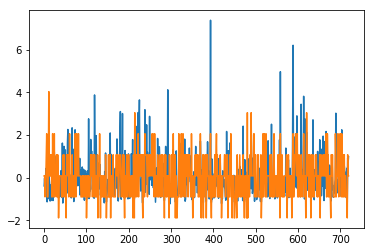

In [14]:
# house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy = house[['Rooms','Price']].copy()
std_scale = preprocessing.StandardScaler().fit(house_copy[['Price', 'Rooms']])
df_std = std_scale.transform(house[['Price', 'Rooms']]) 
df_std[0:5]

# put it alongside data... to view
house_copy['Price_scale'] = df_std[:,0] # so 'Ascaled' is Alcohol scaled
house_copy['Rooms_scale'] = df_std[:,1] # and 'MAscaled' is Malic acid scaled
house_copy.head()

%matplotlib inline
house_copy['Price_scale'].plot(), house_copy['Rooms_scale'].plot()

Min-Max nomorlization

D:\ANACONDA\lib\site-packages\sklearn\preprocessing\data.py:334: DataConversionWarning: Data with input dtype int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


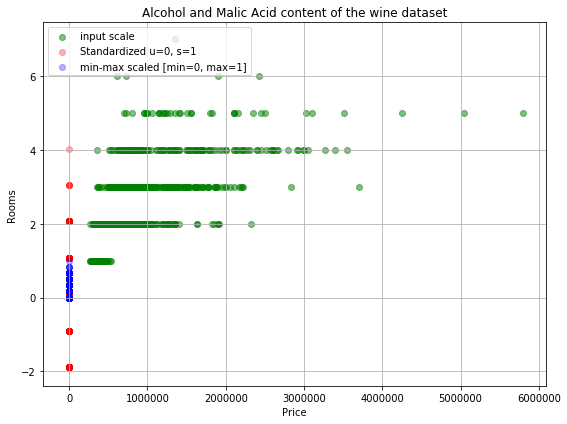

In [199]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
minmax_scale = preprocessing.MinMaxScaler().fit(house_copy[['Price', 'Rooms']])
df_minmax = minmax_scale.transform(house_copy[['Price', 'Rooms']])
df_minmax[0:5]

minA = house_copy.Price.min()
maxA = house_copy.Price.max()
minA, maxA

a = house_copy.Price[0] # the first value, for practice
#Write you code here
mma = (a - minA) / (maxA - minA)
mma

a = house_copy[house_copy.Price == house_copy.Price.max()].Price
mma = (a - minA) / (maxA - minA)
mma

# and plot
%matplotlib inline

from matplotlib import pyplot as plt

def plot():
    f = plt.figure(figsize=(8,6))

    plt.scatter(house_copy['Price'], house_copy['Rooms'],
            color='green', label='input scale', alpha=0.5)

 #   plt.scatter(df_std[:,0], df_std[:,1], color='red',
 #           label='Standardized [$$N  (\mu=0, \; \sigma=1)$$]', alpha=0.3)
    plt.scatter(df_std[:,0], df_std[:,1], color='red',
             label='Standardized u=0, s=1', alpha=0.3) # can't print: μ = 0, σ = 0
    
    plt.scatter(df_minmax[:,0], df_minmax[:,1],
            color='blue', label='min-max scaled [min=0, max=1]', alpha=0.3)

    plt.title('Alcohol and Malic Acid content of the wine dataset')
    plt.xlabel('Price')
    plt.ylabel('Rooms')
    plt.legend(loc='upper left')
    plt.grid()
    plt.tight_layout()
    #f.savefig("z_min_max.pdf", bbox_inches='tight')

plot()
plt.show()

Root transformation

In [205]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()

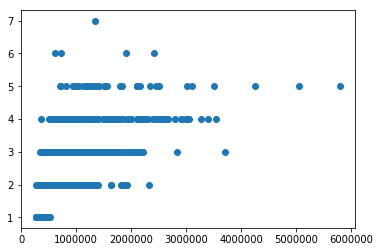

In [207]:
# Before
plt.scatter(house_copy["Price"], house_copy["Rooms"]) # before

In [208]:
import math
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.sqrt(house_copy["Price"][i])
    i += 1

In [209]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.sqrt(house_copy["Rooms"][i])
    i += 1  

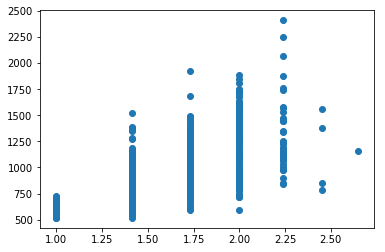

In [211]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Square power transformation

In [212]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.pow(house_copy["Price"][i],2)
    i += 1

In [213]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.pow(house_copy["Rooms"][i],2)
    i += 1

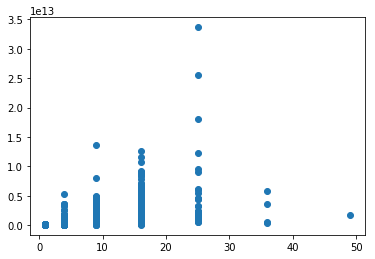

In [214]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Log transformation

In [215]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.log(house_copy["Price"][i])
    i += 1

In [216]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.log(house_copy["Rooms"][i])
    i += 1

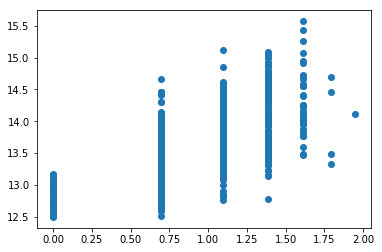

In [217]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

### crime_C_average with price

In [201]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
std_scale = preprocessing.StandardScaler().fit(house_copy[['Price', 'crime_C_average']])
df_std = std_scale.transform(house[['Price', 'crime_C_average']]) 
df_std[0:5]

# put it alongside data... to view
house_copy['Price_scale'] = df_std[:,0] # so 'Ascaled' is Alcohol scaled
house_copy['crime_C_average_scale'] = df_std[:,1] # and 'MAscaled' is Malic acid scaled
house_copy.head()

house_copy.describe() # check that μ = 0 and σ = 1... approx

,Rooms,crime_C_average,travel_min_to_CBD,Age,Price,Price_scale,crime_C_average_scale
count,685.000000,685.000000,685.000000,685.000000,6.850000e+02,6.850000e+02,6.850000e+02
mean,2.909489,457.362044,24.414015,52.456934,1.055298e+06,-1.918984e-16,5.721295e-17
std,1.014794,429.743753,13.169236,34.921089,6.462522e+05,1.000731e+00,1.000731e+00
min,1.000000,1.000000,-1.000000,2.000000,2.675000e+05,-1.219916e+00,-1.062716e+00
25%,2.000000,161.000000,16.310000,19.000000,6.270000e+05,-6.632255e-01,-6.901289e-01
50%,3.000000,338.000000,25.330000,49.000000,8.900000e+05,-2.559663e-01,-2.779546e-01
75%,4.000000,587.000000,32.000000,69.000000,1.300000e+06,3.789246e-01,3.018838e-01
max,7.000000,2042.000000,70.600000,147.000000,5.800000e+06,7.347239e+00,3.690096e+00


(<matplotlib.axes._subplots.AxesSubplot at 0x1b5a7685a58>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b5a7685a58>)

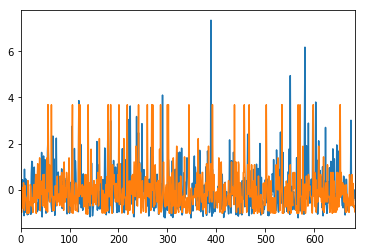

In [202]:
%matplotlib inline
house_copy['Price_scale'].plot(), house_copy['crime_C_average_scale'].plot()

Min-Max nomorlization

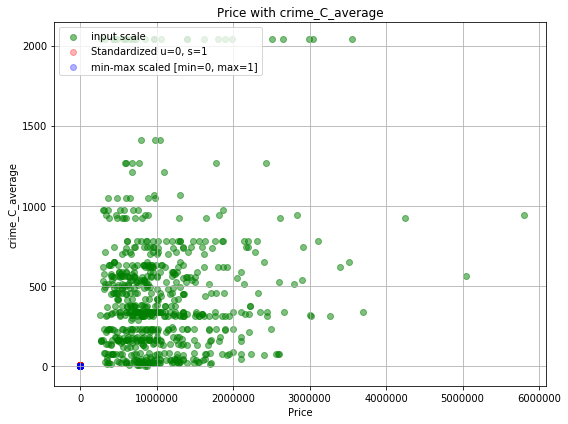

In [218]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
minmax_scale = preprocessing.MinMaxScaler().fit(house_copy[['Price', 'crime_C_average']])
df_minmax = minmax_scale.transform(house_copy[['Price', 'crime_C_average']])
df_minmax[0:5]

minA = house_copy.Price.min()
maxA = house_copy.Price.max()
minA, maxA

a = house_copy.Price[0] # the first value, for practice
#Write you code here
mma = (a - minA) / (maxA - minA)
mma

a = house_copy[house_copy.Price == house_copy.Price.max()].Price
mma = (a - minA) / (maxA - minA)
mma

# and plot
%matplotlib inline

from matplotlib import pyplot as plt

def plot():
    f = plt.figure(figsize=(8,6))

    plt.scatter(house_copy['Price'], house_copy['crime_C_average'],
            color='green', label='input scale', alpha=0.5)

 #   plt.scatter(df_std[:,0], df_std[:,1], color='red',
 #           label='Standardized [$$N  (\mu=0, \; \sigma=1)$$]', alpha=0.3)
    plt.scatter(df_std[:,0], df_std[:,1], color='red',
             label='Standardized u=0, s=1', alpha=0.3) # can't print: μ = 0, σ = 0
    
    plt.scatter(df_minmax[:,0], df_minmax[:,1],
            color='blue', label='min-max scaled [min=0, max=1]', alpha=0.3)

    plt.title('Price with crime_C_average')
    plt.xlabel('Price')
    plt.ylabel('crime_C_average')
    plt.legend(loc='upper left')
    plt.grid()
    plt.tight_layout()
    #f.savefig("z_min_max.pdf", bbox_inches='tight')

plot()
plt.show()

Root transformation

In [205]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()

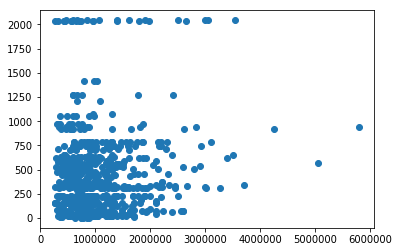

In [219]:
# Before
plt.scatter(house_copy["Price"], house_copy["crime_C_average"]) # before

In [220]:
import math
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.sqrt(house_copy["Price"][i])
    i += 1

In [221]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.sqrt(house_copy["crime_C_average"][i])
    i += 1  

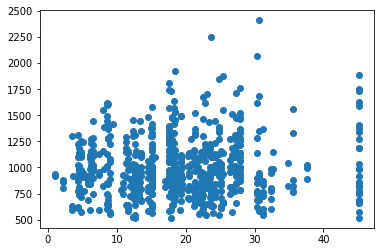

In [222]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Square power transformation

In [223]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.pow(house_copy["Price"][i],2)
    i += 1

In [224]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.pow(house_copy["crime_C_average"][i],2)
    i += 1

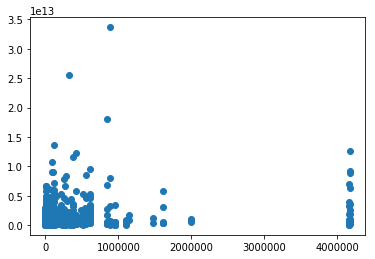

In [225]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Log transformation

In [226]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.log(house_copy["Price"][i])
    i += 1

In [227]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.log(house_copy["crime_C_average"][i])
    i += 1

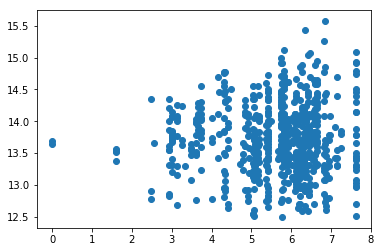

In [228]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

### travel_min_to_CBD with price

(<matplotlib.axes._subplots.AxesSubplot at 0x1b5a8421c18>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b5a8421c18>)

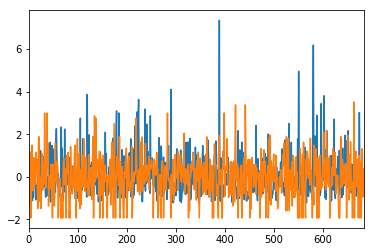

In [229]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
std_scale = preprocessing.StandardScaler().fit(house_copy[['Price', 'travel_min_to_CBD']])
df_std = std_scale.transform(house[['Price', 'travel_min_to_CBD']]) 
df_std[0:5]

# put it alongside data... to view
house_copy['Price_scale'] = df_std[:,0] # so 'Ascaled' is Alcohol scaled
house_copy['travel_min_to_CBD_scale'] = df_std[:,1] # and 'MAscaled' is Malic acid scaled
house_copy.head()

house_copy.describe() # check that μ = 0 and σ = 1... approx

%matplotlib inline
house_copy['Price_scale'].plot(), house_copy['travel_min_to_CBD_scale'].plot()

Min-Max nomorlization

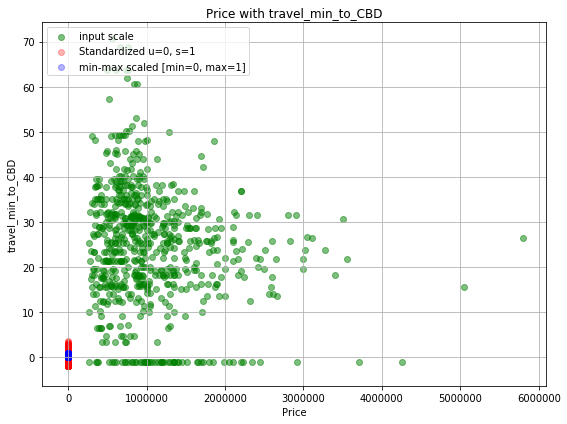

In [230]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
minmax_scale = preprocessing.MinMaxScaler().fit(house_copy[['Price', 'travel_min_to_CBD']])
df_minmax = minmax_scale.transform(house_copy[['Price', 'travel_min_to_CBD']])
df_minmax[0:5]

minA = house_copy.Price.min()
maxA = house_copy.Price.max()
minA, maxA

a = house_copy.Price[0] # the first value, for practice
#Write you code here
mma = (a - minA) / (maxA - minA)
mma

a = house_copy[house_copy.Price == house_copy.Price.max()].Price
mma = (a - minA) / (maxA - minA)
mma

# and plot
%matplotlib inline

from matplotlib import pyplot as plt

def plot():
    f = plt.figure(figsize=(8,6))

    plt.scatter(house_copy['Price'], house_copy['travel_min_to_CBD'],
            color='green', label='input scale', alpha=0.5)

 #   plt.scatter(df_std[:,0], df_std[:,1], color='red',
 #           label='Standardized [$$N  (\mu=0, \; \sigma=1)$$]', alpha=0.3)
    plt.scatter(df_std[:,0], df_std[:,1], color='red',
             label='Standardized u=0, s=1', alpha=0.3) # can't print: μ = 0, σ = 0
    
    plt.scatter(df_minmax[:,0], df_minmax[:,1],
            color='blue', label='min-max scaled [min=0, max=1]', alpha=0.3)

    plt.title('Price with travel_min_to_CBD')
    plt.xlabel('Price')
    plt.ylabel('travel_min_to_CBD')
    plt.legend(loc='upper left')
    plt.grid()
    plt.tight_layout()
    #f.savefig("z_min_max.pdf", bbox_inches='tight')

plot()
plt.show()

Root transformation

In [231]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()

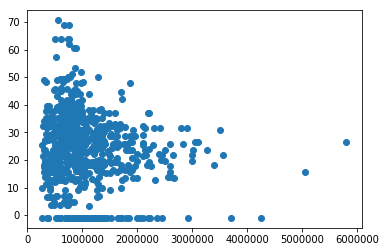

In [232]:
# Before
plt.scatter(house_copy["Price"], house_copy["travel_min_to_CBD"]) # before

In [233]:
import math
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.sqrt(house_copy["Price"][i])
    i += 1

In [247]:
house_copy['lbm'] = None
i = 0
for index,row in house_copy.iterrows():
    if (row["travel_min_to_CBD"] < 0):
        i += 1  
        continue
    else:
        house_copy['lbm'].at[i] = math.sqrt(house_copy["travel_min_to_CBD"][i])
        i += 1  

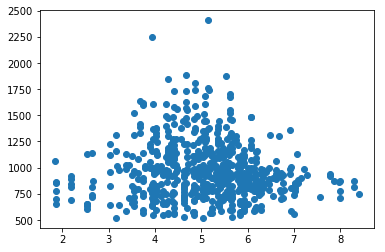

In [248]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Square power transformation

In [249]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.pow(house_copy["Price"][i],2)
    i += 1

In [250]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.pow(house_copy["travel_min_to_CBD"][i],2)
    i += 1

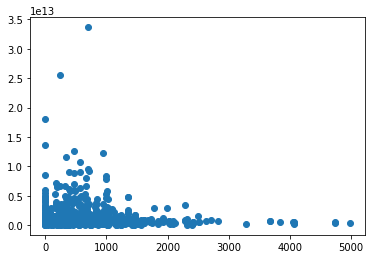

In [251]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Log transformation

In [252]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.log(house_copy["Price"][i])
    i += 1

In [254]:
house_copy['lbm'] = None
i = 0
for index,row in house_copy.iterrows():
    if (row["travel_min_to_CBD"] < 0):
        i += 1  
        continue
    else:
        house_copy['lbm'].at[i] = math.log(house_copy["travel_min_to_CBD"][i])
        i += 1  

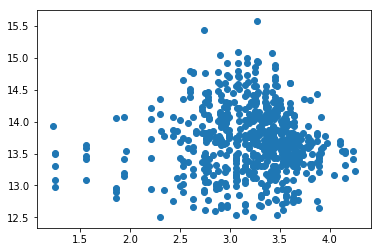

In [255]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

### Age with price

(<matplotlib.axes._subplots.AxesSubplot at 0x1b5a707bd30>,
 <matplotlib.axes._subplots.AxesSubplot at 0x1b5a707bd30>)

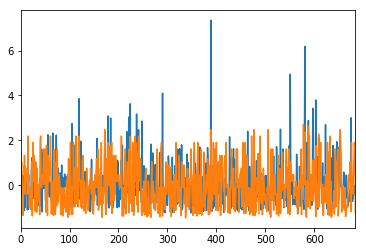

In [192]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
std_scale = preprocessing.StandardScaler().fit(house_copy[['Price', 'Age']])
df_std = std_scale.transform(house[['Price', 'Age']]) 
df_std[0:5]

# put it alongside data... to view
house_copy['Price_scale'] = df_std[:,0] # so 'Ascaled' is Alcohol scaled
house_copy['Age_scale'] = df_std[:,1] # and 'MAscaled' is Malic acid scaled
house_copy.head()

house_copy.describe() # check that μ = 0 and σ = 1... approx

%matplotlib inline
house_copy['Price_scale'].plot(), house_copy['Age_scale'].plot()

Min-Max nomorlization

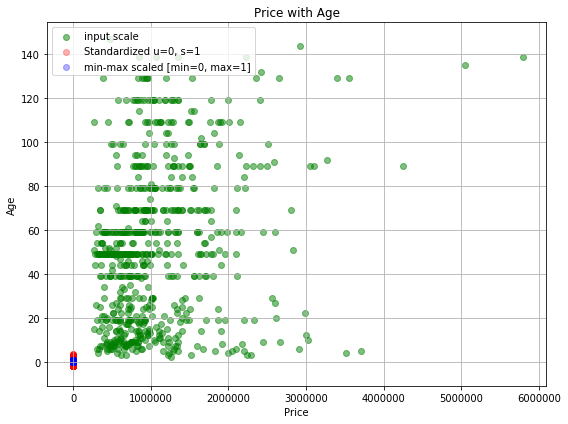

In [256]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
minmax_scale = preprocessing.MinMaxScaler().fit(house_copy[['Price', 'Age']])
df_minmax = minmax_scale.transform(house_copy[['Price', 'Age']])
df_minmax[0:5]

minA = house_copy.Price.min()
maxA = house_copy.Price.max()
minA, maxA

a = house_copy.Price[0] # the first value, for practice
#Write you code here
mma = (a - minA) / (maxA - minA)
mma

a = house_copy[house_copy.Price == house_copy.Price.max()].Price
mma = (a - minA) / (maxA - minA)
mma

# and plot
%matplotlib inline

from matplotlib import pyplot as plt

def plot():
    f = plt.figure(figsize=(8,6))

    plt.scatter(house_copy['Price'], house_copy['Age'],
            color='green', label='input scale', alpha=0.5)

 #   plt.scatter(df_std[:,0], df_std[:,1], color='red',
 #           label='Standardized [$$N  (\mu=0, \; \sigma=1)$$]', alpha=0.3)
    plt.scatter(df_std[:,0], df_std[:,1], color='red',
             label='Standardized u=0, s=1', alpha=0.3) # can't print: μ = 0, σ = 0
    
    plt.scatter(df_minmax[:,0], df_minmax[:,1],
            color='blue', label='min-max scaled [min=0, max=1]', alpha=0.3)

    plt.title('Price with Age')
    plt.xlabel('Price')
    plt.ylabel('Age')
    plt.legend(loc='upper left')
    plt.grid()
    plt.tight_layout()
    #f.savefig("z_min_max.pdf", bbox_inches='tight')

plot()
plt.show()

Root transformation

In [205]:
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()

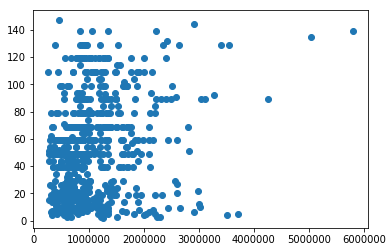

In [257]:
# Before
plt.scatter(house_copy["Price"], house_copy["Age"]) # before

In [258]:
import math
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.sqrt(house_copy["Price"][i])
    i += 1

In [259]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.sqrt(house_copy["Age"][i])
    i += 1  

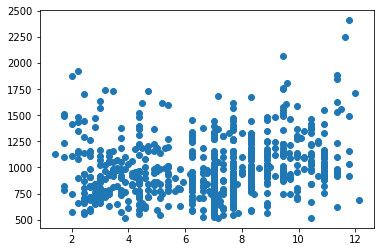

In [260]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Square power transformation

In [261]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.pow(house_copy["Price"][i],2)
    i += 1

In [262]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.pow(house_copy["Age"][i],2)
    i += 1

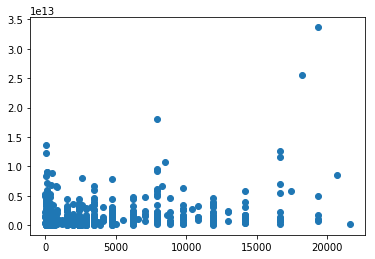

In [263]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

Log transformation

In [264]:
import math
house_copy = house[['Rooms','crime_C_average','travel_min_to_CBD','Age','Price']].copy()
house_copy['lmr'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lmr'].at[i] = math.log(house_copy["Price"][i])
    i += 1

In [265]:
house_copy['lbm'] = None
i = 0
for row in house_copy.iterrows():
    house_copy['lbm'].at[i] = math.log(house_copy["Age"][i])
    i += 1

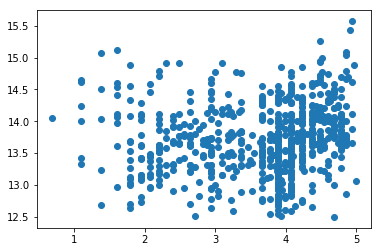

In [266]:
plt.scatter(house_copy.lbm, house_copy.lmr) # and after

In [ ]:
from sklearn.cross_validation import train_test_split
from sklearn.linear_model import LinearRegression
def buildModel(attribute):
    
    X = house[attribute]
    y = house['Price']


    X_train,X_test, y_train, y_test = train_test_split(X, y, random_state=111)

    linreg = LinearRegression()
    linreg.fit(X_train, y_train)

    print (attribute + ': r-squared for this model = '+ str(linreg.score(X_test,y_test)))